# 09_BUILD_Library2

<a target="_blank" href="https://colab.research.google.com/github/hiyama341/ConStrain/blob/main/colab_notebooks/09_BUILD_Library2.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

In [28]:
%%capture
!pip install pydna
!pip install pandas
!pip install --upgrade xlrd
!pip install constrain

In [29]:
import IPython.core.display
import pathlib
import itertools
import numpy as np
import pandas as pd
import copy
import pydna
import pydna.editor
import pydna.primer
import pydna.dseqrecord
import pydna.amplify
import pydna.assembly
import pydna.gel
import pydna.ladders
from pydna.dseqrecord import Dseqrecord

In [30]:
!git clone https://github.com/hiyama341/ConStrain_on_google_colab.git

fatal: destination path 'ConStrain_on_google_colab' already exists and is not an empty directory.


# 1. Debottlenecking the strictosidine module

## 1.1 Hypothesis
1. Specific combinations of CPR / G8H homologs and corresponding expression levels can remove the G8H bottleneck in the Strictosidine pathway

### 1.1.1 Aim: To test the hypothesis through library design

Tasks
1. analyse seq data from first library construction
2. **2nd Library**
    - investigate parts already in the lab
    - create parts missing
    - pool together parts
    - transformation
4. Phenotyping
5. Data analysis

## 1.2 Intro

The purpose of this notebook is to create a smaller library based on a machine learning prediction of the highest producing combination of genes from combinations seen in the figure below. 

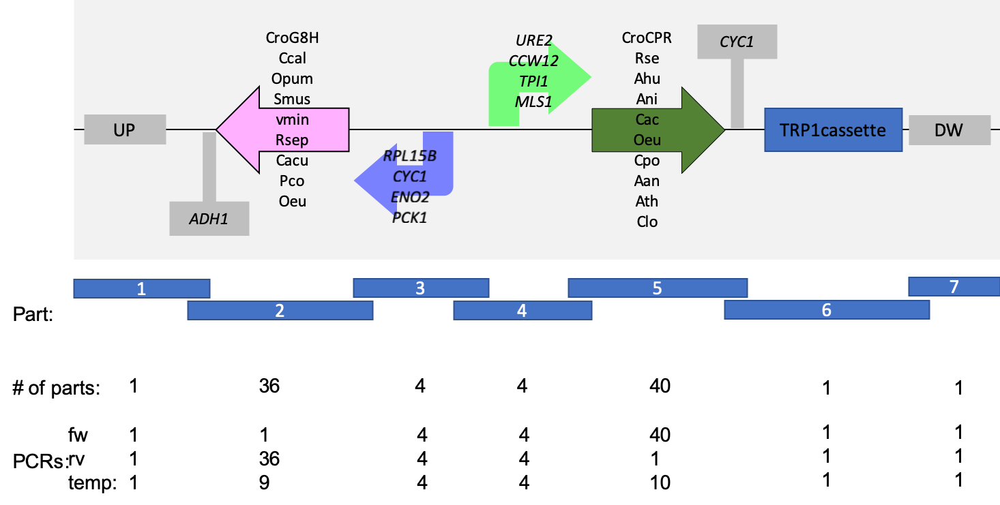

In [31]:
IPython.core.display.Image('ConStrain_on_google_colab/pictures/library_design_1.png', width=600)

The figure above illustrates the original library design. Note that G8H Pco
was not available, lowering G8H parts to 8. 

Note on sequence homology: 
- As G8H and CPR parts have homology this library cannot be made in one-pot transformation. Instead it is made in 9*10 individual transformation to not add two G8H or CPR homologs in one transformation mixtures.

Machine learning pred:
- In the following, the machine learning outcome can be found. It was found that 140 strains (5 * 2 * 2 * 7) was suitable for the pupose.
- From the predictions, the following genes have been selected: 
    - Smus, Vmin, Cro, Rsep, Oeu
    - pCYC1, pENO2
    - Clo, Ara, Rse, Aan, Cro, Ani, Ahu
    - pTPI1, pCCW12

Experiment:
- To perform this experiment, a total of 35 (5*7) transformation should be performed 
- To perform this, each gene has several different overhangs and these are pooled together. All promoters are also pooled together. UP, DW and cTRP1 is pooled together. Then the correct mixes should be performed. 

The previous experiments were simulated in 05-SDP-AllLibraries, and the next step in the process was investigation of the machine learning outcome.

# 2. Experiment prep

To facilitate CRISPR/Cas9 transformation we need the following: 
- Plasmids to be purified:
    - gRNA plasmid
- Strains to use:
    - MIA-HA1 strains

### 2.1 Background strain for insertion

In [32]:
from Bio import SeqIO

HA1 = SeqIO.read("ConStrain_on_google_colab/Data/Strain_sequences/HA1.gb", "gb")
HA1.annotations['topology'] = "linear"

A new stock is made from the base Y1A1 (MIA-HA-1b) -> YPD media with 200 ul cell stock. (the same strains used in 05-SDP-AllLibraries)
The cells were plated on YPD before preparing precultures. 

For the third transformation I made a new stock of MIA-HA-1b 14/09

### 2.2 Plasmid with gRNA: 
- pESC-URA-gRNA_XI2-2


- From LabCollecter the location of the E.coli strain with the plasmid can be found. (Here I found it in the document Jie_DNA_Inventory@CFB)
    - LAB collection ID: 9652, box: BD, pos: B7
    
    
- A new stock must be made. 
    - Grow in LB+amp (4x5ml) (here in yeast trp + amp)
    - make miniprep
    
    - Perforned twice. 

In [33]:
from constrain.lims.csv_database import get_dna_from_plate_name

In [34]:
pgRNA = get_dna_from_plate_name('pCfB-56(pESC-LEU-gRNA_ATF1-CroCPR).fasta', 'plasmid_plates', database_path = 'ConStrain_on_google_colab/Data/csv_database/')
pgRNA.name = "pESC-URA-gRNA_XI2-2"
pgRNA

SeqRecord(seq=Seq('TGGCGGGTGTCGGGGCTGGCTTAACTATGCGGCATCAGAGCAGATTGTACTGAG...TGT'), id='10004.0', name='pESC-URA-gRNA_XI2-2', description='seq_AA4vOQs1 <unknown description>', dbxrefs=[])

In [35]:
##Extract gRNA information and save the cut sequence
XI2_2_gRNA = pydna.dseqrecord.Dseqrecord("ACCCCCCTCAACTGATCAAC", name = "XI2-2_gRNA")
pgRNA.annotations['batches']

[{'location': 'plasmid_plates_0_A5', 'volume': 134.0, 'concentration': 103.0}]

### 2.3 Control plasmids

In [36]:
#2. import plasmids need for controls
path = 'ConStrain_on_google_colab/Data/csv_database/'
genbank_path = 'ConStrain_on_google_colab/Data/genbank_files/'

#2. import plasmids need for controls - TRP
TRP_plasmid = get_dna_from_plate_name('pRS414.gb', 'plasmid_plates', database_path = path, genbank = True, genbank_files_path =genbank_path )
TRP_plasmid.name = 'pL_01_C2_(pRS414-TRP)'

### URA
URA_plasmid = get_dna_from_plate_name('pRS416.gb', 'plasmid_plates', database_path = path, genbank = True, genbank_files_path =genbank_path )
URA_plasmid.name = 'pL_01_C4_(pRS416-URA)'

### 2.4 Tempaltes for part creation

In [37]:
G8H_template_names = ['CcalG8H_tADH1',
                     'CroG8H_tADH1',
                     'OpumG8H_tADH1',
                     'CacuG8H_tADH1',
                     'RsepG8H_tADH1',
                     'SmusG8H_tADH1',
                     'VminG8H_tADH1',
                     'OeuG8H_tADH1']

pG8H_template_names = ['pCYC1','pENO2','pPCK1','pRPL15B']

CPR_template_names = ["CroCPR_tCYC1",
                      "AanCPR_tCYC1",
                      "AthATR1_tCYC1",
                      "CloCPR_tCYC1",
                      "RseCPR_tCYC1",
                      "AhuCPR_tCYC1",
                      "AniCPR_tCYC1",
                      "CacCPR_tCYC1",
                      "OeuCPR_tCYC1",
                      "CpoCPR_tCYC1"]

pCPR_template_names = ['pCCW12','pMLS1','pTPI1','pURE2']

### 2.5 Importing sequences

In [38]:
from constrain.lims.csv_database import get_dna_from_box_name

In [39]:
path = 'ConStrain_on_google_colab/Data/csv_database/'
genbank_path = 'ConStrain_on_google_colab/Data/genbank_files/'

# Up and DW and Marker
UP_sites = [get_dna_from_box_name('UP_XI-2', 'ds_dna_box', database_path = path)]
DW_sites = [get_dna_from_box_name('DW_XI-2', 'ds_dna_box', database_path = path)]
marker_sites = [get_dna_from_box_name('seq_3HMRtcpy', 'ds_dna_box', database_path = path)]

# We can loop through the database to find our sequences - these sequence we need to 
G8H_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path =genbank_path ) for name in G8H_template_names]  
CPR_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path =genbank_path) for name in CPR_template_names]  


pG8H_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path,genbank = True, genbank_files_path = genbank_path) for name in pG8H_template_names]  
pCPR_sites1 =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path = genbank_path) for name in pCPR_template_names]  


In [41]:
pCPR_sites1

[SeqRecord(seq=Seq('AAAGAAACTTAATACGTTATGCCGTAATGAAGGGCTACCAAAAACGATAATCTC...ATA'), id='10037', name='pCCW12', description='', dbxrefs=[]),
 SeqRecord(seq=Seq('TTTAATCTTTAGGGAGGGTAAAGTTGGATTCATCAATTTGATGAAATCCGTGTA...AAA'), id='10038', name='pMLS1', description='', dbxrefs=[]),
 SeqRecord(seq=Seq('AAGGATGAGCCAAGAATAAGGGAACAAGATTTTGGTAATTTCCAAAAAATCAAT...AAA'), id='10039', name='pTPI1', description='', dbxrefs=[]),
 SeqRecord(seq=Seq('CAAGCTGAACTCGCTGAAATTGAAAGAAAACTGGCAGAATCGTCTTCTGAAGAC...CAA'), id='10040', name='pURE2', description='', dbxrefs=[])]

# 3. Targeted library




From the notebook [08_2_DESIGN_TargetedLibrary](08_2_DESIGN_TargetedLibrary.ipynb) we got 140 combinations from 20 predictions as seen below:



G8H:  ['Rsep', 'Smus', 'Oeu', 'Vmin', 'Cro']

pG8H: ['ENO2', 'CYC1']

pCPR: ['TPI1', 'CCW12']

CPR:  ['Clo', 'Ara', 'Rse', 'Aan', 'Cro', 'Ani', 'Ahu']


Number of combinations: 5 x 2 x 2 x 7 =  140


In [42]:
#Provide annotations and names for parts. 
G8H_CDS_annotations = ["OeuG8O",
                       "CroG8O",
                       "Rsep_G8O_opt",
                       "Vmin_G8O_opt",
                       "Smus_G8O_opt"]

G8H_site_names = ["OeuG8H_tADH1", 
                  "CroG8H_tADH1",
                  "RsepG8H_tADH1", 
                  "VminG8H_tADH1", 
                  "SmusG8H_tADH1"]

pG8H_annotations = ['pCYC1','pENO2']
pG8H_names = ['pCYC1','pENO2']

pCPR_annotations = ['pCCW12','pTPI1']
pCPR_names = ['pCCW12','pTPI1']

CPR_CDS_annotations = ['Cro CPR',
                       'Aan CPR',
                       'ATR1 Arabidopsis CPR',
                       'CloCPR_opt2','RseCPR_opt2',
                       'AhuCPR_opt2','AniCPR_opt2']

CPR_site_names = ['CroCPR_tCYC1',
                  'AanCPR_tCYC1',
                  'AraCPR_tCYC1',
                  'CloCPR_tCYC1',
                  'RseCPR_tCYC1',
                  'AhuCPR_tCYC1',
                  'AniCPR_tCYC1']


marker_cassette_annotations = ["TRP1_marker"]
marker_cassette_names = ["cTRP1"]

In [43]:
CPR_sites[2].name = 'AraCPR_tCYC1'

In [44]:
# Lets import some ConStrain function to help with the construction of the combinatorial library
from constrain.design.cloning import extract_template_amplification_sites, extract_sites, multiply_list, remove_tuple_duplicates, seq_to_annotation,plate_plot , casembler

In [45]:
pCPR_sites1

[SeqRecord(seq=Seq('AAAGAAACTTAATACGTTATGCCGTAATGAAGGGCTACCAAAAACGATAATCTC...ATA'), id='10037', name='pCCW12', description='', dbxrefs=[]),
 SeqRecord(seq=Seq('TTTAATCTTTAGGGAGGGTAAAGTTGGATTCATCAATTTGATGAAATCCGTGTA...AAA'), id='10038', name='pMLS1', description='', dbxrefs=[]),
 SeqRecord(seq=Seq('AAGGATGAGCCAAGAATAAGGGAACAAGATTTTGGTAATTTCCAAAAAATCAAT...AAA'), id='10039', name='pTPI1', description='', dbxrefs=[]),
 SeqRecord(seq=Seq('CAAGCTGAACTCGCTGAAATTGAAAGAAAACTGGCAGAATCGTCTTCTGAAGAC...CAA'), id='10040', name='pURE2', description='', dbxrefs=[])]

In [46]:
pCPR_sites_PROM1 = pCPR_sites1[0]
pCPR_sites_PROM2 = pCPR_sites1[2]
pCPR_sites2 = [pCPR_sites_PROM1 , pCPR_sites_PROM2]

pCPR_sites2

[SeqRecord(seq=Seq('AAAGAAACTTAATACGTTATGCCGTAATGAAGGGCTACCAAAAACGATAATCTC...ATA'), id='10037', name='pCCW12', description='', dbxrefs=[]),
 SeqRecord(seq=Seq('AAGGATGAGCCAAGAATAAGGGAACAAGATTTTGGTAATTTCCAAAAAATCAAT...AAA'), id='10039', name='pTPI1', description='', dbxrefs=[])]

In [47]:
from Bio.Seq import Seq
# promoters
pG8H_sites = extract_sites(pG8H_annotations, pG8H_sites, pG8H_names)
pCPR_sites = extract_sites(pCPR_annotations, pCPR_sites2, pCPR_names)

In [48]:
pCPR_sites

[SeqRecord(seq=Seq('AAAGAAACTTAATACGTTATGCCGTAATGAAGGGCTACCAAAAACGATAATCTC...ATA'), id='10037', name='pCCW12', description='', dbxrefs=[]),
 SeqRecord(seq=Seq('AAGGATGAGCCAAGAATAAGGGAACAAGATTTTGGTAATTTCCAAAAAATCAAT...AAA'), id='10039', name='pTPI1', description='', dbxrefs=[])]

In [49]:
# Reverse complementing the promoters
pG8H_sites = [site.reverse_complement(annotations=True,name=True, id= True) for site in pG8H_sites]
pG8H_sites

[SeqRecord(seq=Seq('TATTAATTTAGTGTGTGTATTTGTGTTTGTGTGTCTATAGAAGTATAGTAATTT...CTG'), id='10033', name='pCYC1', description='<unknown description>', dbxrefs=[]),
 SeqRecord(seq=Seq('TATTATTGTATGTTATAGTATTAGTTGCTTGGTGTTATGAAAGAAACTAAGAAA...ATT'), id='10034', name='pENO2', description='<unknown description>', dbxrefs=[])]

In [50]:
# Extracting cpr_sites
CPR_site_1 = []

for enzyme in CPR_sites: 
    if str(enzyme.name) in CPR_site_names: 
        CPR_site_1.append(enzyme)

len(CPR_site_1)

7

In [51]:
# Extracting G8H_sites
G8H_site_1 = []

for enzyme in G8H_sites: 
    if str(enzyme.name) in G8H_site_names: 
        G8H_site_1.append(enzyme)

len(G8H_site_1)

5

In [52]:
from constrain.design.cloning import multiply_list

In [53]:
#Create a list of fragments within a list of parts.
fragment_list = [UP_sites,G8H_site_1,pG8H_sites,pCPR_sites1,CPR_site_1,marker_sites,DW_sites]

#The number of fragments to be assembled
no_frags = len(fragment_list)
print("Number of fragments:", no_frags)

#The number of parts of each fragment
no_parts = [len(l) for l in fragment_list]
print("Number of parts: ",no_parts)

#The number of possible combinations
no_combs = multiply_list(no_parts)
print("Number of possible combinations:",no_combs)

#How many repitions are needed?
repetition_list = [int(no_comb/no_part) for no_comb, no_part in zip([no_combs]*len(no_parts),no_parts)]
print("The number of time each fragment must be repeated:", repetition_list)

#Matrix with all combinations
combinations_matrix = [t for t in itertools.product(*fragment_list)]
for row in combinations_matrix:
    names = []
    for element in row:
        names.append(element.name)
    print(names)

Number of fragments: 7
Number of parts:  [1, 5, 2, 4, 7, 1, 1]
Number of possible combinations: 280
The number of time each fragment must be repeated: [280, 56, 140, 70, 40, 280, 280]
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pCCW12', 'CroCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pCCW12', 'AanCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pCCW12', 'AraCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pCCW12', 'CloCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pCCW12', 'RseCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pCCW12', 'AhuCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pCCW12', 'AniCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pMLS1', 'CroCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'CroG8H_tADH1', 'pCYC1', 'pMLS1', 'AanCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-

Fragments have been amplified in a previous part of this project (but performed by me), and the amount remaining must be checked. 


## 3.1 Information about parts from previous experiments


In [27]:
#Read files with primer and parts information
lea_primers = pd.read_excel("ConStrain_on_google_colab/Data/raw/G8H_CPR_library.xls", sheet_name = "all primers").reset_index(drop=True)
lea_parts = pd.read_excel("ConStrain_on_google_colab/Data/raw/G8H_CPR_library.xls", sheet_name = "all parts").reset_index(drop=True)

In [53]:
#Initialize matrix
primer_matrix = [[] for i in range(no_combs)]
for comb_no in range(0, no_combs):
    for frag_no in range(0, no_frags):
        comb_seq = str(combinations_matrix[comb_no][frag_no].seq.upper())
        
        #for G8H and CPR genes position are changed to promoters. 
        if frag_no == 1:
            idx = frag_no + 1
        elif frag_no == 4:
            idx = frag_no - 1
        else:
            idx  = frag_no
        
        
        #Find the row that matches the part
        #If the frag is G8H or CPR, save pName and find the part that overlaps to this promoter.
        if idx != frag_no:
            name = combinations_matrix[comb_no][idx].name
            true_false = np.logical_and(lea_parts['Sequence'].str.contains(comb_seq), lea_parts['Overlaps_to'] == name)
        #Find the row that mathces the sequence 
        else:
            true_false = lea_parts['Sequence'].str.contains(comb_seq)
        comb_seq_idx = lea_parts[true_false].index

        
        #Save forward primer information
        forward_primer_name = lea_parts.loc[comb_seq_idx,['Forward Oligo Name']].values[0][0]
        forward_primer_idx = lea_primers[lea_primers['Name'] == forward_primer_name].index
        forward_seq = lea_primers.loc[forward_primer_idx,['Sequence']].values[0][0]
        if forward_primer_name == 'PR_G8H_01':
            forward_loc = 'o3_F07'
        else:
            forward_loc = lea_primers.loc[forward_primer_idx,['Location']].values[0][0]
        forward_primer = pydna.primer.Primer(pydna.dseqrecord.Dseqrecord(forward_seq, id = forward_primer_name))
        forward_primer.annotations['batches'] = []
        forward_primer.annotations['batches'].append({'location': forward_loc, 'volume': 100, 'concentration': 10})
        
        #Save reverse primer information
        reverse_primer_name = lea_parts.loc[comb_seq_idx,['Reverse Oligo Name']].values[0][0]
        reverse_primer_idx  = lea_primers[lea_primers['Name'] == reverse_primer_name].index
        reverse_seq = lea_primers.loc[reverse_primer_idx,['Sequence']].values[0][0]
        if reverse_primer_name == 'PR_G8H_01':
            forward_loc = 'o3_F07'
        else:
            reverse_loc = lea_primers.loc[reverse_primer_idx,['Location']].values[0][0]
        reverse_primer = pydna.primer.Primer(pydna.dseqrecord.Dseqrecord(reverse_seq, id = reverse_primer_name))
        reverse_primer.annotations['batches'] = []
        reverse_primer.annotations['batches'].append({'location': reverse_loc, 'volume': 100,  'concentration': 10})
        
        #Save to primer matrix 
        primer_matrix[comb_no].append((forward_primer, reverse_primer))

In [54]:
from constrain.design.cloning import seq_to_annotation, recs_no_duplicates

In [55]:
#Initizalise
amplicon_matrix = [[] for i in range(no_combs)]

#Create a matrix with relevant parts
for comb_no in range(0, no_combs):
    for frag_no in range(0, no_frags):
        #Extract sequences
        template       = pydna.dseqrecord.Dseqrecord(combinations_matrix[comb_no][frag_no])
        forward_primer = primer_matrix[comb_no][frag_no][0]
        reverse_primer = primer_matrix[comb_no][frag_no][1]
        
        #amplify the part and annotate
        amplicon = pydna.amplify.pcr(forward_primer, reverse_primer,  template)
        amplicon.annotations['template_name'] = template.name

        #Check the sequence in the sheet and get position
        comb_seq     = amplicon.seq.watson.upper()
        true_false   = lea_parts['Sequence'].str.contains(comb_seq)
        comb_seq_idx = lea_parts[true_false].index
        
        #Extract relevant information
        amplicon_name = lea_parts.loc[comb_seq_idx,['Name']].values[0][0]
        amplicon.name = amplicon_name
        amplicon_loc  = lea_parts.loc[comb_seq_idx,['Location']].values[0][0]
        amplicon_vol  = lea_parts.loc[comb_seq_idx,['volume']].values[0][0]
        amplicon_con  = lea_parts.loc[comb_seq_idx,['concentration']].values[0][0]
        amplicon.annotations['batches'] = []
        amplicon.annotations['batches'].append(  {'location'      : amplicon_loc,
                                                  'volume'        : amplicon_vol,
                                                  'concentration' : amplicon_con})
        amplicon.forward_primer.annotations['tm Q5 Hot Start'] = lea_parts.loc[comb_seq_idx,['Q5_fw_tm']].values[0][0]
        amplicon.reverse_primer.annotations['tm Q5 Hot Start'] = lea_parts.loc[comb_seq_idx,['Q5_rv_tm']].values[0][0]
        amplicon.annotations['ta Q5 Hot Start'] = lea_parts.loc[comb_seq_idx,['Q5_ta']].values[0][0]
        primary_temp_name = lea_parts.loc[comb_seq_idx, ['Primary Template Name']].values[0][0]
        promoter = lea_parts.loc[comb_seq_idx, ['Promoter']].values[0][0]
        part = lea_parts.loc[comb_seq_idx, ['Part']].values[0][0]
        if pd.isna(promoter) and pd.isna(part):
            amplicon.part_name = primary_temp_name
        elif pd.isna(promoter):
            amplicon.part_name = part
        elif pd.isna(part):
            amplicon.part_name = promoter

        ## Remove additional wrong primer annotation added by pydna.amplify.pcr
        amplicon.features = [feat for feat in amplicon.features if feat.type != "primer_bind"]
        
        #Add sequence of PCR product and primers to relevant parts
        seq_to_annotation(amplicon, amplicon, "PCR_product")
        seq_to_annotation(forward_primer, amplicon, "primer_bind")
        seq_to_annotation(reverse_primer, amplicon, "primer_bind")
        
        #Append to matrix
        amplicon_matrix[comb_no].append(amplicon)




In [56]:
#Create a matrix with lists of fragments and remove dublicates
amplicon_matrix_reshaped = [list(x) for x in zip(*amplicon_matrix)]
amplicon_matrix_reshaped_no_duplicates = [recs_no_duplicates(lst) for lst in amplicon_matrix_reshaped]

In [57]:
print("Fragments needed for the experiment:")
print("Name", '\t\t', "Part name", '\t', "location")
for frag_list_no, frag_list in enumerate(amplicon_matrix_reshaped_no_duplicates):
    print("All parts for fragment no: " + str(frag_list_no+1))
    for frag in frag_list:
        print(frag.name, '\t', frag.part_name, '\t', frag.annotations['batches'][0]['location'])
    print()


Fragments needed for the experiment:
Name 		 Part name 	 location
All parts for fragment no: 1
PCR_UP_tADH1_01 	 XI-2_UP 	 l5_I08

All parts for fragment no: 2
PCR_G8H_21 	 CroG8H_tADH1 	 l5_C05
PCR_G8H_22 	 CroG8H_tADH1 	 l5_C06
PCR_G8H_09 	 RsepG8H_tADH1 	 l5_B02
PCR_G8H_10 	 RsepG8H_tADH1 	 l5_B03
PCR_G8H_05 	 SmusG8H_tADH1 	 l5_A07
PCR_G8H_06 	 SmusG8H_tADH1 	 l5_A08
PCR_G8H_01 	 VminG8H_tADH1 	 l5_A03
PCR_G8H_02 	 VminG8H_tADH1 	 l5_A04
PCR_G8H_29 	 OeuG8H_tADH1 	 l5_D04
PCR_G8H_30 	 OeuG8H_tADH1 	 l5_D05

All parts for fragment no: 3
PCR_PRO_01 	 pCYC1 	 l4_C07
PCR_PRO_06 	 pENO2 	 l4_D03

All parts for fragment no: 4
PCR_PRO_02 	 pCCW12 	 l4_C08
PCR_PRO_03 	 pMLS1 	 l4_C09
PCR_PRO_04 	 pTPI1 	 l4_D01
PCR_PRO_05 	 pURE2 	 l4_D02

All parts for fragment no: 5
PCR_CPR_31 	 CroCPR_tCYC1 	 l5_E06
PCR_CPR_40 	 AanCPR_tCYC1 	 l5_F01
PCR_CPR_33 	 AthATR1_tCYC1 	 l5_F05
PCR_CPR_39 	 CloCPR_tCYC1 	 l5_F09
PCR_CPR_32 	 RseCPR_tCYC1 	 l5_G04
PCR_CPR_36 	 AhuCPR_tCYC1 	 l5_G08
PCR_CPR_37 	 A

The genes should be represented in dublicates, as they each have an overlap to a promoter. To easen the transformation, the two gene parts are pooled together. The same goes for the promoters, and UP, DW and cTRP1. 

In [58]:
amplicons = [item for sublist in amplicon_matrix_reshaped_no_duplicates for item in sublist]
print("Number of parts to be used:", len(amplicons))

Number of parts to be used: 47


# 4. Create new parts
Since there are some leftovers of parts, their volume were check. 
There were parts I made previously (single) and there were parts of genes that had been pooled (Sørens) 
I used as many of the single parts, because Sørens also containrf overhangs from two other promoters that were not used here. To save time, those were the single ones are missing, Sørens was used. 

Refer to section [Test amounts needed vs what is available](#Test_amounts_needed_vs_what_is_available)

As the second round of transfomration failed, more parts were needed, and the ampliciation of these are refered to as parts for the third transfomration. 

## 4.1 Parts missing: 
- L4_C8
- L4_D1
- PCR_CPR_33
- PCR_CPR_13

XI-2_UP
XI-2_DW
TRP
gRNA
CroCPR
AraCPR
AhuCPR

In [59]:
for i in range(len(amplicons)): 
    print(amplicons[i].name)

PCR_UP_tADH1_01
PCR_G8H_21
PCR_G8H_22
PCR_G8H_09
PCR_G8H_10
PCR_G8H_05
PCR_G8H_06
PCR_G8H_01
PCR_G8H_02
PCR_G8H_29
PCR_G8H_30
PCR_PRO_01
PCR_PRO_06
PCR_PRO_02
PCR_PRO_03
PCR_PRO_04
PCR_PRO_05
PCR_CPR_31
PCR_CPR_40
PCR_CPR_33
PCR_CPR_39
PCR_CPR_32
PCR_CPR_36
PCR_CPR_37
PCR_CPR_21
PCR_CPR_30
PCR_CPR_23
PCR_CPR_29
PCR_CPR_22
PCR_CPR_26
PCR_CPR_27
PCR_CPR_11
PCR_CPR_20
PCR_CPR_13
PCR_CPR_19
PCR_CPR_12
PCR_CPR_16
PCR_CPR_17
PCR_CPR_01
PCR_CPR_10
PCR_CPR_03
PCR_CPR_09
PCR_CPR_02
PCR_CPR_06
PCR_CPR_07
PCR_TRP1-DW_01
PCR_TRP1-DW_02


o3_F07: PR_G8H_01
GAGCGACCTCATGCTATAC




o3_F08: PR_CPR_02
TTCTCAAGCAAGGTTTTCAG

In [60]:
from constrain.lab.PCR import amplicon_by_name

In [61]:
parts_missing = [amplicon_by_name('PCR_CPR_33', amplicons), amplicon_by_name('PCR_CPR_13', amplicons), amplicon_by_name('PCR_PRO_02', amplicons), amplicon_by_name('PCR_PRO_04', amplicons)]
for part in parts_missing:
    print(part.name, part.annotations)

PCR_CPR_33 {'molecule_type': 'DNA', 'template_name': 'AraCPR_tCYC1', 'batches': [{'location': 'l5_F05', 'volume': 100.0, 'concentration': 20.0}], 'ta Q5 Hot Start': 61}
PCR_CPR_13 {'molecule_type': 'DNA', 'template_name': 'AraCPR_tCYC1', 'batches': [{'location': 'l5_F03', 'volume': 100.0, 'concentration': 10.0}], 'ta Q5 Hot Start': 61}
PCR_PRO_02 {'molecule_type': 'DNA', 'template_name': 'pCCW12', 'batches': [{'location': 'l4_C08', 'volume': 100.0, 'concentration': 100.0}], 'ta Q5 Hot Start': 61}
PCR_PRO_04 {'molecule_type': 'DNA', 'template_name': 'pTPI1', 'batches': [{'location': 'l4_D01', 'volume': 100.0, 'concentration': 90.0}], 'ta Q5 Hot Start': 58}


PCR from previous:
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Create according to protocol
- Elongation time: 1.5 min (30 s/ kb)
- Annealing temp 58
    - All primers are designed to have 3' Tm 59C-54C, and Ta 59C-62C when using  Q5 2x MasterMix (calculated with NEB Tm calculator)

In [62]:
from constrain.lab.PCR import det_proc_speed, det_elon_time, simple_PCR_program

In [63]:
pol = 'Q5 Hot Start'
for amplicon in amplicons:
    amplicon.annotations['polymerase'] = pol
    amplicon = det_proc_speed(amplicon)
    amplicon = det_elon_time(amplicon)
    amplicon.template.annotations['batches'] = [{'location'    :'o5',
                                 'volume'       : 100,
                                 'concentration': 100}]

In [64]:
#Find the length of the longest amplicon to determine the PCR time
longest_amplicon = 0
for amp in parts_missing:
    if len(amp) > longest_amplicon: longest_amplicon = len(amp)
print("Length of longest amplicon: \t" + str(longest_amplicon) + " bp")
print("Elongation time: \t\t"  + str(round(longest_amplicon/1000 * 35,1))+ " seconds")

Length of longest amplicon: 	2298 bp
Elongation time: 		80.4 seconds


In [65]:
plate_locations = []
for amplicon in parts_missing:
    plate_locations.append([amplicon.name, 
                            amplicon.annotations['batches'][0]['location'],
                            amplicon.annotations['template_name'],
                            amplicon.template.annotations['batches'][0]['location'],
                            amplicon.forward_primer.id,
                            amplicon.forward_primer.annotations['batches'][0]['location'],
                            amplicon.reverse_primer.id,
                            amplicon.reverse_primer.annotations['batches'][0]['location']
                           ])
amplicon_e_df = pd.DataFrame(plate_locations, columns=['name', 'location','template_name','template_location','fw_name','fw_location','rv_name','rv_location'])
amplicon_e_df = amplicon_e_df.set_index('name')
amplicon_e_df

,location,template_name,template_location,fw_name,fw_location,rv_name,rv_location
name,,,,,,,
PCR_CPR_33,l5_F05,AraCPR_tCYC1,o5,PR_CPR_32,op4_H03,PR_CPR_02,op4_B10
PCR_CPR_13,l5_F03,AraCPR_tCYC1,o5,PR_CPR_14,op4_F03,PR_CPR_02,op4_B10
PCR_PRO_02,l4_C08,pCCW12,o5,PR_PRO_03,op4_B11,PR_PRO_04,op4_B12
PCR_PRO_04,l4_D01,pTPI1,o5,PR_PRO_07,op4_D11,PR_PRO_08,op4_D12


In [66]:
pcr_volumes(vol_p_reac = 50, 
        no_of_reactions = 9,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_9_reac
Template,1.0,9.0
Primer 1,2.5,22.5
Primer 2,2.5,22.5
H20,19.0,171.0
Pol,25.0,225.0
Total,50.0,450.0


In [67]:
for part in parts_missing:
    print("PCR program for", part.name)
    l = simple_PCR_program(part)
    print(l)

PCR program for PCR_CPR_33
|98°C|98°C               |    |tmf:73.0
|____|_____          72°C|72°C|tmr:60.0
|30 s|10s  \ 61.0°C _____|____|30s/kb
|    |      \______/ 1: 9|2min|GC 41.7%
|    |       20s         |    |2298bp

PCR program for PCR_CPR_13
|98°C|98°C               |    |tmf:71.0
|____|_____          72°C|72°C|tmr:60.0
|30 s|10s  \ 61.0°C _____|____|30s/kb
|    |      \______/ 1: 9|2min|GC 41.6%
|    |       20s         |    |2298bp

PCR program for PCR_PRO_02
|98°C|98°C               |    |tmf:80.0
|____|_____          72°C|72°C|tmr:63.0
|30 s|10s  \ 64.0°C _____|____|30s/kb
|    |      \______/ 0:31|2min|GC 44.6%
|    |       20s         |    |1023bp

PCR program for PCR_PRO_04
|98°C|98°C               |    |tmf:81.0
|____|_____          72°C|72°C|tmr:61.0
|30 s|10s  \ 62.0°C _____|____|30s/kb
|    |      \______/ 0:32|2min|GC 38.4%
|    |       20s         |    |1043bp



PCR_CPR_33
PCR_CPR_13
PCR_PRO_02
PCR_PRO_04


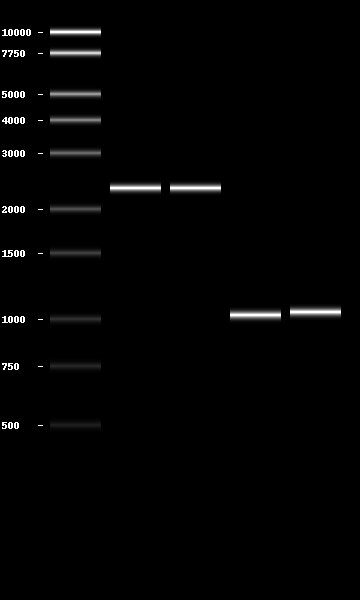

In [68]:
for band in parts_missing:
    print(band.name)
pydna.gel.gel([pydna.ladders.PennStateLadder,*[[band] for band in parts_missing]])

Mini prep 
conc - values

Ara failed. Promoteres were good. 

In [69]:
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['location'] = 'l5_D01'
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['concentration'] = 55
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['volume'] = 30
amplicon_by_name('PCR_PRO_02', amplicons).annotations['comments']= 'PCR_products for the second library round'
amplicon_by_name('PCR_PRO_02', amplicons).annotations['reference']= 'Made from designated start promoter pools'

amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches']

[{'location': 'l5_D01', 'volume': 30, 'concentration': 55}]

PCR_PRO_04 was pooled with an older sample. giving a concentration of 72

In [70]:
amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['location'] = 'l5_D02'
amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['concentration'] = 72
amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['volume'] = 50
amplicon_by_name('PCR_PRO_04', amplicons).annotations['comments']= 'PCR_products for the second library round'
amplicon_by_name('PCR_PRO_04', amplicons).annotations['reference']= 'Made from designated start promoter pools'


amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches']

[{'location': 'l5_D02', 'volume': 50, 'concentration': 72}]

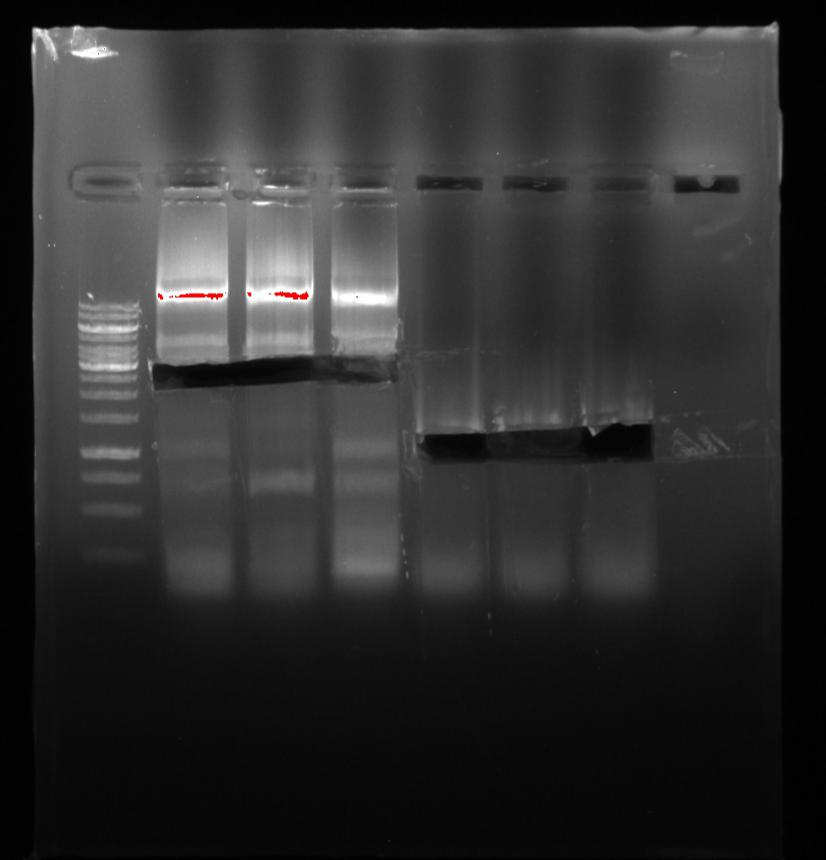

In [71]:
IPython.core.display.Image('../data/raw/001_Bioimager/2021-08-19_Q5part_creation_cut.jpg', width=600)

from the gel we can see a strong band that is big. this is plasmid that is left. I do no t need this much plasmid when making parts. 

In [72]:
from constrain.lims.csv_database import *


In [73]:
## Add missing parts to the databse - pCCW12 and pTPI1
amplicons1_to_databse =  [amplicon_by_name('PCR_PRO_02', amplicons), amplicon_by_name('PCR_PRO_04', amplicons)]

# add unique ids
add_unique_ids(amplicons1_to_databse,path = 'ConStrain_on_google_colab/Data/csv_database/' )

pcr_box = get_database('PCR_box', path = 'ConStrain_on_google_colab/Data/csv_database/')
#add_sequences_to_dataframe(amplicons1_to_databse, pcr_box)
pcr_box

,ID,name,date,box,row,col,size,seq,concentration,volume,features,location,reference,comments,description
0,10162.0,ATF1,09-06-2022,0,A,1,425.0,CGTGCGATTCTTTGAAAAGATAATGTATGATTATGCTTTCACTCAT...,57.0,50.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l4_I07,NaN,gRNA with ATF1 site to KO G8H,pcr_product_Stock of primers for G8H-CPR libra...
1,10163.0,CroCPR,09-06-2022,0,A,2,425.0,AGTGCAGGTTCTTTGAAAAGATAATGTATGATTATGCTTTCACTCA...,63.0,50.0,"[SeqFeature(FeatureLocation(ExactPosition(8), ...",l4_I08,NaN,gRNA with croCPR site to KO G8H,pcr_product_Stock of primers for G8H-CPR libra...
2,10165.0,tADH1-P1_PGK1_400,09-12-2022,0,A,3,659.0,ACTCTCGAGAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACC...,123.6,50.0,"[SeqFeature(FeatureLocation(ExactPosition(3), ...",l5_A02,NaN,ATF1_repair_template to KO G8H module,pcr_product_Stock of primers for G8H-CPR libra...
3,10168.0,XI-3,09-22-2022,0,A,4,1449.0,GTGCTTGATTTGCGTCATTCATTACCATAGTATTACTATTGGTGTT...,93.0,50.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l4_A08,NaN,CPR_repair_template to KO CPR module,pcr_product_Stock of primers for G8H-CPR libra...
4,10272.0,PCR_PRO_02,09-23-2022,0,A,5,1023.0,TTATCGAATGGGCATGCTCGGCGTATGGACCTGTCTAAAGAAACTT...,55.0,30.0,"[SeqFeature(FeatureLocation(ExactPosition(36),...",l5_D01,Made from designated start promoter pools,PCR_products for the second library round,pcr_product_description_description
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
805,NaN,NaN,NaN,9,I,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
806,NaN,NaN,NaN,9,I,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
807,NaN,NaN,NaN,9,I,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
808,NaN,NaN,NaN,9,I,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


already updated the database

In [74]:
#update_database(pcr_box, 'PCR_box', path=  'ConStrain_on_google_colab/Data/csv_database/')

## 4.2 Amplify promoters

PCR
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Created with PCR_program created according to protocol
- Elongation time: 31 sek (30 s/ kb)
- Annealing temp 60

In [75]:
parts_missing = [amplicon_by_name('PCR_PRO_01', amplicons),amplicon_by_name('PCR_PRO_02', amplicons), amplicon_by_name('PCR_PRO_04', amplicons), amplicon_by_name('PCR_PRO_06', amplicons)]
for part in parts_missing:
    print(part.name, part.annotations)

PCR_PRO_01 {'molecule_type': 'DNA', 'template_name': 'pCYC1', 'batches': [{'location': 'l4_C07', 'volume': 100.0, 'concentration': 100.0}], 'ta Q5 Hot Start': 60, 'polymerase': 'Q5 Hot Start', 'proc_speed': 30, 'elongation_time': 31}
PCR_PRO_02 {'molecule_type': 'DNA', 'template_name': 'pCCW12', 'batches': [{'location': 'l5_D01', 'volume': 30, 'concentration': 55}], 'ta Q5 Hot Start': 64, 'polymerase': 'Q5 Hot Start', 'proc_speed': 30, 'elongation_time': 31, 'comments': 'PCR_products for the second library round', 'reference': 'Made from designated start promoter pools'}
PCR_PRO_04 {'molecule_type': 'DNA', 'template_name': 'pTPI1', 'batches': [{'location': 'l5_D02', 'volume': 50, 'concentration': 72}], 'ta Q5 Hot Start': 62, 'polymerase': 'Q5 Hot Start', 'proc_speed': 30, 'elongation_time': 32, 'comments': 'PCR_products for the second library round', 'reference': 'Made from designated start promoter pools'}
PCR_PRO_06 {'molecule_type': 'DNA', 'template_name': 'pENO2', 'batches': [{'loc

In [76]:
longest_amplicon = 0
for amp in parts_missing:
    if len(amp) > longest_amplicon: longest_amplicon = len(amp)
print("Length of longest amplicon: \t" + str(longest_amplicon) + " bp")
print("Elongation time: \t\t"  + str(round(longest_amplicon/1000 * 35,1))+ " seconds")

Length of longest amplicon: 	1046 bp
Elongation time: 		36.6 seconds


In [77]:
#Information about locations
plate_locations = []
for amplicon in parts_missing:
    plate_locations.append([amplicon.name, 
                            amplicon.annotations['batches'][0]['location'],
                            amplicon.annotations['template_name'],
                            amplicon.template.annotations['batches'][0]['location'],
                            amplicon.forward_primer.id,
                            amplicon.forward_primer.annotations['batches'][0]['location'],
                            amplicon.reverse_primer.id,
                            amplicon.reverse_primer.annotations['batches'][0]['location']
                           ])
amplicon_e_df = pd.DataFrame(plate_locations, columns=['name', 'location','template_name','template_location','fw_name','fw_location','rv_name','rv_location'])
amplicon_e_df = amplicon_e_df.set_index('name')
amplicon_e_df

,location,template_name,template_location,fw_name,fw_location,rv_name,rv_location
name,,,,,,,
PCR_PRO_01,l4_C07,pCYC1,o5,PR_PRO_01,op4_A11,PR_PRO_02,op4_A12
PCR_PRO_02,l5_D01,pCCW12,o5,PR_PRO_03,op4_B11,PR_PRO_04,op4_B12
PCR_PRO_04,l5_D02,pTPI1,o5,PR_PRO_07,op4_D11,PR_PRO_08,op4_D12
PCR_PRO_06,l4_D03,pENO2,o5,PR_PRO_11,op4_F11,PR_PRO_12,op4_F12


In [78]:
#PCR program
pcr_volumes(vol_p_reac = 50, 
        no_of_reactions = 9,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_9_reac
Template,1.0,9.0
Primer 1,2.5,22.5
Primer 2,2.5,22.5
H20,19.0,171.0
Pol,25.0,225.0
Total,50.0,450.0


PCR_PRO_01
PCR_PRO_02
PCR_PRO_04
PCR_PRO_06


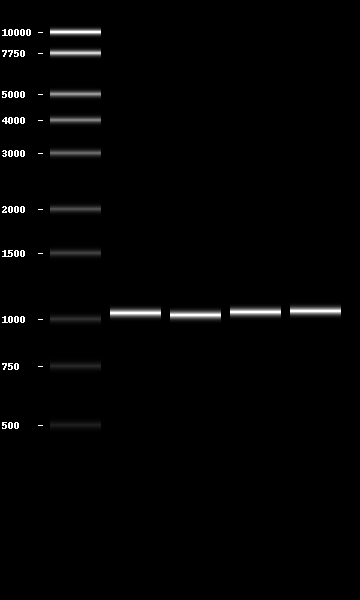

In [79]:
#Gel simulation
for band in parts_missing:
    print(band.name)
pydna.gel.gel([pydna.ladders.PennStateLadder,*[[band] for band in parts_missing]])

See gel in next section. 

## 4.3 Amplify parts- CroCPR, AraCPR, AhuCPR
missing:
- CroCPR_tCYC1
- AraCPR_tCYC1
- AhuCPR_tCYC1
- AthATR1_tCYC1


PCR
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Created with PCR_program created according to protocol
- Elongation time: 1:10 min:sek (30 s/ kb)
- Annealing temp 61


UP/DW/TRP: 
PCR
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Created with PCR_program created according to protocol
- Elongation time: 0:45 min:sek (30 s/ kb)
- Annealing temp 61

In [80]:
#Save amplicons that are missing
mis = ['CroCPR_tCYC1','AraCPR_tCYC1','AhuCPR_tCYC1','AthATR1_tCYC1','XI-2_UP','TRP1-marker','XI-2_DW']
missing_ampl = []
for frag_list_no, frag_list in enumerate(amplicon_matrix_reshaped_no_duplicates):
    for frag in frag_list:
        if frag.part_name in mis:
            missing_ampl.append(frag)

In [81]:
#Print information about the parts missing
for part in missing_ampl:
    print(part.name, part.annotations)

PCR_UP_tADH1_01 {'molecule_type': 'DNA', 'template_name': 'UP_XI-2', 'batches': [{'location': 'l5_I08', 'volume': 100.0, 'concentration': 30.0}], 'ta Q5 Hot Start': 60, 'polymerase': 'Q5 Hot Start', 'proc_speed': 30, 'elongation_time': 19}
PCR_CPR_31 {'molecule_type': 'DNA', 'template_name': 'CroCPR_tCYC1', 'batches': [{'location': 'l5_E06', 'volume': 100.0, 'concentration': 30.0}], 'ta Q5 Hot Start': 61, 'polymerase': 'Q5 Hot Start', 'proc_speed': 30, 'elongation_time': 71}
PCR_CPR_33 {'molecule_type': 'DNA', 'template_name': 'AraCPR_tCYC1', 'batches': [{'location': 'l5_F05', 'volume': 100.0, 'concentration': 20.0}], 'ta Q5 Hot Start': 61, 'polymerase': 'Q5 Hot Start', 'proc_speed': 30, 'elongation_time': 69}
PCR_CPR_36 {'molecule_type': 'DNA', 'template_name': 'AhuCPR_tCYC1', 'batches': [{'location': 'l5_G08', 'volume': 100.0, 'concentration': 20.0}], 'ta Q5 Hot Start': 61, 'polymerase': 'Q5 Hot Start', 'proc_speed': 30, 'elongation_time': 71}
PCR_CPR_21 {'molecule_type': 'DNA', 'tem

In [82]:
longest_amplicon = 0
for amp in missing_ampl:
    if len(amp) > longest_amplicon: longest_amplicon = len(amp)
print("Length of longest amplicon: \t" + str(longest_amplicon) + " bp")
print("Elongation time: \t\t"  + str(round(longest_amplicon/1000 * 35,1))+ " seconds")

Length of longest amplicon: 	2369 bp
Elongation time: 		82.9 seconds


In [83]:
plate_locations = []
for amplicon in missing_ampl:
    plate_locations.append([amplicon.name, 
                            amplicon.annotations['batches'][0]['location'],
                            amplicon.annotations['template_name'],
                            amplicon.template.annotations['batches'][0]['location'],
                            amplicon.forward_primer.id,
                            amplicon.forward_primer.annotations['batches'][0]['location'],
                            amplicon.reverse_primer.id,
                            amplicon.reverse_primer.annotations['batches'][0]['location']
                           ])
amplicon_e_df = pd.DataFrame(plate_locations, columns=['name', 'location','template_name','template_location','fw_name','fw_location','rv_name','rv_location'])
amplicon_e_df = amplicon_e_df.set_index('name')
amplicon_e_df

,location,template_name,template_location,fw_name,fw_location,rv_name,rv_location
name,,,,,,,
PCR_UP_tADH1_01,l5_I08,UP_XI-2,o5,PR_UP_tADH1_05,o2_I06,PR_UP_tADH1_06,o2_I07
PCR_CPR_31,l5_E06,CroCPR_tCYC1,o5,PR_CPR_30,op4_H01,PR_CPR_02,op4_B10
PCR_CPR_33,l5_F05,AraCPR_tCYC1,o5,PR_CPR_32,op4_H03,PR_CPR_02,op4_B10
PCR_CPR_36,l5_G08,AhuCPR_tCYC1,o5,PR_CPR_35,op4_H06,PR_CPR_02,op4_B10
PCR_CPR_21,l5_E05,CroCPR_tCYC1,o5,PR_CPR_21,op4_G01,PR_CPR_02,op4_B10
PCR_CPR_23,l5_F04,AraCPR_tCYC1,o5,PR_CPR_23,op4_G03,PR_CPR_02,op4_B10
PCR_CPR_26,l5_G07,AhuCPR_tCYC1,o5,PR_CPR_26,op4_G06,PR_CPR_02,op4_B10
PCR_CPR_11,l5_E04,CroCPR_tCYC1,o5,PR_CPR_12,op4_F01,PR_CPR_02,op4_B10
PCR_CPR_13,l5_F03,AraCPR_tCYC1,o5,PR_CPR_14,op4_F03,PR_CPR_02,op4_B10


In [84]:
pcr_volumes(vol_p_reac = 50, 
        no_of_reactions = 11,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_11_reac
Template,1.0,11.0
Primer 1,2.5,27.5
Primer 2,2.5,27.5
H20,19.0,209.0
Pol,25.0,275.0
Total,50.0,550.0


PCR_UP_tADH1_01
PCR_CPR_31
PCR_CPR_33
PCR_CPR_36
PCR_CPR_21
PCR_CPR_23
PCR_CPR_26
PCR_CPR_11
PCR_CPR_13
PCR_CPR_16
PCR_CPR_01
PCR_CPR_03
PCR_CPR_06
PCR_TRP1-DW_01
PCR_TRP1-DW_02


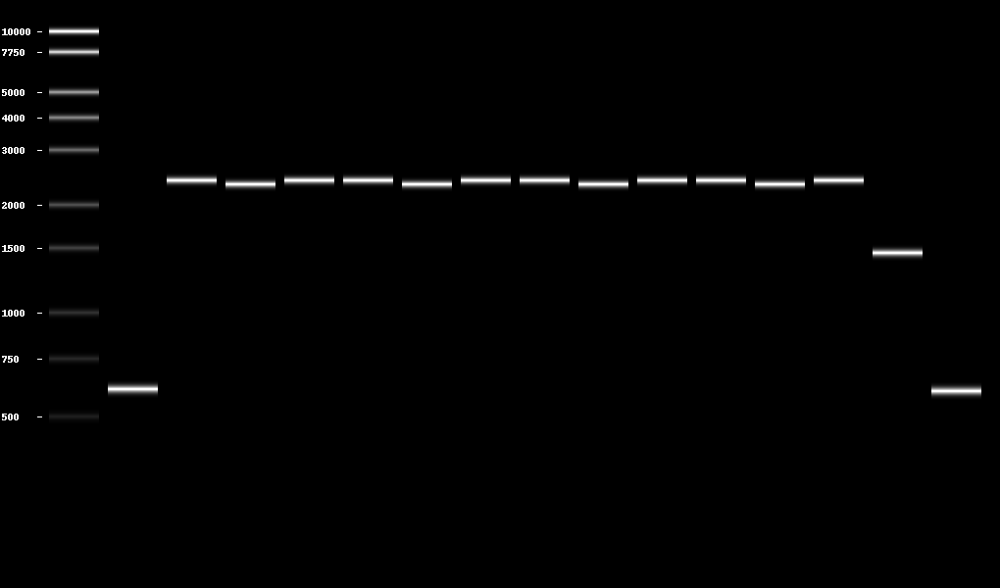

In [85]:
for band in missing_ampl:
    print(band.name)
pydna.gel.gel([pydna.ladders.GeneRuler_1kb,*[[band] for band in missing_ampl],pydna.ladders.GeneRuler_1kb])

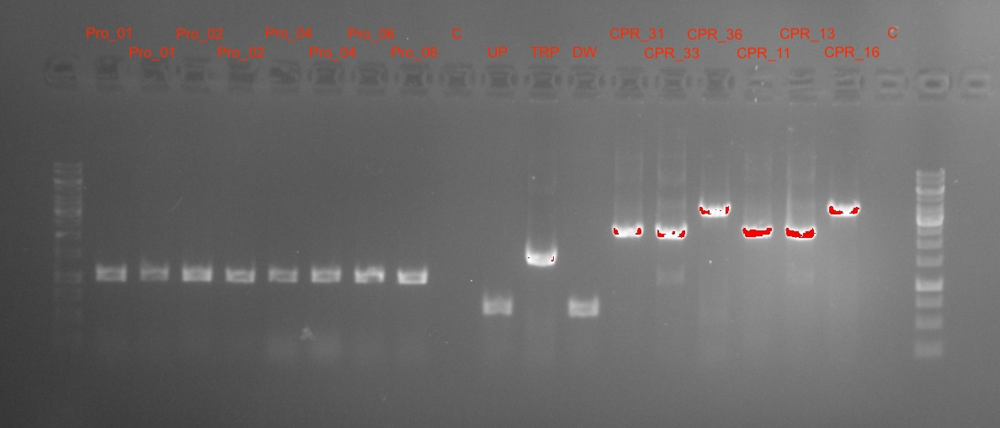

In [86]:
#Gel with promoters and genes. 
IPython.core.display.Image('../data/raw/001_Bioimager/2021-08_30_Q5_parts.jpg', width=600)

The length og CPR_36 and CPR_16 (Ahu) does not match the expected length. 
THey were send for sequencing with the primers used in PCR and the primer from Beata 
BJL 249 AhuCPR seq R, each primer mixed alone with the PCR product + ExoSAP
5,5 PCR + 2,2 ExoSAP 

In [87]:
parts_created = ['CroCPR_tCYC1','AraCPR_tCYC1','AhuCPR_tCYC1','AthATR1_tCYC1']

In [88]:
#Update the information of the new bathces
amplicon_by_name('PCR_CPR_31', amplicons).annotations['batches'][0]['location'] = 'l6_A4'
amplicon_by_name('PCR_CPR_31', amplicons).annotations['batches'][0]['concentration'] = 100
amplicon_by_name('PCR_CPR_31', amplicons).annotations['batches'][0]['volume'] = 30
amplicon_by_name('PCR_CPR_31', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_33', amplicons).annotations['batches'][0]['location'] = 'l6_A5'
amplicon_by_name('PCR_CPR_33', amplicons).annotations['batches'][0]['concentration'] = 91
amplicon_by_name('PCR_CPR_33', amplicons).annotations['batches'][0]['volume'] = 30
amplicon_by_name('PCR_CPR_33', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_36', amplicons).annotations['batches'][0]['location'] = 'l6_A6'
amplicon_by_name('PCR_CPR_36', amplicons).annotations['batches'][0]['concentration'] = 40
amplicon_by_name('PCR_CPR_36', amplicons).annotations['batches'][0]['volume'] = 30
amplicon_by_name('PCR_CPR_36', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_11', amplicons).annotations['batches'][0]['location'] = 'l6_A7'
amplicon_by_name('PCR_CPR_11', amplicons).annotations['batches'][0]['concentration'] = 62
amplicon_by_name('PCR_CPR_11', amplicons).annotations['batches'][0]['volume'] = 30
amplicon_by_name('PCR_CPR_11', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_13', amplicons).annotations['batches'][0]['location'] = 'l6_A8'
amplicon_by_name('PCR_CPR_13', amplicons).annotations['batches'][0]['concentration'] = 40
amplicon_by_name('PCR_CPR_13', amplicons).annotations['batches'][0]['volume'] = 30
amplicon_by_name('PCR_CPR_13', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_16', amplicons).annotations['batches'][0]['location'] = 'l6_A9'
amplicon_by_name('PCR_CPR_16', amplicons).annotations['batches'][0]['concentration'] = 83
amplicon_by_name('PCR_CPR_16', amplicons).annotations['batches'][0]['volume'] = 30
amplicon_by_name('PCR_CPR_16', amplicons).annotations['batches']

[{'location': 'l6_A9', 'volume': 30, 'concentration': 83}]

Due to low concentrations and low volumes, they were repeated. The quality of the CPR_11-36 was not good enough. Create a new batch 

In [89]:
mis = ['CroCPR_tCYC1','AraCPR_tCYC1','AhuCPR_tCYC1','AthATR1_tCYC1','pCCW12']
missing_ampl = []
for frag_list_no, frag_list in enumerate(amplicon_matrix_reshaped_no_duplicates):
    #print("All parts for fragment no: " + str(frag_list_no))
    for frag in frag_list:
        if frag.part_name in mis:
            missing_ampl.append(frag)
        #print(frag.name, frag.part_name)
    #print()

In [90]:
plate_locations = []
for amplicon in missing_ampl:
    plate_locations.append([amplicon.name, 
                            amplicon.annotations['batches'][0]['location'],
                            amplicon.annotations['template_name'],
                            amplicon.template.annotations['batches'][0]['location'],
                            amplicon.forward_primer.id,
                            amplicon.forward_primer.annotations['batches'][0]['location'],
                            amplicon.reverse_primer.id,
                            amplicon.reverse_primer.annotations['batches'][0]['location']
                           ])
amplicon_e_df = pd.DataFrame(plate_locations, columns=['name', 'location','template_name','template_location','fw_name','fw_location','rv_name','rv_location'])
amplicon_e_df = amplicon_e_df.set_index('name')
amplicon_e_df

,location,template_name,template_location,fw_name,fw_location,rv_name,rv_location
name,,,,,,,
PCR_PRO_02,l5_D01,pCCW12,o5,PR_PRO_03,op4_B11,PR_PRO_04,op4_B12
PCR_CPR_31,l6_A4,CroCPR_tCYC1,o5,PR_CPR_30,op4_H01,PR_CPR_02,op4_B10
PCR_CPR_33,l6_A5,AraCPR_tCYC1,o5,PR_CPR_32,op4_H03,PR_CPR_02,op4_B10
PCR_CPR_36,l6_A6,AhuCPR_tCYC1,o5,PR_CPR_35,op4_H06,PR_CPR_02,op4_B10
PCR_CPR_21,l5_E05,CroCPR_tCYC1,o5,PR_CPR_21,op4_G01,PR_CPR_02,op4_B10
PCR_CPR_23,l5_F04,AraCPR_tCYC1,o5,PR_CPR_23,op4_G03,PR_CPR_02,op4_B10
PCR_CPR_26,l5_G07,AhuCPR_tCYC1,o5,PR_CPR_26,op4_G06,PR_CPR_02,op4_B10
PCR_CPR_11,l6_A7,CroCPR_tCYC1,o5,PR_CPR_12,op4_F01,PR_CPR_02,op4_B10
PCR_CPR_13,l6_A8,AraCPR_tCYC1,o5,PR_CPR_14,op4_F03,PR_CPR_02,op4_B10


In [91]:
pcr_volumes(vol_p_reac = 50, 
        no_of_reactions = 15,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_15_reac
Template,1.0,15.0
Primer 1,2.5,37.5
Primer 2,2.5,37.5
H20,19.0,285.0
Pol,25.0,375.0
Total,50.0,750.0


PCR
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Create according to protocol
- Elongation time: 1.5 min (30 s/ kb)
- Annealing temp 61,5


In [92]:
from pydna.dseqrecord import Dseqrecord

In [93]:
for ampl in missing_ampl:
    print(ampl.name)
    print(Dseqrecord(ampl.forward_primer.footprint).seq.watson)
    print(Dseqrecord(ampl.reverse_primer.footprint).seq.watson)
    print(len(ampl))

PCR_PRO_02
AAAGAAACTTAATACGTTATGCCG
TATTGATATAGTGTTTAAGCGAATGAC
1023
PCR_CPR_31
ATGGACTCATCCTCCGAG
TTCTCAAGCAAGGTTTTCAG
2364
PCR_CPR_33
ATGACATCAGCTCTTTACGC
TTCTCAAGCAAGGTTTTCAG
2298
PCR_CPR_36
ATGGACTCCTCATCGGAGA
TTCTCAAGCAAGGTTTTCAG
2364
PCR_CPR_21
ATGGACTCATCCTCCGAG
TTCTCAAGCAAGGTTTTCAG
2369
PCR_CPR_23
ATGACATCAGCTCTTTACGC
TTCTCAAGCAAGGTTTTCAG
2303
PCR_CPR_26
ATGGACTCCTCATCGGAGA
TTCTCAAGCAAGGTTTTCAG
2369
PCR_CPR_11
ATGGACTCATCCTCCGAG
TTCTCAAGCAAGGTTTTCAG
2364
PCR_CPR_13
ATGACATCAGCTCTTTACGC
TTCTCAAGCAAGGTTTTCAG
2298
PCR_CPR_16
ATGGACTCCTCATCGGAGA
TTCTCAAGCAAGGTTTTCAG
2364
PCR_CPR_01
ATGGACTCATCCTCCGAG
TTCTCAAGCAAGGTTTTCAG
2365
PCR_CPR_03
ATGACATCAGCTCTTTACGC
TTCTCAAGCAAGGTTTTCAG
2299
PCR_CPR_06
ATGGACTCCTCATCGGAGA
TTCTCAAGCAAGGTTTTCAG
2365


In [94]:
annealing = [61,61,61,61,61,61,61]

PCR
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Created with PCR_program created according to protocol
- Elongation time: 1:30 min:sek (30 s/ kb)
- Annealing temp 61.5

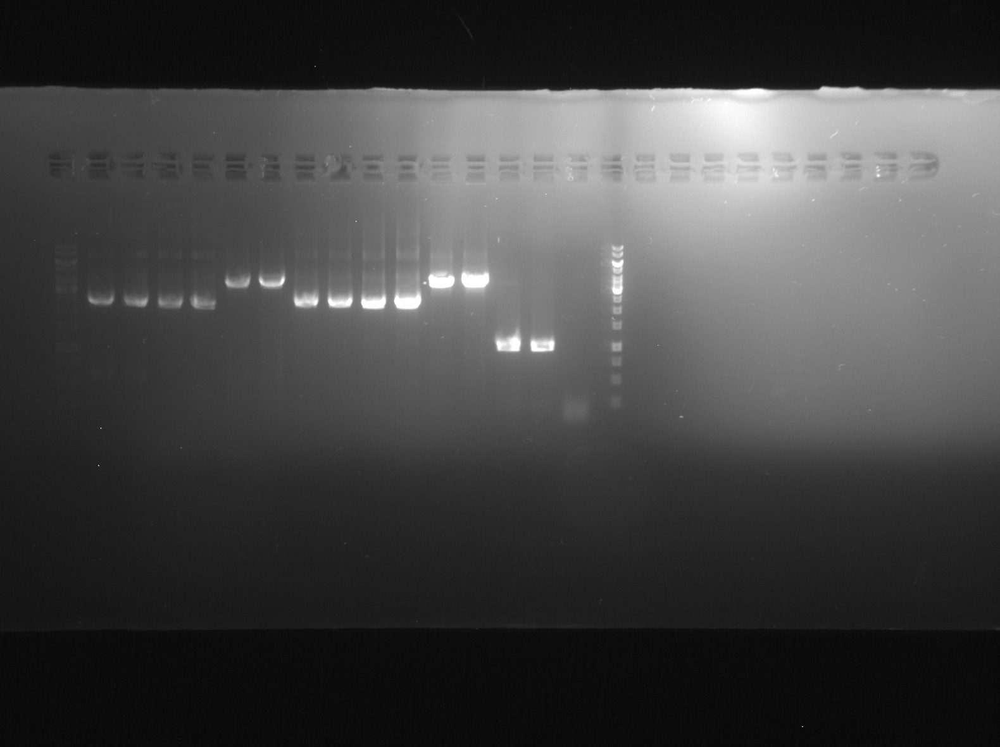

In [95]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/raw//001_Bioimager/2021-09_06_Q5_CPR_PRom.jpg', width=600)

The promoter was good, this wil be PCR purified. The genes have a large band in the top which might be the plasmid. Therefore the PCR is run again, but with a dilution of the template to 5 ng/ul. 

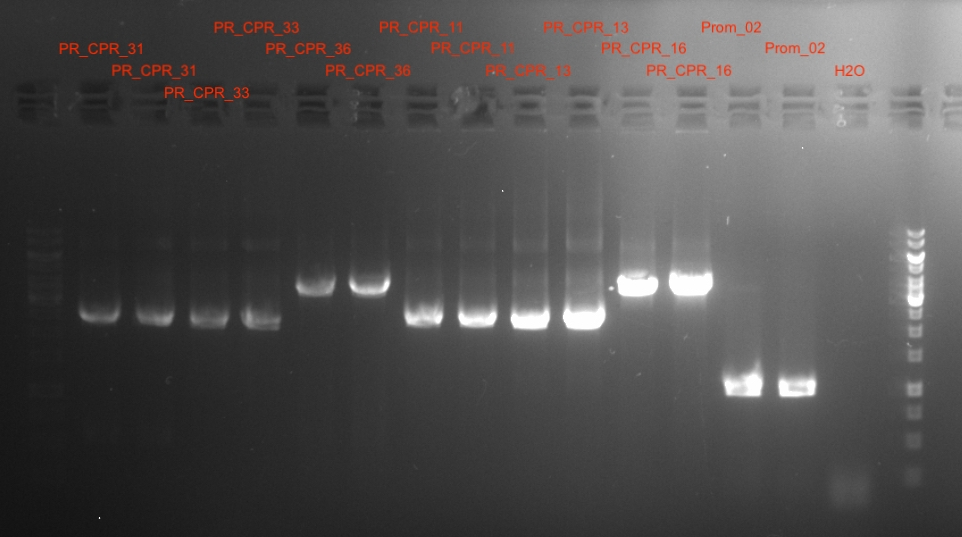

In [96]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/raw//001_Bioimager/2021-09_06_Q5_CPR_PRom_dark.jpg', width=600)

Redid the 13 and 16 sample again at 63 annealing tempt. 

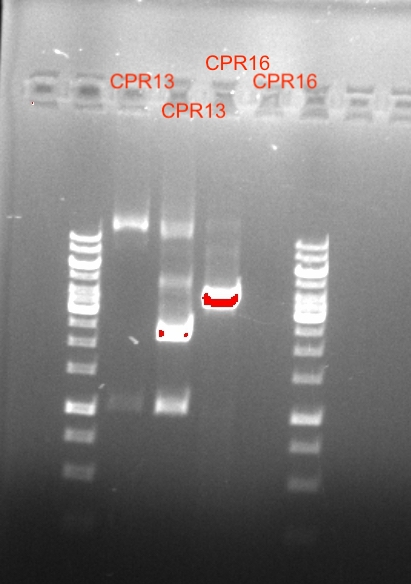

In [97]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/raw//001_Bioimager/2021-09_07_Q5_1316.jpg', width=300)

There was no polymerase left for CPR16-2 which explains the missing band. 

In [98]:
amplicon_by_name('PCR_CPR_31', amplicons).annotations['batches'][0]['location'] = 'l6_C4'
amplicon_by_name('PCR_CPR_31', amplicons).annotations['batches'][0]['concentration'] = 322
amplicon_by_name('PCR_CPR_31', amplicons).annotations['batches'][0]['volume'] = 60
amplicon_by_name('PCR_CPR_31', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_33', amplicons).annotations['batches'][0]['location'] = 'l6_C5'
amplicon_by_name('PCR_CPR_33', amplicons).annotations['batches'][0]['concentration'] = 415
amplicon_by_name('PCR_CPR_33', amplicons).annotations['batches'][0]['volume'] = 60
amplicon_by_name('PCR_CPR_33', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_36', amplicons).annotations['batches'][0]['location'] = 'l6_C6'
amplicon_by_name('PCR_CPR_36', amplicons).annotations['batches'][0]['concentration'] = 319
amplicon_by_name('PCR_CPR_36', amplicons).annotations['batches'][0]['volume'] = 60
amplicon_by_name('PCR_CPR_36', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_11', amplicons).annotations['batches'][0]['location'] = 'l6_C7'
amplicon_by_name('PCR_CPR_11', amplicons).annotations['batches'][0]['concentration'] = 471
amplicon_by_name('PCR_CPR_11', amplicons).annotations['batches'][0]['volume'] = 60
amplicon_by_name('PCR_CPR_11', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_13', amplicons).annotations['batches'][0]['location'] = 'l6_C8'
amplicon_by_name('PCR_CPR_13', amplicons).annotations['batches'][0]['concentration'] = 370
amplicon_by_name('PCR_CPR_13', amplicons).annotations['batches'][0]['volume'] = 60
amplicon_by_name('PCR_CPR_13', amplicons).annotations['batches']

amplicon_by_name('PCR_CPR_16', amplicons).annotations['batches'][0]['location'] = 'l6_C9'
amplicon_by_name('PCR_CPR_16', amplicons).annotations['batches'][0]['concentration'] = 309
amplicon_by_name('PCR_CPR_16', amplicons).annotations['batches'][0]['volume'] = 60
amplicon_by_name('PCR_CPR_16', amplicons).annotations['batches']

amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['location'] = 'l6_B2'
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['concentration'] = 108
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['volume'] = 55
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches']

[{'location': 'l6_B2', 'volume': 55, 'concentration': 108}]

### 4.3.1 Adding the newly amplified parts to the csv database

In [54]:
## Add missing parts to the database
amplicons2_to_databse =  [amplicon_by_name('PCR_CPR_31', amplicons),
                          amplicon_by_name('PCR_PRO_04', amplicons),
                          amplicon_by_name('PCR_CPR_33', amplicons), 
                          amplicon_by_name('PCR_CPR_36', amplicons),
                          amplicon_by_name('PCR_CPR_11', amplicons), 
                          amplicon_by_name('PCR_CPR_13', amplicons), 
                          amplicon_by_name('PCR_CPR_16', amplicons),
                          amplicon_by_name('PCR_PRO_02', amplicons)]

for amplicon in amplicons: 
    amplicon.annotations['comments'] = 'PCR_products for the second library round'
    amplicon.annotations['reference'] = 'Made from designated start pools from the G8H library'    

# add unique ids
add_unique_ids(amplicons2_to_databse,path = 'ConStrain_on_google_colab/Data/csv_database/' )

pcr_box = get_database('PCR_box', path = 'ConStrain_on_google_colab/Data/csv_database/')
#add_sequences_to_dataframe(amplicons2_to_databse, pcr_box)
pcr_box.head(14)

NameError: name 'amplicon_by_name' is not defined

I already updated the database hence the commented out line below

In [100]:
#update_database(pcr_box, 'PCR_box', path=  'ConStrain_on_google_colab/Data/csv_database/')

### 4.3.2 Part Creation for the third transfomration

In [101]:
mis = ['OeuG8H_tADH1','pCCW12','pTPI1','pCYC1','pENO2','XI-2_UP','TRP1-marker','XI-2_DW']
missing_ampl = []
for frag_list_no, frag_list in enumerate(amplicon_matrix_reshaped_no_duplicates):
    #print("All parts for fragment no: " + str(frag_list_no))
    for frag in frag_list:
        if frag.part_name in mis:
            if frag.name != 'PCR_G8H_30':
                missing_ampl.append(frag)
        #print(frag.name, frag.part_name)
    #print()
    
plate_locations = []
for amplicon in missing_ampl:
    plate_locations.append([amplicon.name, 
                            amplicon.annotations['batches'][0]['location'],
                            amplicon.annotations['template_name'],
                            amplicon.template.annotations['batches'][0]['location'],
                            amplicon.forward_primer.id,
                            amplicon.forward_primer.annotations['batches'][0]['location'],
                            amplicon.reverse_primer.id,
                            amplicon.reverse_primer.annotations['batches'][0]['location']
                           ])
amplicon_e_df = pd.DataFrame(plate_locations, columns=['name', 'location','template_name','template_location','fw_name','fw_location','rv_name','rv_location'])
amplicon_e_df = amplicon_e_df.set_index('name')
amplicon_e_df


,location,template_name,template_location,fw_name,fw_location,rv_name,rv_location
name,,,,,,,
PCR_UP_tADH1_01,l5_I08,UP_XI-2,o5,PR_UP_tADH1_05,o2_I06,PR_UP_tADH1_06,o2_I07
PCR_G8H_29,l5_D04,OeuG8H_tADH1,o5,PR_G8H_01,o3_F07,PR_G8H_30,op4_A08
PCR_PRO_01,l4_C07,pCYC1,o5,PR_PRO_01,op4_A11,PR_PRO_02,op4_A12
PCR_PRO_06,l4_D03,pENO2,o5,PR_PRO_11,op4_F11,PR_PRO_12,op4_F12
PCR_PRO_02,l6_B2,pCCW12,o5,PR_PRO_03,op4_B11,PR_PRO_04,op4_B12
PCR_PRO_04,l5_D02,pTPI1,o5,PR_PRO_07,op4_D11,PR_PRO_08,op4_D12
PCR_TRP1-DW_01,l5_I07,seq_3HMRtcpy,o5,PR_TRP1-DW_01,op4_C10,PR_TRP1-DW_02,op4_D10
PCR_TRP1-DW_02,l5_I09,DW_XI-2,o5,PR_TRP1-DW_05,o2_I08,PR_TRP1-DW_06,o2_I09


In [102]:
dublicates = 3
n =(len(amplicon_e_df)*dublicates+len(amplicon_e_df)*dublicates*0.1)
pcr_volumes(vol_p_reac = 50, 
        no_of_reactions = n,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_26.4_reac
Template,1.0,26.4
Primer 1,2.5,66.0
Primer 2,2.5,66.0
H20,19.0,501.6
Pol,25.0,660.0
Total,50.0,1320.0


In [103]:
for ampl in missing_ampl:
    print(ampl.name)
    print(Dseqrecord(ampl.forward_primer.footprint).seq.watson)
    print(Dseqrecord(ampl.reverse_primer.footprint).seq.watson)
    print(len(ampl))

PCR_UP_tADH1_01
GAGGATTTTCGATGGAGC
TTGTGGAAGTTCATGGC
609
PCR_G8H_29
GAGCGACCTCATGCTATAC
ATGGACTTCTTAACAATCGTTTTAG
1845
PCR_PRO_01
TATTAATTTAGTGTGTGTATTTGTGTTTG
CAGCATTTTCAAAGGTGTG
1033
PCR_PRO_06
TATTATTGTATGTTATAGTATTAGTTGCTTGG
AATCCTACTCTTGCCGTTG
1046
PCR_PRO_02
AAAGAAACTTAATACGTTATGCCG
TATTGATATAGTGTTTAAGCGAATGAC
1023
PCR_PRO_04
AAGGATGAGCCAAGAATAAGG
TTTTAGTTTATGTATGTGTTTTTTGTAG
1043
PCR_TRP1-DW_01
AGACGGTCACAGCTTGTCTGTAAGC
CGTAGTGGGCCATCGCCC
1451
PCR_TRP1-DW_02
CACACGACTAGCGCT
GTGGGAAGATTCCGCT
599


59
60
59
60
60
57
71
61

PCR
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Create according to protocol
- Elongation time: 1.5 min (30 s/ kb)
- Annealing temp 60



PCR_UP_tADH1_01
PCR_G8H_29
PCR_PRO_01
PCR_PRO_06
PCR_PRO_02
PCR_PRO_04
PCR_TRP1-DW_01
PCR_TRP1-DW_02


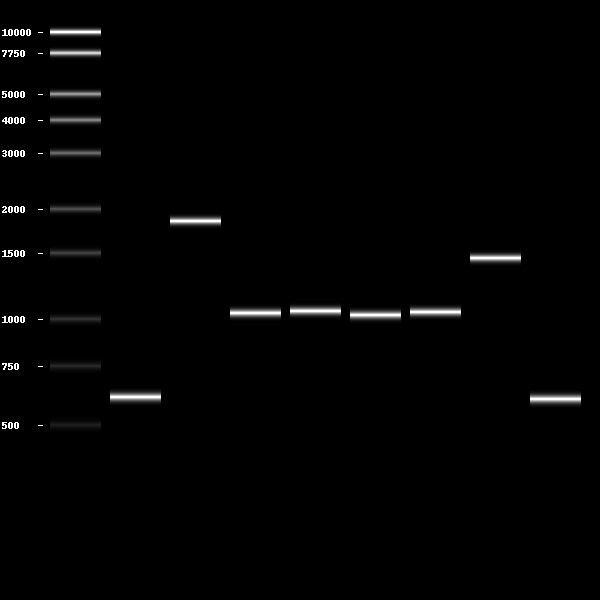

In [104]:
for band in missing_ampl:
    print(band.name)
pydna.gel.gel([pydna.ladders.PennStateLadder,*[[band] for band in missing_ampl]])

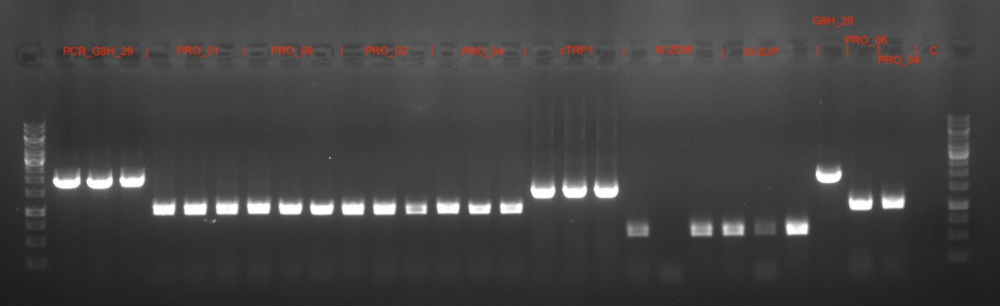

In [105]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/raw//001_Bioimager/2021-09_13_Q5_parts.jpg', width=700)

All parts can be purified except XI-2DW 2

# 5. Testing growth rate
MIA-HA1-b
- First innoculation: at 15.30.
- at 08.40 next day: OD: 0.95

- kl 09.08: OD: 0.317
- kl 10.03: OD: 0,379
- kl 10.55: OD: 0.469
- kl 11.54: OD: 0.294/0.5 = 0.588
- kl 12.56: OD: 0.344/0.5 = 0.644
- kl 14.13: oD: 0.226/0.25 = 0.904
- kl 15.45: OD: 0.303/0.25 = 1.212



In [106]:
#Lists of time and OD
time = [0,(55/60), ((55+52)/60), ((55+52+59)/60), ((55+52+59+62)/60), ((55+52+59+62+77)/60), ((55+52+59+62+77+92)/60)]
OD = [0.317, 0.379, 0.469, 0.588, 0.644, 0.904, 1.212]


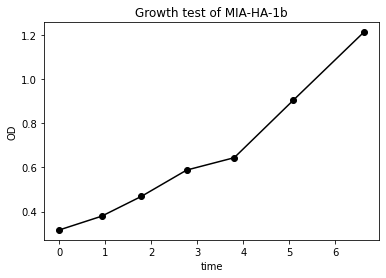

<Figure size 216x288 with 0 Axes>

In [107]:
#plot the growth rate
import matplotlib.pyplot as plt
plt.plot(time, OD, '-ok')
plt.ylabel('OD')
plt.xlabel('time')
plt.title("Growth test of MIA-HA-1b", fontdict=None, loc='center', pad=None)
plt.figure(figsize=(3,4))
plt.show()


In [108]:
time

[0,
 0.9166666666666666,
 1.7833333333333334,
 2.7666666666666666,
 3.8,
 5.083333333333333,
 6.616666666666666]

In [109]:
from constrain.lab.transformation import ODtime, wanted_mass


In [110]:
# What's the doubling time?
ODtime(initialOD = 0.3, time = 6.6, td = 0.307)

1.222

## 5.1 Parts check in laboratory
Through investigatino of parts it was found that:

from Own stock I can use:
- OeuG8H_tADH1
- RsepG8H_tADH1
- VminG8H_tADH1
- SmusG8H
- AanCPR
- CloCPR
- RseCPR


from Sørens stock:
- CroG8H
- AniCPR

To be determined: 

missing:
- CroCPR
- AraCPR
- AhuCPR

Q:
- how much od I need of gRNA
- How much do I need of the up, dw, trp?
- how much promoter do I need


### Make a trial transformation 
 
Sørens pools: CcalG8H_tADH1, OeuCPR_tCYC1, CpoCPR_tCYC1
pool of promoter 7,8,3 and 5
See notebook: Check_parts


promoters# Pools
Pool genes

pool gRNA

check amount of 

In [111]:
from constrain.lab.transformation import wanted_volume, wanted_mass

## 5.2 Make promoter pool

In [112]:
#Save amounts needed and amplicons
promoters_amounts_total = 0.001*4
promoter_names = ('PCR_PRO_01','PCR_PRO_06','PCR_PRO_02','PCR_PRO_04')
promoter_parts_amounts_total = {k: v for (k, v) in zip(promoter_names,[promoters_amounts_total/8]*len(promoter_names))}
promoters = [amplicon_by_name(name,amplicons) for name in promoter_names]

#Find volume needed
volumes = []
ngs = []
for amp in promoters:
    if amp.name == "PCR_PRO_01":
        w_moles = promoter_parts_amounts_total[amp.name]
        w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
        act_conc = 100.0
        w_volume = wanted_volume(w_mass, act_conc)
        volumes.append(w_volume)
        ngs.append(w_volume * act_conc)
        print(amp.name, w_volume, act_conc, '\t',amp.annotations['batches'][0]['location'])
    else:
        w_moles = promoter_parts_amounts_total[amp.name]
        w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
        act_conc = amp.annotations['batches'][0]['concentration']
        w_volume = wanted_volume(w_mass, act_conc)
        volumes.append(w_volume)
        ngs.append(w_volume * act_conc)
        print(amp.name, w_volume, act_conc, '\t', amp.annotations['batches'][0]['location'])

#Count total concentrtaion expected    
total_vol = sum(volumes)
total_ngs = sum(ngs)
total_conc = total_ngs/total_vol
print('total volume: ', sum(volumes))
print()
print('total ngs: ', sum(ngs))
print('total conc: ', total_conc)



#multiply with n if more is needed
n=9
print("\n",n," amount")
print("name, volume, concentration, location")
volumes = []
ngs = []
for amp in promoters:
    if amp.name == "PCR_PRO_01":
        w_moles = promoter_parts_amounts_total[amp.name]
        w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
        act_conc = 100.0
        w_volume = wanted_volume(w_mass, act_conc)*n
        volumes.append(w_volume)
        ngs.append(w_volume * act_conc)
        print(amp.name, w_volume, act_conc, '\t',amp.annotations['batches'][0]['location'])
    else:
        w_moles = promoter_parts_amounts_total[amp.name]
        w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
        act_conc = amp.annotations['batches'][0]['concentration']
        w_volume = wanted_volume(w_mass, act_conc)*n
        volumes.append(w_volume)
        ngs.append(w_volume * act_conc)
        print(amp.name, round(w_volume), act_conc, '\t', amp.annotations['batches'][0]['location'])

#Count total concentrtaion expected    
total_vol = sum(volumes)
total_ngs = sum(ngs)
total_conc_prom = total_ngs/total_vol
print('total volume: ', sum(volumes))
print()
print('total ngs: ', sum(ngs))
print('total conc: ', total_conc)





PCR_PRO_01 3.4 100.0 	 l4_C07
PCR_PRO_06 3.1 110.0 	 l4_D03
PCR_PRO_02 3.1 108 	 l6_B2
PCR_PRO_04 4.7 72 	 l5_D02
total volume:  14.3

total ngs:  1354.2
total conc:  94.6993006993007

 9  amount
name, volume, concentration, location
PCR_PRO_01 30.599999999999998 100.0 	 l4_C07
PCR_PRO_06 28 110.0 	 l4_D03
PCR_PRO_02 28 108 	 l6_B2
PCR_PRO_04 42 72 	 l5_D02
total volume:  128.70000000000002

total ngs:  12187.800000000001
total conc:  94.6993006993007


In [113]:
#After more amplifications
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['location'] = 'l6_B2'
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['concentration'] = 81
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['volume'] = 80
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches']

amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['location'] = 'l6_B3'
amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['concentration'] = 75
amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['volume'] = 80
amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches']

amplicon_by_name('PCR_PRO_06', amplicons).annotations['batches'][0]['location'] = 'l6_B4'
amplicon_by_name('PCR_PRO_06', amplicons).annotations['batches'][0]['concentration'] = 88
amplicon_by_name('PCR_PRO_06', amplicons).annotations['batches'][0]['volume'] = 80
amplicon_by_name('PCR_PRO_06', amplicons).annotations['batches']

amplicon_by_name('PCR_PRO_01', amplicons).annotations['batches'][0]['location'] = 'l6_B1'
amplicon_by_name('PCR_PRO_01', amplicons).annotations['batches'][0]['concentration'] = 90
amplicon_by_name('PCR_PRO_01', amplicons).annotations['batches'][0]['volume'] = 80
amplicon_by_name('PCR_PRO_01', amplicons).annotations['batches']

#There was not enough in 02. so a new batch was made 
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['location'] = 'l6_B2'
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['concentration'] = 108
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['volume'] = 55
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches']

[{'location': 'l6_B2', 'volume': 55, 'concentration': 108}]

In [114]:
#Save amounts needed and amplicons
promoters_amounts_total = 0.001*4 
promoter_names = ('PCR_PRO_01','PCR_PRO_06','PCR_PRO_02','PCR_PRO_04')
promoter_parts_amounts_total = {k: v for (k, v) in zip(promoter_names,[promoters_amounts_total/8]*len(promoter_names))}
promoters = [amplicon_by_name(name,amplicons) for name in promoter_names]

#Find volume needed
volumes = []
ngs = []
for amp in promoters:
    if amp.name == "PCR_PRO_01":
        w_moles = promoter_parts_amounts_total[amp.name]
        w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
        act_conc = 100.0
        w_volume = wanted_volume(w_mass, act_conc)
        volumes.append(w_volume)
        ngs.append(w_volume * act_conc)
        print(amp.name, w_volume, act_conc, '\t',amp.annotations['batches'][0]['location'])
    else:
        w_moles = promoter_parts_amounts_total[amp.name]
        w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
        act_conc = amp.annotations['batches'][0]['concentration']
        w_volume = wanted_volume(w_mass, act_conc)
        volumes.append(w_volume)
        ngs.append(w_volume * act_conc)
        print(amp.name, w_volume, act_conc, '\t', amp.annotations['batches'][0]['location'])

    
total_vol = sum(volumes)
total_ngs = sum(ngs)
total_conc = total_ngs/total_vol
print('total volume: ', sum(volumes))
print('total ngs: ', sum(ngs))
print('total conc: ', total_conc)


print("\nfirst pool")
print("name, volume, concentration, location")
volumes = []
ngs = []
for amp in promoters:

    w_moles = promoter_parts_amounts_total[amp.name]
    w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
    act_conc = amp.annotations['batches'][0]['concentration']
    w_volume = wanted_volume(w_mass, act_conc)*9
    volumes.append(w_volume)
    ngs.append(w_volume * act_conc)
    print(amp.name, round(w_volume), act_conc, '\t', amp.annotations['batches'][0]['location'])

    
total_vol = sum(volumes)
total_ngs = sum(ngs)
total_conc_prom = total_ngs/total_vol
print('total volume: ', sum(volumes))
print('total ngs: ', sum(ngs))
print('total conc: ', total_conc)

#There was not enough in the first pool, so a little extra was made
print("\nextra first pool")
print("name, volume, concentration, location")
volumes = []
ngs = []
for amp in promoters:

    w_moles = promoter_parts_amounts_total[amp.name]
    w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
    act_conc = amp.annotations['batches'][0]['concentration']
    w_volume = wanted_volume(w_mass, act_conc)*(10.5-9)
    volumes.append(w_volume)
    ngs.append(w_volume * act_conc)
    print(amp.name, round(w_volume), act_conc, '\t', amp.annotations['batches'][0]['location'])

    
total_vol = sum(volumes)
total_ngs = sum(ngs)
total_conc_prom = total_ngs/total_vol
print('total volume: ', sum(volumes))
print('total ngs: ', sum(ngs))
print('total conc: ', total_conc)

#Second pool
print("\nsecond pool")
print("name, volume, concentration, location")
volumes = []
ngs = []
for amp in promoters:

    w_moles = promoter_parts_amounts_total[amp.name]
    w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
    act_conc = amp.annotations['batches'][0]['concentration']
    w_volume = wanted_volume(w_mass, act_conc)*7
    volumes.append(w_volume)
    ngs.append(w_volume * act_conc)
    print(amp.name, round(w_volume,2), act_conc, '\t', amp.annotations['batches'][0]['location'])

    
total_vol = sum(volumes)
total_ngs = sum(ngs)
total_conc_prom = total_ngs/total_vol
print('total volume: ', sum(volumes))
print()
print('total ngs: ', sum(ngs))
print('total conc: ', total_conc)


PCR_PRO_01 3.4 100.0 	 l6_B1
PCR_PRO_06 3.9 88 	 l6_B4
PCR_PRO_02 3.1 108 	 l6_B2
PCR_PRO_04 4.5 75 	 l6_B3
total volume:  14.9
total ngs:  1355.5
total conc:  90.97315436241611

first pool
name, volume, concentration, location
PCR_PRO_01 33 90 	 l6_B1
PCR_PRO_06 35 88 	 l6_B4
PCR_PRO_02 28 108 	 l6_B2
PCR_PRO_04 40 75 	 l6_B3
total volume:  136.8
total ngs:  12136.500000000002
total conc:  90.97315436241611

extra first pool
name, volume, concentration, location
PCR_PRO_01 6 90 	 l6_B1
PCR_PRO_06 6 88 	 l6_B4
PCR_PRO_02 5 108 	 l6_B2
PCR_PRO_04 7 75 	 l6_B3
total volume:  22.8
total ngs:  2022.75
total conc:  90.97315436241611

second pool
name, volume, concentration, location
PCR_PRO_01 25.9 90 	 l6_B1
PCR_PRO_06 27.3 88 	 l6_B4
PCR_PRO_02 21.7 108 	 l6_B2
PCR_PRO_04 31.5 75 	 l6_B3
total volume:  106.4

total ngs:  9439.5
total conc:  90.97315436241611


In [115]:
from constrain.lab.PCR import nanophotometer_concentrations

## 5.3 Pool Parts

### Previous pools
These are included as some of his parts were still available

In [116]:
#Code from Sørens part
#Concentrations measured by søren
pool_concentrations = nanophotometer_concentrations( 'ConStrain_on_google_colab/Data/raw//005_Nanophotometer/2021-03-29_G8H_CPR_library_part_concentrations.tsv')

# pool 2 promoter samples 88,77.6 into 82.8
concs = pool_concentrations[-5:-3]
concs_mean = sum(concs) / len(concs)
pool_concentrations = [conc for conc in pool_concentrations if conc not in concs]
pool_concentrations.insert(-3, concs_mean)
len(pool_concentrations)


# pool equimolar ratio
promoter_conc = [100,100,100,90,120,110,75,120]

# pool all, fragments are the same, same length
UP_concs = [40, 30, 30, 35, 23.7]
DW_concs = [60, 60, 40, 50, 17.5]
cTRP_concs = [160, 150, 140, 39.9]

#Information
pool_names = ['VminG8H_tADH1','SmusG8H_tADH1','RsepG8H_tADH1','CacuG8H_tADH1','OpumG8H_tADH1','CroG8H_tADH1','PcoG8H_tADH1','OeuG8H_tADH1','CcalG8H_tADH1','CroCPR_tCYC1','AanCPR_tCYC1','AraCPR_tCYC1','CloCPR_tCYC1','RseCPR_tCYC1','AhuCPR_tCYC1','AniCPR_tCYC1','CacCPR_tCYC1','OeuCPR_tCYC1','CpoCPR_tCYC1','Promoters_pool','XI-2_UP','XI-2_DW','cTRP1']
pool_lengths = [1845,1851,1845,1869,1902,1737,1412,1845,1845,2365,2335,2300,2365,2365,2365,2305,2347,2347,2260,1033,609,599,1451]
pool_bases = ['A'* pool_length for pool_length in pool_lengths]
pool_positions = ['F7','F8','F9','G1','G2','G3','G4','G5','G6','G7','G8','G9','H1','H2','H3','H4','H5','H6','H7','H8','H9','I1','I2']

# Update due pooling with previously made batches
pool_bases[-3] = amplicon_by_name('PCR_UP_tADH1_01',amplicons).seq.watson # UP
pool_bases[-2] = amplicon_by_name('PCR_TRP1-DW_02',amplicons).seq.watson # DW
pool_bases[-1] = amplicon_by_name('PCR_TRP1-DW_01',amplicons).seq.watson # cTRP

pool_concentrations[-3] = mean(UP_concs)
pool_concentrations[-2] = mean(DW_concs)
pool_concentrations[-1] = mean(cTRP_concs)

pool_volumes = [100] * len(pool_names)
pool_volumes[-3] = 100 * len(UP_concs) # UP
pool_volumes[-2] = 100 * len(DW_concs) # DW
pool_volumes[-1] = 100 * len(cTRP_concs) # cTRP



In [117]:
#Remove the parts not usefull in this project
parts_not_to_include = ['CacuG8H_tADH1','OpumG8H_tADH1','PcoG8H_tADH1','CcalG8H_tADH1','CacCPR_tCYC1','OeuCPR_tCYC1','CpoCPR_tCYC1']
for i in range(len(pool_names)-1, 0, -1):
    if pool_names[i] in parts_not_to_include:
        pool_names.pop(i)
        pool_lengths.pop(i)
        pool_bases.pop(i)
        pool_positions.pop(i)
        pool_volumes.pop(i)
        pool_concentrations.pop(i)

In [118]:
#Create a dictionary that holds all the information
pools ={}
for i in range(len(pool_names)):
    pools[pool_names[i]] = {'concentration':pool_concentrations[i], 'pool_lengths':pool_lengths[i], 'pool_bases': pool_bases[i], 'pool_volumes':pool_volumes[i], 'pool_positions':pool_positions[i]}

In [119]:
#Print names
for name in pool_names:
    print(name)

VminG8H_tADH1
SmusG8H_tADH1
RsepG8H_tADH1
CroG8H_tADH1
OeuG8H_tADH1
CroCPR_tCYC1
AanCPR_tCYC1
AraCPR_tCYC1
CloCPR_tCYC1
RseCPR_tCYC1
AhuCPR_tCYC1
AniCPR_tCYC1
Promoters_pool
XI-2_UP
XI-2_DW
cTRP1


### What to pool in the lab

In [120]:
#Pooling of parts from previous experiemtns
parts_available = ['OeuG8H_tADH1','RsepG8H_tADH1','VminG8H_tADH1','SmusG8H_tADH1', 'AanCPR_tCYC1','CloCPR_tCYC1','RseCPR_tCYC1']
amount = 0.0015
pool_volumes_2 = {}

#Iterate through the parts that are avilable
for amplicon in amplicons:
    if amplicon.part_name in parts_available:
        if amplicon.part_name in pool_names:
            if amplicon.part_name == 'CroG8H_tADH1':
                amount = 0.0022
            elif amplicon.part_name == 'RseCPR_tCYC1':
                amount = 0.0014
            elif amplicon.part_name == 'OeuG8H_tADH1':
                amount = 0.002
            elif amplicon.part_name == 'RsepG8H_tADH1':
                amount = 0.0022
            elif amplicon.part_name == 'SmusG8H_tADH1':
                amount = 0.0021
            elif amplicon.part_name == 'VminG8H_tADH1':
                amount = 0.0021
            else:
                amount = 0.0015

            ind = pool_names.index(amplicon.part_name)

            vol = (pool_lengths[ind]*650*amount)/amplicon.annotations['batches'][0]['concentration']

            if amplicon.part_name in pool_volumes_2:
                pool_volumes_2[amplicon.part_name][amplicon.name] = {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}
            else:
                pool_volumes_2[amplicon.part_name] = {amplicon.name: {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}}


        elif amplicon.part_name == 'AthATR1_tCYC1':
            ind = pool_names.index('AraCPR_tCYC1')
            vol = (pool_lengths[ind]*650*amount)/amplicon.annotations['batches'][0]['concentration']
            if 'AraCPR_tCYC1' in pool_volumes_2:
                pool_volumes_2['AraCPR_tCYC1'][amplicon.name] = {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}
            else:
                pool_volumes_2['AraCPR_tCYC1'] = {amplicon.name: {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}}

print("To be pooled together")
con_per_part = {}
for key in pool_volumes_2:
    print(key)
    total_vol = 0
    total_con = 0
    total_ng = 0
    for ke in pool_volumes_2[key]:
        print(ke, pool_volumes_2[key][ke])
        total_vol += pool_volumes_2[key][ke]['volume_to_mix']
        total_con +=pool_volumes_2[key][ke]['concentration']
        total_ng += pool_volumes_2[key][ke]['concentration']*pool_volumes_2[key][ke]['volume_to_mix']
    print("vol",round(total_vol,1))
    print("calculated con", total_ng/total_vol, '\n')
    con_per_part[key] = round(total_ng/total_vol)
    total_con=0
    total_vol = 0
    total_ng=0

To be pooled together
RsepG8H_tADH1
PCR_G8H_09 {'volume_to_mix': 48.0, 'location': 'l5_B02', 'concentration': 55.0}
PCR_G8H_10 {'volume_to_mix': 52.8, 'location': 'l5_B03', 'concentration': 50.0}
vol 100.8
calculated con 52.38095238095238 

SmusG8H_tADH1
PCR_G8H_05 {'volume_to_mix': 63.2, 'location': 'l5_A07', 'concentration': 40.0}
PCR_G8H_06 {'volume_to_mix': 45.9, 'location': 'l5_A08', 'concentration': 55.0}
vol 109.1
calculated con 46.31072410632448 

VminG8H_tADH1
PCR_G8H_01 {'volume_to_mix': 63.0, 'location': 'l5_A03', 'concentration': 40.0}
PCR_G8H_02 {'volume_to_mix': 56.0, 'location': 'l5_A04', 'concentration': 45.0}
vol 119.0
calculated con 42.35294117647059 

OeuG8H_tADH1
PCR_G8H_29 {'volume_to_mix': 80.0, 'location': 'l5_D04', 'concentration': 30.0}
PCR_G8H_30 {'volume_to_mix': 53.3, 'location': 'l5_D05', 'concentration': 45.0}
vol 133.3
calculated con 35.99774943735934 

AanCPR_tCYC1
PCR_CPR_40 {'volume_to_mix': 75.9, 'location': 'l5_F01', 'concentration': 30.0}
PCR_CPR_30

In [121]:
#save the information from the pool (measured concentrations)
New_pools={'OeuG8H_tADH1':{'pool_location': 'l5_E04', 'pool_concentration':42},'RsepG8H_tADH1':{'pool_location': 'l5_E03', 'pool_concentration':56}, 'VminG8H_tADH1':{'pool_location': 'l4_D01', 'pool_concentration':49}, 'SmusG8H_tADH1':{'pool_location': 'l5_E05', 'pool_concentration':54},'AanCPR_tCYC1':{'pool_location': 'l5_E06', 'pool_concentration':43},'CloCPR_tCYC1':{'pool_location': 'l5_I08', 'pool_concentration':35}, 'RseCPR_tCYC1':{'pool_location': 'l5_C09', 'pool_concentration':34},'Promoters_pool':{'pool_location': 'l6_B05', 'pool_concentration':83}}
#Add the new pools to the assembly dicts
for part in New_pools:
    if part in pools:
        pools[part]['pool_positions'] = New_pools[part]['pool_location']
        pools[part]['concentration'] = New_pools[part]['pool_concentration']



First I did one pool with CPR, Ara and Ahu, but the concentrations were too low and the wuality of the parts were not good enough. Therefor a second round was made with new pools

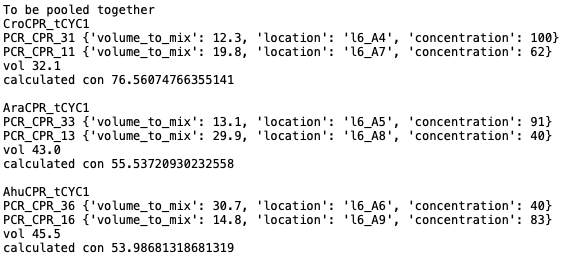

In [122]:
#The first pool of Cro Ara and Ahu
IPython.core.display.Image('ConStrain_on_google_colab/Data/interim/Fist_pool_CroAraAhu.png', width=800)

In [123]:
#Pooling of parts from previous experiemtns
#Find the amount to be pooled
amount = 0.004
pool_volumes_2 = {}
#Iterate through the amplicons and calculate the 
for amplicon in amplicons:
    if amplicon.part_name in parts_created:
        if amplicon.part_name in pool_names:
            amount = 0.003
            ind = pool_names.index(amplicon.part_name)
            vol = (pool_lengths[ind]*650*amount)/amplicon.annotations['batches'][0]['concentration']
            if amplicon.part_name in pool_volumes_2:
                pool_volumes_2[amplicon.part_name][amplicon.name] = {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}
            else:
                pool_volumes_2[amplicon.part_name] = {amplicon.name: {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}}

        #Ath is named Ara in other lists (name inconsistency)
        elif amplicon.part_name == 'AthATR1_tCYC1':
            ind = pool_names.index('AraCPR_tCYC1')
            vol = (pool_lengths[ind]*650*amount)/amplicon.annotations['batches'][0]['concentration']
            if 'AraCPR_tCYC1' in pool_volumes_2:
                pool_volumes_2['AraCPR_tCYC1'][amplicon.name] = {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}
            else:
                pool_volumes_2['AraCPR_tCYC1'] = {amplicon.name: {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}}

print("To be pooled together")
con_per_part = {}
for key in pool_volumes_2:
    print(key)
    total_vol = 0
    total_con = 0
    total_ng = 0
    for ke in pool_volumes_2[key]:
        print(ke, pool_volumes_2[key][ke])
        total_vol += pool_volumes_2[key][ke]['volume_to_mix']
        total_con +=pool_volumes_2[key][ke]['concentration']
        total_ng += pool_volumes_2[key][ke]['concentration']*pool_volumes_2[key][ke]['volume_to_mix']
    print("vol",round(total_vol,1))
    print("calculated con", total_ng/total_vol)
    ml_to_Add = total_ng/200-total_vol
    print("ul water to add", ml_to_Add)
    print("final volume",total_vol+ ml_to_Add, '\n')
    con_per_part[key] = round(total_ng/total_vol)
    total_con=0
    total_vol = 0
    total_ng=0

To be pooled together
CroCPR_tCYC1
PCR_CPR_31 {'volume_to_mix': 14.3, 'location': 'l6_C4', 'concentration': 322}
PCR_CPR_21 {'volume_to_mix': 230.6, 'location': 'l5_E05', 'concentration': 20.0}
PCR_CPR_11 {'volume_to_mix': 9.8, 'location': 'l6_C7', 'concentration': 471}
PCR_CPR_01 {'volume_to_mix': 307.4, 'location': 'l5_E03', 'concentration': 15.0}
vol 562.1
calculated con 32.811599359544566
ul water to add -469.88300000000004
final volume 92.21699999999998 

AraCPR_tCYC1
PCR_CPR_33 {'volume_to_mix': 10.8, 'location': 'l6_C5', 'concentration': 415}
PCR_CPR_23 {'volume_to_mix': 448.5, 'location': 'l5_F04', 'concentration': 10.0}
PCR_CPR_13 {'volume_to_mix': 12.1, 'location': 'l6_C8', 'concentration': 370}
PCR_CPR_03 {'volume_to_mix': 299.0, 'location': 'l5_F02', 'concentration': 15.0}
vol 770.4
calculated con 23.272326064382135
ul water to add -680.7550000000001
final volume 89.64499999999998 

AhuCPR_tCYC1
PCR_CPR_36 {'volume_to_mix': 14.5, 'location': 'l6_C6', 'concentration': 319}
P

To get a little bit lower concentration I will add water

In [124]:
##Moved down to the sencond transformation to ensure correct volume prints
#New_pools_2={'CroCPR_tCYC1':{'pool_location': 'l6_B7', 'pool_concentration':186},'AraCPR_tCYC1':{'pool_location': 'l6_B8', 'pool_concentration':205},'AhuCPR_tCYC1':{'pool_location': 'l6_B9', 'pool_concentration':234}}
##Add the new pools to the assembly dicts
#for part in New_pools_2:
#    if part in pools:
#        pools[str(part)]['pool_positions'] = New_pools_2[part]['pool_location']
#        pools[str(part)]['concentration'] = New_pools_2[part]['pool_concentration']
#


### Third transformation pool 
The second transfomration failed, and therefore more parts were needed. 

In [125]:
#From third part creation 13/09
amplicon_by_name('PCR_G8H_29', amplicons).annotations['batches'][0]['location'] = 'l6_A6'
amplicon_by_name('PCR_G8H_29', amplicons).annotations['batches'][0]['concentration'] = 281
amplicon_by_name('PCR_G8H_29', amplicons).annotations['batches'][0]['volume'] = 75

In [126]:
#Pooling of parts from previous experiemtns
parts_available = ['OeuG8H_tADH1','RsepG8H_tADH1','VminG8H_tADH1', 'AniCPR_tCYC1']
#Find the amount to be pooled

amount = 0.0015
pool_volumes_2 = {}
#pool_lengths_2 
for amplicon in amplicons:
    if amplicon.part_name in parts_available:
        if amplicon.part_name in pool_names:
            if amplicon.part_name == 'AniCPR_tCYC1':
                amount = 0.0006
            elif amplicon.part_name == 'OeuG8H_tADH1':
                amount = 0.0013
            elif amplicon.part_name == 'RsepG8H_tADH1':
                amount = 0.0015
            elif amplicon.part_name == 'VminG8H_tADH1':
                amount = 0.00087
            else:
                amount = 0.0015
            
            #Save pool volumes
            ind = pool_names.index(amplicon.part_name)
            vol = (pool_lengths[ind]*650*amount)/amplicon.annotations['batches'][0]['concentration']
            if amplicon.part_name in pool_volumes_2:
                pool_volumes_2[amplicon.part_name][amplicon.name] = {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}
            else:
                pool_volumes_2[amplicon.part_name] = {amplicon.name: {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}}

        #Ath is named Ara in other lists (name inconsistency)
        elif amplicon.part_name == 'AthATR1_tCYC1':
            ind = pool_names.index('AraCPR_tCYC1')
            vol = (pool_lengths[ind]*650*amount)/amplicon.annotations['batches'][0]['concentration']
            if 'AraCPR_tCYC1' in pool_volumes_2:
                pool_volumes_2['AraCPR_tCYC1'][amplicon.name] = {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}
            else:
                pool_volumes_2['AraCPR_tCYC1'] = {amplicon.name: {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}}

print("To be pooled together")
con_per_part = {}
for key in pool_volumes_2:
    print(key)
    total_vol = 0
    total_con = 0
    total_ng = 0
    for ke in pool_volumes_2[key]:
        print(ke, pool_volumes_2[key][ke])
        total_vol += pool_volumes_2[key][ke]['volume_to_mix']
        total_con +=pool_volumes_2[key][ke]['concentration']
        total_ng += pool_volumes_2[key][ke]['concentration']*pool_volumes_2[key][ke]['volume_to_mix']
    print("vol",round(total_vol,1))
    print("calculated con", total_ng/total_vol, '\n')
    con_per_part[key] = round(total_ng/total_vol)
    total_con=0
    total_vol = 0
    total_ng=0

To be pooled together
RsepG8H_tADH1
PCR_G8H_09 {'volume_to_mix': 32.7, 'location': 'l5_B02', 'concentration': 55.0}
PCR_G8H_10 {'volume_to_mix': 36.0, 'location': 'l5_B03', 'concentration': 50.0}
vol 68.7
calculated con 52.379912663755455 

VminG8H_tADH1
PCR_G8H_01 {'volume_to_mix': 26.1, 'location': 'l5_A03', 'concentration': 40.0}
PCR_G8H_02 {'volume_to_mix': 23.2, 'location': 'l5_A04', 'concentration': 45.0}
vol 49.3
calculated con 42.352941176470594 

OeuG8H_tADH1
PCR_G8H_29 {'volume_to_mix': 5.5, 'location': 'l6_A6', 'concentration': 281}
PCR_G8H_30 {'volume_to_mix': 34.6, 'location': 'l5_D05', 'concentration': 45.0}
vol 40.1
calculated con 77.36907730673316 

AniCPR_tCYC1
PCR_CPR_37 {'volume_to_mix': 30.0, 'location': 'l5_H03', 'concentration': 30.0}
PCR_CPR_27 {'volume_to_mix': 30.0, 'location': 'l5_H02', 'concentration': 30.0}
PCR_CPR_17 {'volume_to_mix': 30.0, 'location': 'l5_H01', 'concentration': 30.0}
PCR_CPR_07 {'volume_to_mix': 30.0, 'location': 'l5_G09', 'concentration':

In [127]:
#From part creation 13/09
amplicon_by_name('PCR_PRO_01', amplicons).annotations['batches'][0]['location'] = 'l6_D1'
amplicon_by_name('PCR_PRO_01', amplicons).annotations['batches'][0]['concentration'] = 147
amplicon_by_name('PCR_PRO_01', amplicons).annotations['batches'][0]['volume'] = 75


amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['location'] = 'l6_D2'
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['concentration'] = 122
amplicon_by_name('PCR_PRO_02', amplicons).annotations['batches'][0]['volume'] = 75


amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['location'] = 'l6_B3'
amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['concentration'] = 170
amplicon_by_name('PCR_PRO_04', amplicons).annotations['batches'][0]['volume'] = 75


amplicon_by_name('PCR_PRO_06', amplicons).annotations['batches'][0]['location'] = 'l6_B4'
amplicon_by_name('PCR_PRO_06', amplicons).annotations['batches'][0]['concentration'] = 206
amplicon_by_name('PCR_PRO_06', amplicons).annotations['batches'][0]['volume'] = 75

In [128]:
#promoter information and pools
promoters_amounts_total = 0.001*4 
promoter_names = ('PCR_PRO_01','PCR_PRO_02','PCR_PRO_04','PCR_PRO_06')
promoter_parts_amounts_total = {k: v for (k, v) in zip(promoter_names,[promoters_amounts_total/4]*len(promoter_names))}
promoters = [amplicon_by_name(name,amplicons) for name in promoter_names]

print("Promoter pool")
print("name, volume, concentration, location")
volumes = []
ngs = []
for amp in promoters:
    w_moles = promoter_parts_amounts_total[amp.name]
    w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
    act_conc = amp.annotations['batches'][0]['concentration']
    w_volume = wanted_volume(w_mass, act_conc)*10
    volumes.append(w_volume)
    ngs.append(w_volume * act_conc)
    print(amp.name, round(w_volume), act_conc, '\t', amp.annotations['batches'][0]['location'])

    
total_vol = sum(volumes)
total_ngs = sum(ngs)
total_conc_prom = total_ngs/total_vol
print('total volume: ', sum(volumes))
print()
print('total ngs: ', sum(ngs))
print('total conc: ', total_conc)

Promoter pool
name, volume, concentration, location
PCR_PRO_01 46 147 	 l6_D1
PCR_PRO_02 55 122 	 l6_D2
PCR_PRO_04 40 170 	 l6_B3
PCR_PRO_06 33 206 	 l6_B4
total volume:  174.0

total ngs:  27070.0
total conc:  90.97315436241611


In [129]:
#From Part Creation 13/09
amplicon_by_name('PCR_TRP1-DW_01', amplicons).annotations['batches'][0]['location'] = 'l6_D3'
amplicon_by_name('PCR_TRP1-DW_01', amplicons).annotations['batches'][0]['concentration'] = 240
amplicon_by_name('PCR_TRP1-DW_01', amplicons).annotations['batches'][0]['volume'] = 75

amplicon_by_name('PCR_TRP1-DW_02', amplicons).annotations['batches'][0]['location'] = 'l6_D4'
amplicon_by_name('PCR_TRP1-DW_02', amplicons).annotations['batches'][0]['concentration'] = 61
amplicon_by_name('PCR_TRP1-DW_02', amplicons).annotations['batches'][0]['volume'] = 75

amplicon_by_name('PCR_UP_tADH1_01', amplicons).annotations['batches'][0]['location'] = 'l6_D5'
amplicon_by_name('PCR_UP_tADH1_01', amplicons).annotations['batches'][0]['concentration'] = 82
amplicon_by_name('PCR_UP_tADH1_01', amplicons).annotations['batches'][0]['volume'] = 75

In [130]:
#pool new up and dw and trp
updw_amount = 0.001
updw_names = ('PCR_UP_tADH1_01', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02')
updw_parts_amounts_total = {k: v for (k, v) in zip(updw_names,[updw_amount]*len(updw_names))}
updw = [amplicon_by_name(name,amplicons) for name in updw_names]

n=10
print("\n", n," amount")
print("name, volume, concentration, location")
volumes = []
ngs = []
for amp in updw:
    w_moles = updw_parts_amounts_total[amp.name]
    w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
    act_conc = amp.annotations['batches'][0]['concentration']
    w_volume = wanted_volume(w_mass, act_conc)*n
    volumes.append(w_volume)
    ngs.append(w_volume * act_conc)
    print(amp.name, round(w_volume), act_conc, '\t', amp.annotations['batches'][0]['location'])

    
total_vol = sum(volumes)
total_ngs = sum(ngs)
total_conc_prom = total_ngs/total_vol
print()
for i in range(len(updw_names)):
    print(updw_names[i], 'con', ngs[i]/total_vol)
    
print(total_vol)



 10  amount
name, volume, concentration, location
PCR_UP_tADH1_01 48 82 	 l6_D5
PCR_TRP1-DW_01 39 240 	 l6_D3
PCR_TRP1-DW_02 64 61 	 l6_D4

PCR_UP_tADH1_01 con 26.066225165562916
PCR_TRP1-DW_01 con 61.98675496688742
PCR_TRP1-DW_02 con 25.85430463576159
151.0


In [131]:
##THis part has been moved down to the third transformation to not mess up the prints 
#New_pools_3={'XI-2_DW':{'pool_location': 'l6_B6', 'pool_concentration':25},'Promoters_pool':{'pool_location': 'l6_B5', 'pool_concentration':163},'VminG8H_tADH1':{'pool_location': 'l6_D8', 'pool_concentration':45},'RsepG8H_tADH1':{'pool_location': 'l6_D7', 'pool_concentration':61},'OeuG8H_tADH1':{'pool_location': 'l6_D6', 'pool_concentration':83},'AniCPR_tCYC1':{'pool_location': 'l6_D9', 'pool_concentration':32}}#Add the new pools to the assembly dicts
#for part in New_pools_3:
#    if part in pools:
#        pools[str(part)]['pool_positions'] = New_pools_3[part]['pool_location']
#        pools[str(part)]['concentration'] = New_pools_3[part]['pool_concentration']
#
#

# 6. Assemblies

The following will simulate the assemblies through homologous recombiantion.

In [132]:
#Create a list of parts to be used
cro_strain_batches={'entity_name':[],'Bases':[], 'Box_barcode':[], 'position':[],'volume':[], 'volume unit':[],'concentration':[], 'concentration unit':[] }

for name in pool_names:
    cro_strain_batches['entity_name'].append(name)
    cro_strain_batches['Bases'].append(pools[name]['pool_bases'])
    cro_strain_batches['Box_barcode'].append('81BOX827')
    cro_strain_batches['position'].append(pools[name]['pool_positions'])
    cro_strain_batches['volume'].append(pools[name]['pool_volumes'])
    cro_strain_batches[ 'volume unit'].append('ul')
    cro_strain_batches['concentration'].append(pools[name]['concentration'])
    cro_strain_batches['concentration unit'].append('ng/ul')
cro_strain_batches = pd.DataFrame.from_dict(cro_strain_batches)

In [133]:
cro_strain_batches

,entity_name,Bases,Box_barcode,position,volume,volume unit,concentration,concentration unit
0,VminG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l4_D01,100,ul,49.000,ng/ul
1,SmusG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_E05,100,ul,54.000,ng/ul
2,RsepG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_E03,100,ul,56.000,ng/ul
3,CroG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,G3,100,ul,144.600,ng/ul
4,OeuG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_E04,100,ul,42.000,ng/ul
5,CroCPR_tCYC1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,G7,100,ul,141.500,ng/ul
6,AanCPR_tCYC1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_E06,100,ul,43.000,ng/ul
7,AraCPR_tCYC1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,G9,100,ul,111.700,ng/ul
8,CloCPR_tCYC1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_I08,100,ul,35.000,ng/ul
9,RseCPR_tCYC1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,l5_C09,100,ul,34.000,ng/ul


In [134]:
#Extract the names from list and sequences from benchling
cro_UP_names       = pool_names[13:14]
cro_G8H_names      = pool_names[0:5]
cro_CPR_names      = pool_names[5:12]
cro_marker_names   = pool_names[15:16]
cro_DW_names       = pool_names[14:15]
cro_promoter_names = pool_names[12:13]

cro_marker_names

['cTRP1']

In [135]:
# Homologs
pool_G8H_sites = [site for name in cro_G8H_names for site in G8H_sites if name in site.name]
pool_CPR_sites = [site for name in cro_CPR_names for site in CPR_sites if name in site.name]

# promotes
pool_promoter_sites = pool_promoter_sites = [SeqIO.read('ConStrain_on_google_colab/Data/promoter_sequences/pooled_promoters.fasta', 'fasta')]

# UP, DW, marker
pool_UP_sites = UP_sites    #[site for name in cro_UP_names for site in UP_sites if name in site.name]
pool_DW_sites = DW_sites    #[site for name in cro_DW_names for site in DW_sites if name in site.name]
pool_marker_sites = marker_sites


In [136]:
#Create a list of fragments within a list of parts.
pool_fragment_list = [pool_UP_sites,pool_G8H_sites,pool_promoter_sites,pool_CPR_sites,pool_marker_sites,pool_DW_sites]

#The number of fragments to be assembled
pool_no_frags = len(pool_fragment_list)
print("Number of fragments:", pool_no_frags)

#The number of parts of each fragment
pool_no_parts = [len(l) for l in pool_fragment_list]
print("Number of parts: ",pool_no_parts)

#The number of possible combinations
pool_no_combs = multiply_list(pool_no_parts)
print("Number of possible combinations:",pool_no_combs)

#How many repitions are needed?
pool_repetition_list = [int(pool_no_comb/pool_no_part) for pool_no_comb, pool_no_part in zip([pool_no_combs]*len(pool_no_parts),pool_no_parts)]
print("The number of time each fragment must be repeated:", pool_repetition_list)

times_needed = {}
for frag_list, rep in zip(pool_fragment_list, pool_repetition_list):
    for frag in frag_list:
        times_needed.update({frag.name : rep})


#Matrix with all combinations
print("\nCombinations:")
pool_combinations_matrix = [t for t in itertools.product(*pool_fragment_list)]
for row in pool_combinations_matrix:
    names = []
    for element in row:
        names.append(element.name)
    print(names)

Number of fragments: 6
Number of parts:  [1, 5, 1, 7, 1, 1]
Number of possible combinations: 35
The number of time each fragment must be repeated: [35, 7, 35, 5, 35, 35]

Combinations:
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'CroCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'AanCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'AraCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'CloCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'RseCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'AhuCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'VminG8H_tADH1', 'seq_3bqXE4zg', 'AniCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'SmusG8H_tADH1', 'seq_3bqXE4zg', 'CroCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'SmusG8H_tADH1', 'seq_3bqXE4zg', 'AanCPR_tCYC1', 'seq_3HMRtcpy', 'DW_XI-2']
['UP_XI-2', 'SmusG8H_tA

The reason for CPR fist in the list was because CPRs were the missing part and to easen the division, the setup was changed. 

In [137]:
#Save pool names and then create reaction names
pool_assembly_names       = ["MIA-HA-" + str(i+111) for i in range(0,len(pool_combinations_matrix))]
pool_assembly_names_short = ["HA" + str(i+111) for i in range(0,len(pool_combinations_matrix))]
reaction_names = pool_assembly_names_short + ['n.ctr','p.ctr','p.ctr']

In [138]:
#Define what to add to each reaction
reaction_participants = []
for row in pool_combinations_matrix:
    temp = []
    for ele in row:
        temp.append(ele)
    temp.append(pgRNA)
    reaction_participants.append(temp)

#The control mixes
reaction_participants.append([pgRNA, TRP_plasmid]) # n.ctr
reaction_participants.append([URA_plasmid, TRP_plasmid]) #p.ctr
reaction_participants.append([])  #p.ctr

#Define the media for each transformant
media = ['SC-UT'] * len(pool_assembly_names)
media = media + ['SC-UT'] * 2 # controls
media = media + ['YPD'] # controls

In [139]:
for annotation in reaction_participants: 
    for p in annotation: 
        p.annotations['batches'] = [{'location'    :'reactions_box',
                                     'volume'       : 100,
                                     'concentration': 100}]

In [140]:
# to allow UP, DW and TRP to still be in the matrix, they al got the same location, and only one of them with a low concentration. The high concentration facilitate a volume print of 0.
for part in reaction_participants:
    for p in part:
        if p.name == 'XI-2_UP':
            p.annotations['batches'][0]['concentration'] = 11
            p.annotations['batches'][0]['position'] = 'I9'
        elif p.name == 'cTRP1' or p.name == 'XI-2_DW':
            p.annotations['batches'][0]['position'] = 'I9'
            p.annotations['batches'][0]['concentration'] = 1000000 #as this is a part of XI-2_UP
        elif p.name in pools:
            p.annotations['batches'][0]['position'] = pools[p.name]['pool_positions']
            p.annotations['batches'][0]['concentration'] = pools[p.name]['concentration'] 
            

In [141]:
#Print to check con
for part in reaction_participants:
    for p in part:
        print(p.name, p.annotations['batches'][0]['concentration'])

UP_XI-2 100
VminG8H_tADH1 49
seq_3bqXE4zg 100
CroCPR_tCYC1 141.5
seq_3HMRtcpy 100
DW_XI-2 100
pESC-URA-gRNA_XI2-2 100
UP_XI-2 100
VminG8H_tADH1 49
seq_3bqXE4zg 100
AanCPR_tCYC1 43
seq_3HMRtcpy 100
DW_XI-2 100
pESC-URA-gRNA_XI2-2 100
UP_XI-2 100
VminG8H_tADH1 49
seq_3bqXE4zg 100
AraCPR_tCYC1 111.7
seq_3HMRtcpy 100
DW_XI-2 100
pESC-URA-gRNA_XI2-2 100
UP_XI-2 100
VminG8H_tADH1 49
seq_3bqXE4zg 100
CloCPR_tCYC1 35
seq_3HMRtcpy 100
DW_XI-2 100
pESC-URA-gRNA_XI2-2 100
UP_XI-2 100
VminG8H_tADH1 49
seq_3bqXE4zg 100
RseCPR_tCYC1 34
seq_3HMRtcpy 100
DW_XI-2 100
pESC-URA-gRNA_XI2-2 100
UP_XI-2 100
VminG8H_tADH1 49
seq_3bqXE4zg 100
AhuCPR_tCYC1 120.2
seq_3HMRtcpy 100
DW_XI-2 100
pESC-URA-gRNA_XI2-2 100
UP_XI-2 100
VminG8H_tADH1 49
seq_3bqXE4zg 100
AniCPR_tCYC1 131.2
seq_3HMRtcpy 100
DW_XI-2 100
pESC-URA-gRNA_XI2-2 100
UP_XI-2 100
SmusG8H_tADH1 54
seq_3bqXE4zg 100
CroCPR_tCYC1 141.5
seq_3HMRtcpy 100
DW_XI-2 100
pESC-URA-gRNA_XI2-2 100
UP_XI-2 100
SmusG8H_tADH1 54
seq_3bqXE4zg 100
AanCPR_tCYC1 43
seq

In [142]:
pcr_volumes(vol_p_reac = 360, 
        no_of_reactions = 23,
        standard_reagents = ["PEG", "LiAc_1M", "ssDNA", "water_dna"],
        standard_volumes = [240, 36, 10, 74])

,vol_p_reac,vol_p_23_reac
PEG,240.0,5520.0
LiAc_1M,36.0,828.0
ssDNA,10.0,230.0
water_dna,74.0,1702.0
Total,360.0,8280.0


In [143]:
from constrain.lab.transformation import transformation_mix

In [144]:
#First transfomration print: choose AniCPR, AanCPR, CloCPR, RseCPR
transf_idx_1 = list(range(5,10)) + list(range(15,25)) + list(range(30,38))
reaction_names_1 = [reaction_names[i] for i in transf_idx_1]
reaction_participants_1 = [reaction_participants[i] for i in transf_idx_1]

#Calculate amounts needed
amnt = 0.0005
wanted_amounts_1 = [[] for i in range(len(reaction_participants_1))]
names_matrix_1 = [[] for i in range(len(reaction_participants_1))]
for reac_no, reac in enumerate(reaction_participants_1):
    for parti_no, parti in enumerate(reac):
        names_matrix_1[reac_no].append(parti.name)
        if parti.name == 'pESC-URA-gRNA_XI2-2':
            wanted_amounts_1[reac_no].append(amnt/2)
        elif parti.name =='Promoters_pool':
            wanted_amounts_1[reac_no].append(0.00098)
        else:
            wanted_amounts_1[reac_no].append(amnt)
media_1 = [media[i] for i in transf_idx_1]

len(wanted_amounts_1)
len(reaction_participants_1)
wanted_amounts_1

[[0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.00025],
 [0.0005, 0.0005, 0.0005, 0.0005, 0.0005

In [145]:
itemDict = {}
for i in range(len(reaction_participants_1)): 
    for j in range(len(reaction_participants_1[i])):
        itemDict[reaction_participants_1[i][j].name]= wanted_amounts_1[i][j]
        
itemDict

{'UP_XI-2': 0.0005,
 'VminG8H_tADH1': 0.0005,
 'seq_3bqXE4zg': 0.0005,
 'AhuCPR_tCYC1': 0.0005,
 'seq_3HMRtcpy': 0.0005,
 'DW_XI-2': 0.0005,
 'pESC-URA-gRNA_XI2-2': 0.00025,
 'AniCPR_tCYC1': 0.0005,
 'SmusG8H_tADH1': 0.0005,
 'CroCPR_tCYC1': 0.0005,
 'AanCPR_tCYC1': 0.0005,
 'AraCPR_tCYC1': 0.0005,
 'RsepG8H_tADH1': 0.0005,
 'CloCPR_tCYC1': 0.0005,
 'RseCPR_tCYC1': 0.0005,
 'CroG8H_tADH1': 0.0005,
 'OeuG8H_tADH1': 0.0005,
 'pL_01_C2_(pRS414-TRP)': 0.0005,
 'pL_01_C4_(pRS416-URA)': 0.0005}

In [146]:
#print each transformation DNA mix
transf_names_1 = transformation_mix(reaction_names_1, reaction_participants_1, wanted_amounts = itemDict, water_dna_p_reac = 74, media = media_1)
transf_names_1 = transf_names_1.set_index([pd.Index([str(ID + 1) for ID in transf_idx_1])])
transf_names_1

,name,UP_XI-2,VminG8H_tADH1,seq_3bqXE4zg,AhuCPR_tCYC1,seq_3HMRtcpy,DW_XI-2,pESC-URA-gRNA_XI2-2,AniCPR_tCYC1,SmusG8H_tADH1,...,AraCPR_tCYC1,RsepG8H_tADH1,CloCPR_tCYC1,RseCPR_tCYC1,CroG8H_tADH1,OeuG8H_tADH1,pL_01_C2_(pRS414-TRP),pL_01_C4_(pRS416-URA),water,plate on
6,HA116,1.8,12.0,3.4,6.3,4.6,1.8,12.7,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.4,SC-UT
7,HA117,1.8,12.0,3.4,NaN,4.6,1.8,12.7,5.6,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.1,SC-UT
8,HA118,1.8,NaN,3.4,NaN,4.6,1.8,12.7,NaN,10.9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.5,SC-UT
9,HA119,1.8,NaN,3.4,NaN,4.6,1.8,12.7,NaN,10.9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21.4,SC-UT
10,HA120,1.8,NaN,3.4,NaN,4.6,1.8,12.7,NaN,10.9,...,6.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.2,SC-UT
16,HA126,1.8,NaN,3.4,NaN,4.6,1.8,12.7,NaN,NaN,...,NaN,10.5,NaN,NaN,NaN,NaN,NaN,NaN,21.8,SC-UT
17,HA127,1.8,NaN,3.4,NaN,4.6,1.8,12.7,NaN,NaN,...,6.6,10.5,NaN,NaN,NaN,NaN,NaN,NaN,32.6,SC-UT
18,HA128,1.8,NaN,3.4,NaN,4.6,1.8,12.7,NaN,NaN,...,NaN,10.5,21.6,NaN,NaN,NaN,NaN,NaN,17.6,SC-UT
19,HA129,1.8,NaN,3.4,NaN,4.6,1.8,12.7,NaN,NaN,...,NaN,10.5,NaN,22.3,NaN,NaN,NaN,NaN,16.9,SC-UT
20,HA130,1.8,NaN,3.4,6.3,4.6,1.8,12.7,NaN,NaN,...,NaN,10.5,NaN,NaN,NaN,NaN,NaN,NaN,32.9,SC-UT


In [147]:
#Print sum of all needed parts. 
transf_names_1.sum(numeric_only = True)

UP_XI-2                   36.0
VminG8H_tADH1             24.0
seq_3bqXE4zg              68.0
AhuCPR_tCYC1              18.9
seq_3HMRtcpy              92.0
DW_XI-2                   36.0
pESC-URA-gRNA_XI2-2      266.7
AniCPR_tCYC1              16.8
SmusG8H_tADH1             32.7
CroCPR_tCYC1              10.6
AanCPR_tCYC1              52.2
AraCPR_tCYC1              26.4
RsepG8H_tADH1             63.0
CloCPR_tCYC1              64.8
RseCPR_tCYC1              44.6
CroG8H_tADH1              15.2
OeuG8H_tADH1              70.0
pL_01_C2_(pRS414-TRP)     31.2
pL_01_C4_(pRS416-URA)     15.9
water                    717.0
dtype: float64

### 6.1 Protocol
Incubated 4 * 40 ul in 4 * 20 ml ypd, and 4*4 ul from that in 80 ml ypd. This time it was taken from the stock plate. 

#### Yeast transformation

Prepare cells
- Day 1: Streak relevant strain on plate: (YPD)

- Day 2: Inoculate starter culture:
    - Tag 160 ul, masser af celler -> 80 ml
    - Tag 16 derfra > bland med 80 ml
    
- Day 3: 
    - Inoculate main from starter culture to OD 0.3 & incubate to 1<OD<1.5      5 ml main cult. / transf.
    - I do it around  0.5

PREP trans mix and parts mixes

1.	Inoculate main culture			 	(50 ml YPD; > 4 h; OD=0.3 to 1<OD<1.5)
2.	Wash cells 
1.	Pellet cells & discard fluid 		(5 min; 5000 g)
2.	Add M.Q. H2O – spin – remove  (samme mægnde som medie, 5min 5000
3.	Add M.Q. H2O – spin – remove  (samme mægnde som medie, 5min 5000
4.	add a little whater, resuspend, gently and mix all cells
5.	transfer to 14 ml falcon – 14 ml h2o - 5min 5000g
6.	trasnformation mix (vol prreaction all) resuspend (vortex
7.	take 286 ul and add to the eppedofr with dna
3.	Incubate				(45 min at 42 ᵒC)
4.	11000 g i 1 min – remove liquid (sug)
5.	dillute om 90 ul water
6.	plate on SC-UT


#### Notes:
The cells grew pooly over night. OD at 0,275 at 7:30. Talked to Emil who said that they don't grow well when you have a large amount of media at innocultion (they grow better when they can sense each other). They like to be close to each other. - I might have uinnoculated the same amount of cells as we would normally innoculate for 10 ml. That might explain the low OD. 
Instead, innoculate 0,5 ml the day before, add 5 ml, and wait 4 hours (unles they dont grow a lot, wait more)
Now I will wait approx 4 h. and see how the cells are. 


at 12:30 (check paper) it was 0,157*4=0,628
Beata said that 0.8 is actually a good OD. Therefore I should just transform and use all the liquid I have.  

at 13:56 OD was 0.226*4=0.9


OD at trans time: 0.245*4 = 0.98. 
Incubated at 17:30
There were a lot of cells mixed with the transfomration mix. Tried to suspend it but there were some small clumbs. Ended up transofmring with 3,6 ml pr trnas

80 ml for 22, did not transform 35 because there was not enough. 

In [148]:
from constrain.lab.transformation import ODtime

In [149]:
# What's the doubling time?
ODtime(initialOD = 0.275, time = 6.5, td = 0.307)

1.097

In [150]:
# What's the doubling time?
ODtime(initialOD = 0.628, time = 1.5, td = 0.307)

0.864

Pictures taken the 6th of september 2021

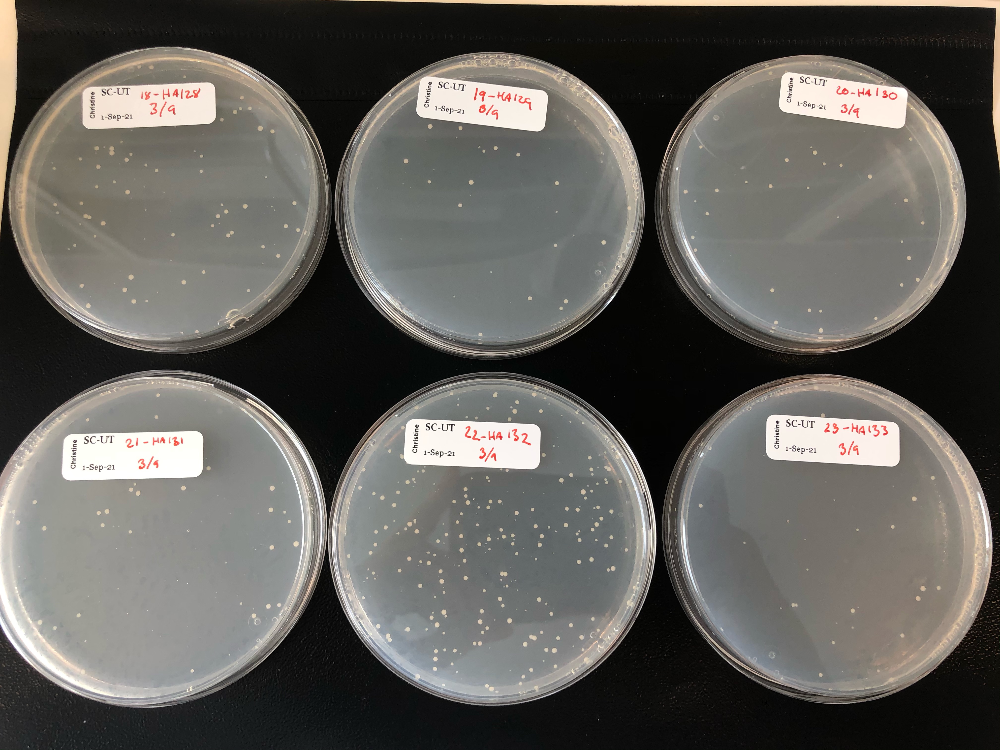

In [151]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09-03_18-23.jpeg', width=600)

A possible explanation for the hight n.ctr could be that we add the trp in a plasmid, so they will be able to survive if they either make non homologus end joining or if they are never cut. If we have way to many cells pr gRNA, then these will never be cut, and then they will be able to survive, since we still have ura in the plasmid. 

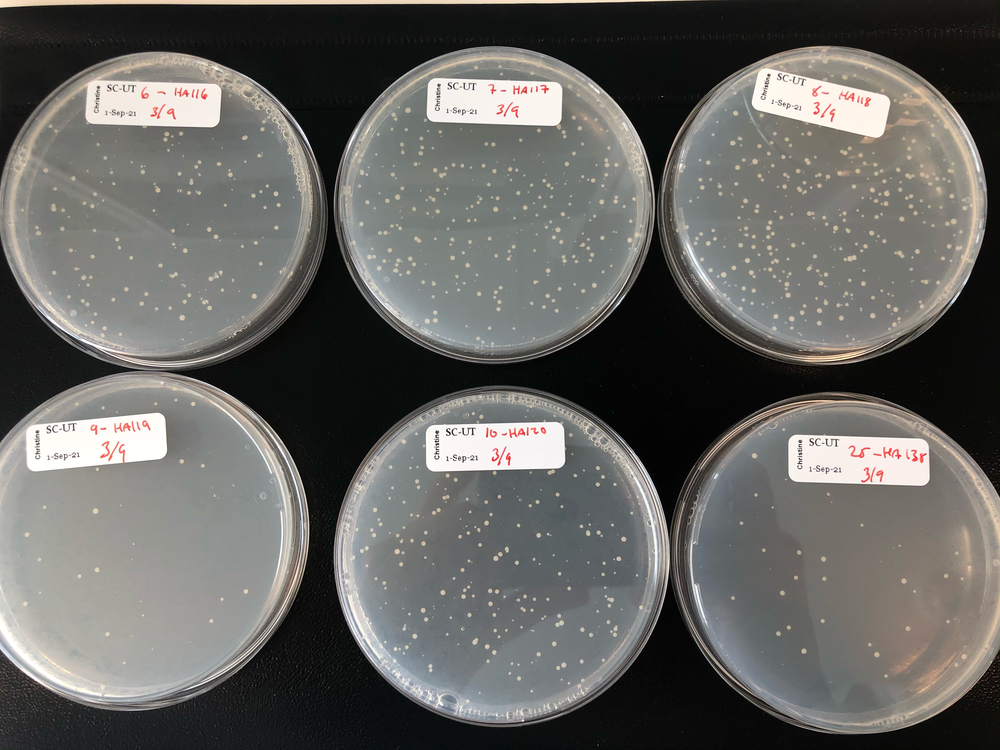

In [152]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09-03_6-10_25.jpeg', width=600)

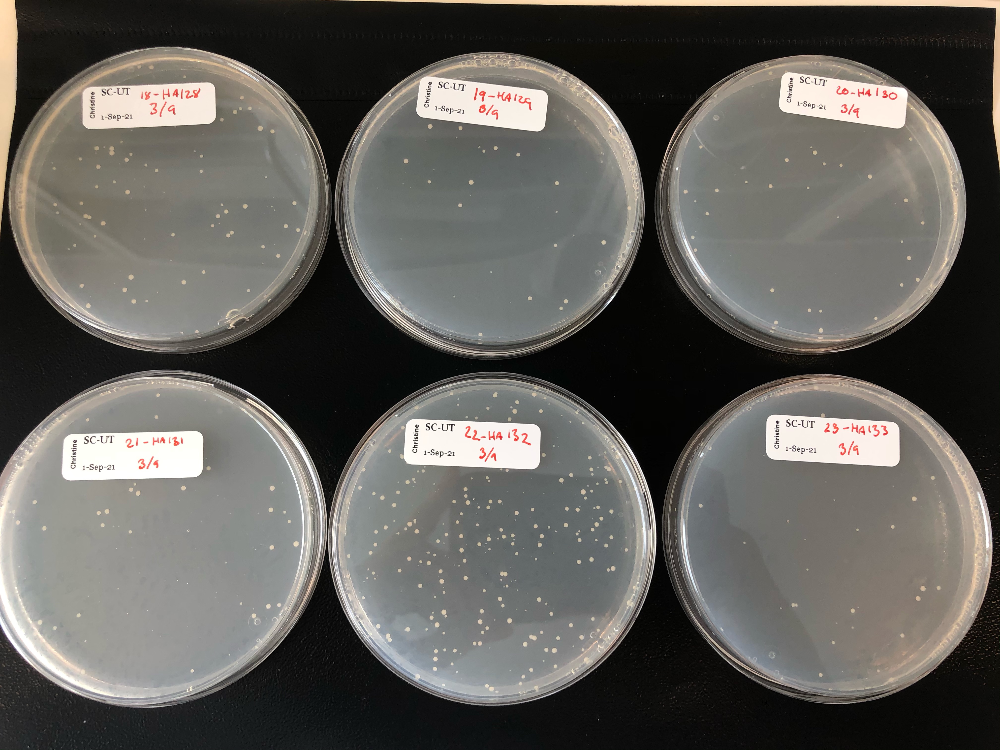

In [153]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09-03_18-23.jpeg', width=600)

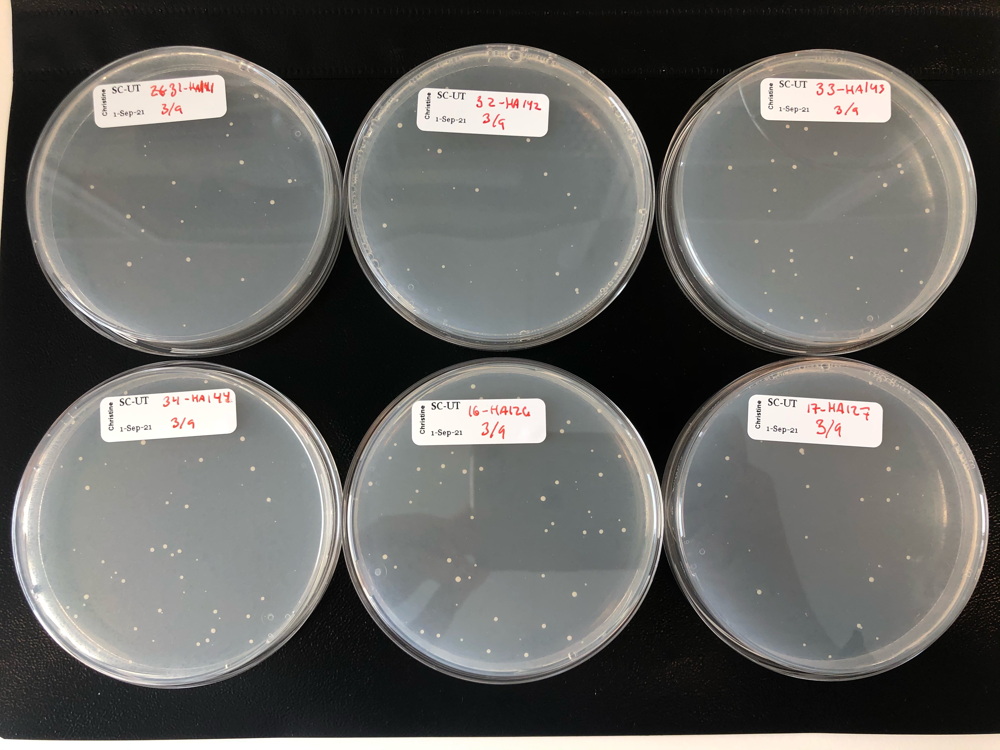

In [154]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09-03_31-34_16-17.jpeg', width=600)

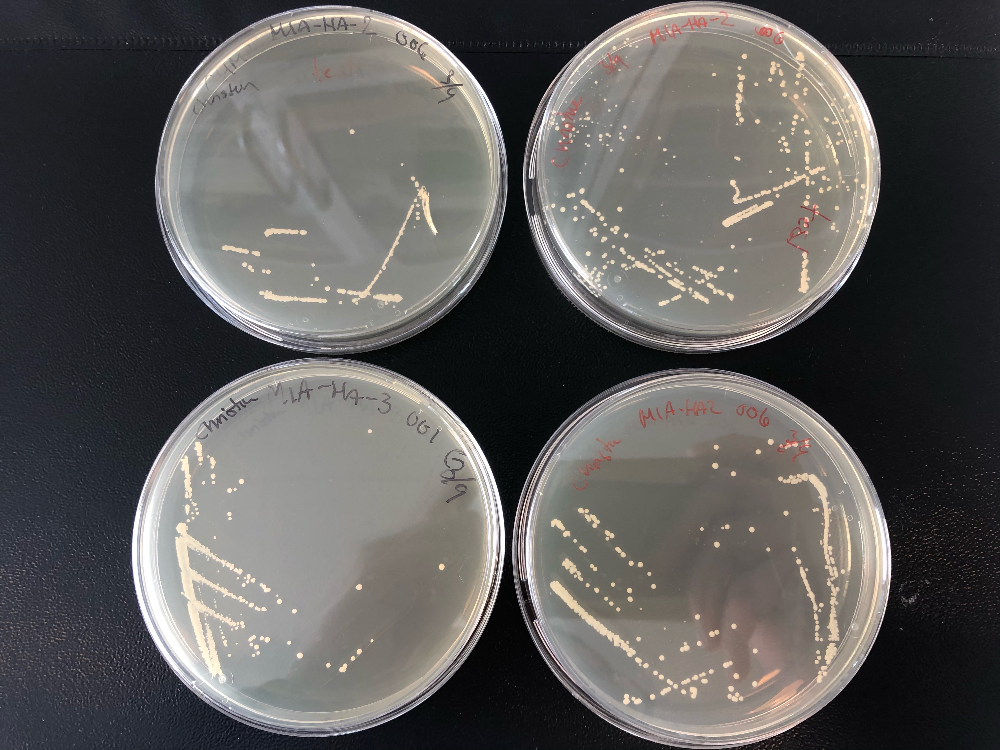

In [155]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09-03_restreat_HA2HA3.jpeg', width=600)

All gRNA plasmid was used, and a new batch was made. Promoters are pooled again.
the parts were pooled, but Ara suddently had very low amounts

In [156]:
#information regardingpools made for the second transformation
New_pools_2={'pESC-URA-gRNA_XI2-2':{'pool_location': 'p1_B1', 'pool_concentration':205},'pL_01_C4_(pRS416-URA)':{'pool_location': 'orange', 'pool_concentration':200},'pL_01_C2_(pRS414-TRP)':{'pool_location': 'orange', 'pool_concentration':190},'CroCPR_tCYC1':{'pool_location': 'l6_B7', 'pool_concentration':186},'AraCPR_tCYC1':{'pool_location': 'l6_B8', 'pool_concentration':205},'AhuCPR_tCYC1':{'pool_location': 'l6_B9', 'pool_concentration':234}}

#Add the new pools to the assembly dicts
for part in reaction_participants:
    for p in part:
        if p.name in New_pools_2:
            p.annotations['batches'][0]['concentration'] = New_pools_2[p.name]['pool_concentration']
            p.annotations['batches'][0]['position'] = New_pools_2[p.name]['pool_location']
        elif p.name == 'XI-2_UP':
            p.annotations['batches'][0]['concentration'] = 11
            p.annotations['batches'][0]['position'] = 'I9'
        elif p.name == 'cTRP1' or p.name == 'XI-2_DW':
            p.annotations['batches'][0]['position'] = 'I9'
            p.annotations['batches'][0]['concentration'] = 1000000 #as this is a part of XI-2_UP
        elif p.name == 'Promoters_pool':
            p.annotations['batches'][0]['concentration'] = 83 #as this is a part of XI-2_UP

     


### 6.2 Update locations

In [157]:
#Print locations and concentrations
seen = []
for part in reaction_participants:
    for p in part:
        if p.name not in seen:
            #print( p.name,'\t',p.annotations['batches'][0]['concentration'],'\t', p.annotations['batches'][0]['position'])
            seen.append(p.name)

In [158]:
#Second transfomration
transf_idx_2 = list(range(0,5)) + list(range(10,15)) + list(range(25,30))+list(range(34,38))
reaction_names_2 = [reaction_names[i] for i in transf_idx_2]
reaction_participants_2 = [reaction_participants[i] for i in transf_idx_2]

#Calculate amounts needed
amnt = 0.0005
wanted_amounts_2 = [[] for i in range(len(reaction_participants_2))]
names_matrix_2 = [[] for i in range(len(reaction_participants_2))]
for reac_no, reac in enumerate(reaction_participants_2):
    for parti_no, parti in enumerate(reac):
        names_matrix_2[reac_no].append(parti.name)
        if parti.name == 'pESC-URA-gRNA_XI2-2':
            wanted_amounts_2[reac_no].append(amnt/2)
        elif parti.name =='Promoters_pool':
            wanted_amounts_2[reac_no].append(0.0012)
        else:
            wanted_amounts_2[reac_no].append(amnt)
media_2 = [media[i] for i in transf_idx_2]


In [159]:
#itemDict = {name: item for item in wanted_amounts_1 for name in reaction_participants_1 }
itemDict1 = {}
for i in range(len(reaction_participants_2)): 
    for j in range(len(reaction_participants_2[i])):
        #print(name.name)
        itemDict1[str(reaction_participants_2[i][j].name)]= float(wanted_amounts_2[i][j])
        #print(float(wanted_amounts_2[i][j]))
        
itemDict1

{'UP_XI-2': 0.0005,
 'VminG8H_tADH1': 0.0005,
 'seq_3bqXE4zg': 0.0005,
 'CroCPR_tCYC1': 0.0005,
 'seq_3HMRtcpy': 0.0005,
 'DW_XI-2': 0.0005,
 'pESC-URA-gRNA_XI2-2': 0.00025,
 'AanCPR_tCYC1': 0.0005,
 'AraCPR_tCYC1': 0.0005,
 'CloCPR_tCYC1': 0.0005,
 'RseCPR_tCYC1': 0.0005,
 'SmusG8H_tADH1': 0.0005,
 'AhuCPR_tCYC1': 0.0005,
 'AniCPR_tCYC1': 0.0005,
 'RsepG8H_tADH1': 0.0005,
 'CroG8H_tADH1': 0.0005,
 'OeuG8H_tADH1': 0.0005,
 'pL_01_C2_(pRS414-TRP)': 0.0005,
 'pL_01_C4_(pRS416-URA)': 0.0005}

In [160]:
#Print transfomation DNA mixes
transf_names_2 = transformation_mix(reaction_names_2, reaction_participants_2, wanted_amounts = itemDict1, water_dna_p_reac = 74, media = media_2)
#transf_names_2 = transf_names_2.set_index([pd.Index([str(ID + 1) for ID in transf_idx_2])])

In [161]:
transf_names_2

,name,UP_XI-2,VminG8H_tADH1,seq_3bqXE4zg,CroCPR_tCYC1,seq_3HMRtcpy,DW_XI-2,pESC-URA-gRNA_XI2-2,AanCPR_tCYC1,AraCPR_tCYC1,...,SmusG8H_tADH1,AhuCPR_tCYC1,AniCPR_tCYC1,RsepG8H_tADH1,CroG8H_tADH1,OeuG8H_tADH1,pL_01_C2_(pRS414-TRP),pL_01_C4_(pRS416-URA),water,plate on
0,HA111,1.8,12.0,3.4,4.1,4.6,1.8,6.2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.1,SC-UT
1,HA112,1.8,12.0,3.4,NaN,4.6,1.8,6.2,17.4,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26.8,SC-UT
2,HA113,1.8,12.0,3.4,NaN,4.6,1.8,6.2,NaN,3.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.6,SC-UT
3,HA114,1.8,12.0,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,22.6,SC-UT
4,HA115,1.8,12.0,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21.9,SC-UT
5,HA121,1.8,NaN,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,10.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23.7,SC-UT
6,HA122,1.8,NaN,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,10.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23.0,SC-UT
7,HA123,1.8,NaN,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,10.9,3.2,NaN,NaN,NaN,NaN,NaN,NaN,42.1,SC-UT
8,HA124,1.8,NaN,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,10.9,NaN,5.6,NaN,NaN,NaN,NaN,NaN,39.7,SC-UT
9,HA125,1.8,NaN,3.4,4.1,4.6,1.8,6.2,NaN,NaN,...,NaN,NaN,NaN,10.5,NaN,NaN,NaN,NaN,41.6,SC-UT


In [162]:
#Print vol needed of all parts
transf_names_2.sum(numeric_only = True)

UP_XI-2                   28.8
VminG8H_tADH1             60.0
seq_3bqXE4zg              54.4
CroCPR_tCYC1              12.3
seq_3HMRtcpy              73.6
DW_XI-2                   28.8
pESC-URA-gRNA_XI2-2      105.4
AanCPR_tCYC1              34.8
AraCPR_tCYC1               3.6
CloCPR_tCYC1              43.2
RseCPR_tCYC1              66.9
SmusG8H_tADH1             43.6
AhuCPR_tCYC1               6.4
AniCPR_tCYC1              16.8
RsepG8H_tADH1             10.5
CroG8H_tADH1              11.4
OeuG8H_tADH1              42.0
pL_01_C2_(pRS414-TRP)     16.4
pL_01_C4_(pRS416-URA)      8.0
water                    739.1
dtype: float64

In [163]:
#Print transfomration mix
pcr_volumes(vol_p_reac = 360, 
        no_of_reactions = 20,
        standard_reagents = ["PEG", "LiAc_1M", "ssDNA", "water_dna"],
        standard_volumes = [240, 36, 10, 74])

,vol_p_reac,vol_p_20_reac
PEG,240.0,4800.0
LiAc_1M,36.0,720.0
ssDNA,10.0,200.0
water_dna,74.0,1480.0
Total,360.0,7200.0


Transformation steps:
 
0. Inoculate starter culture 
    -	Take 40 ul and add a colony to it. suspend
    -	Take 4 ul from this mix and add it to the other tube
    -	Add up to 10 ml YPD in each
1. Inoculate main culture from starter
    -	Use ca. 2 ml pr transfomration (between 1-5 ml) -> this depends on the volume of transfomration mix and the OD -> 1X (90 trans. Mix) 4X (360 trans. Mix)
    -	1X is 1,25 ml cells of OD 1 or transformation, 4X 5 ml cells of OD1 pr tranformation
    -	1<OD<1.5
2. Prepare for rest
    -	Name plates and add plating beets 
    -	Prepare t.mix; Prepare DNA in Epp; Prepare plates (19 rør) 
3. Resuspend 3x
    -	Wash cells -> 
    -	2*60 ml - We take 50 ml in toa falcon tube with cells and ypd to wash away the ypd. 
    -	Spin down, remove ypd, poor in water (vol like ypd) spin, remove water, add H2O (25 ml), spin, remove water. Add 15 ml water, dissolve, and transfor to a new 15 ml falcon tube, spin and remove, add transfomration mix and mix thoroughly. 
4. Aliquot into epp.
    -	In eppendor tube, DNA and water is already added. (74 ul)
    -	360-74 -> 286 ul transformations mix (with cells) 
    -	Heatshock at 42 C i 45 min. 
    -	11000 g i  1 min.  - suck it up with sucking machine. 
    -	Dissolve the clean cells in water  - 90 ul H2O
    -	Dissolve and plate. 
5. Incubate 3d







The cells were inokulated in 10 * 10 ml in pre culture tubes. Due to space shortage. YPD.
MAde a test with 3 * 9 ml for one scarpe and 2 * 5 ml for one scrape

At 8.20, the cells were:
40 ul concen: 0.936 * 5 = 3.74
4 ul concn:   0.449* 4 = 1,796

Possibple explanatinos for this high concentrations: 
- I used a new YPD flask - this was much darker, and might have more nutritions. 
- I used the pre-culture flasks. There might have been more O2
- There is a possibility that I had more cells from the palte this time. 


inoculated at 8:40.
- 96 ml OD 0.315
- 96 ml OD 0.5

Look at flasks at 12.40. 
OD of 0.3 was 1.7


There is a chance that I pipeted up and down in DNA/Cell from no 1 or 2 and then used the same tip to put into the cell mass. Think I stopped at 4 and started using different tips.  The chance that I get a combiantion from those is small, as the concentration of the others are much higher.


Inoculated at 15:30. A lot of foam

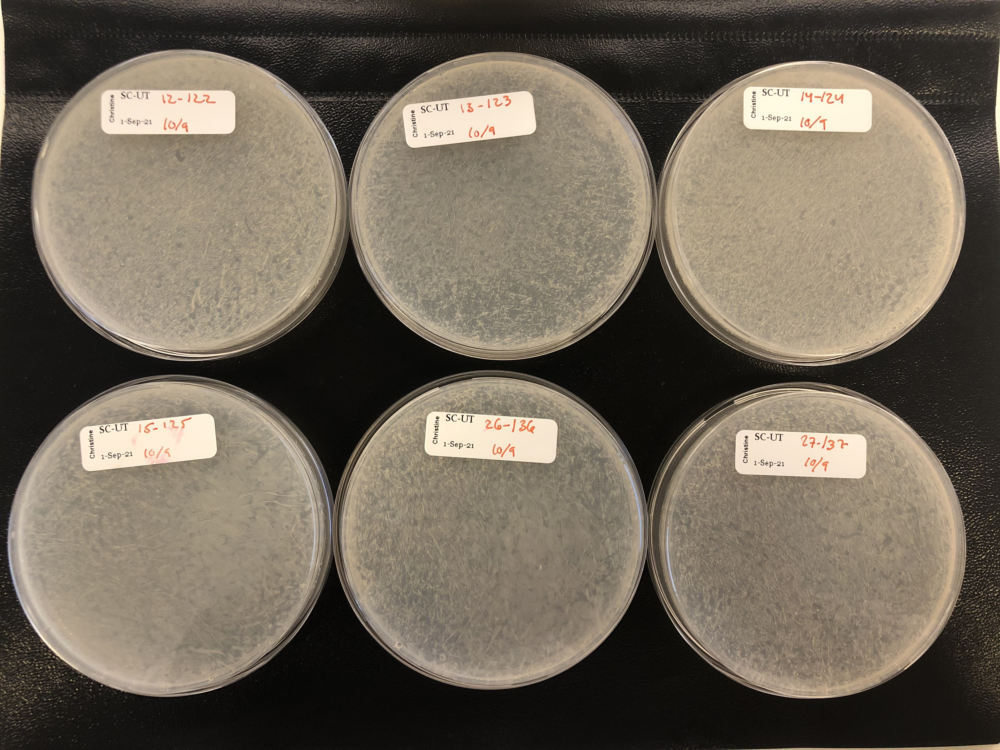

In [164]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/Trans_10-09_1-11.jpg', width=600)

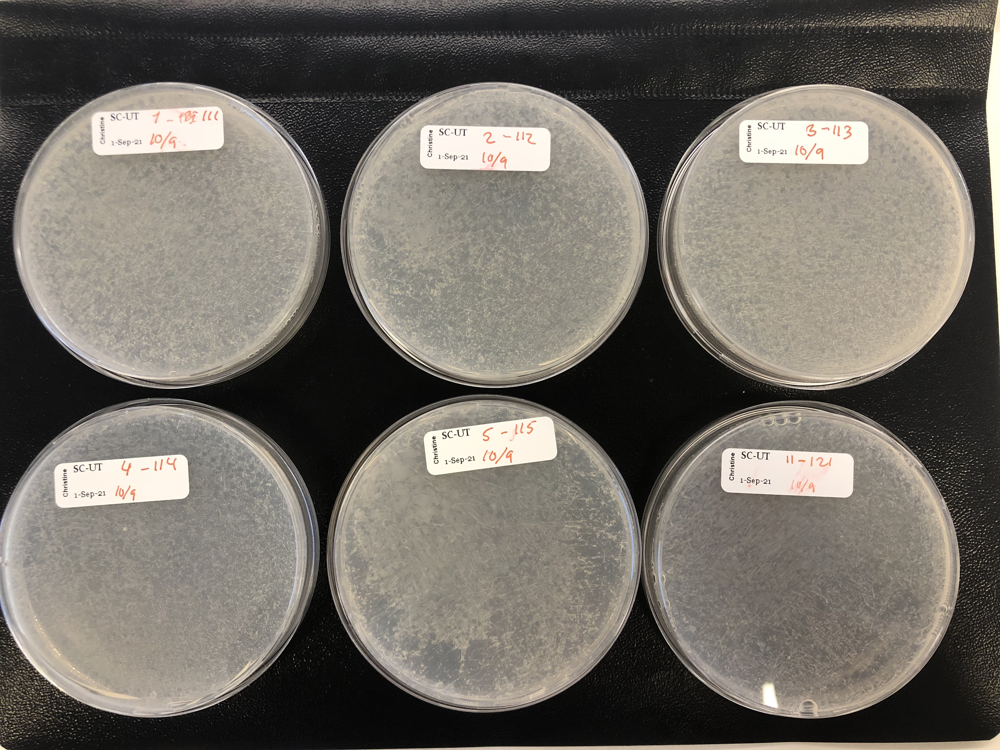

In [165]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/Trans_10-09_12-27.jpg', width=600)

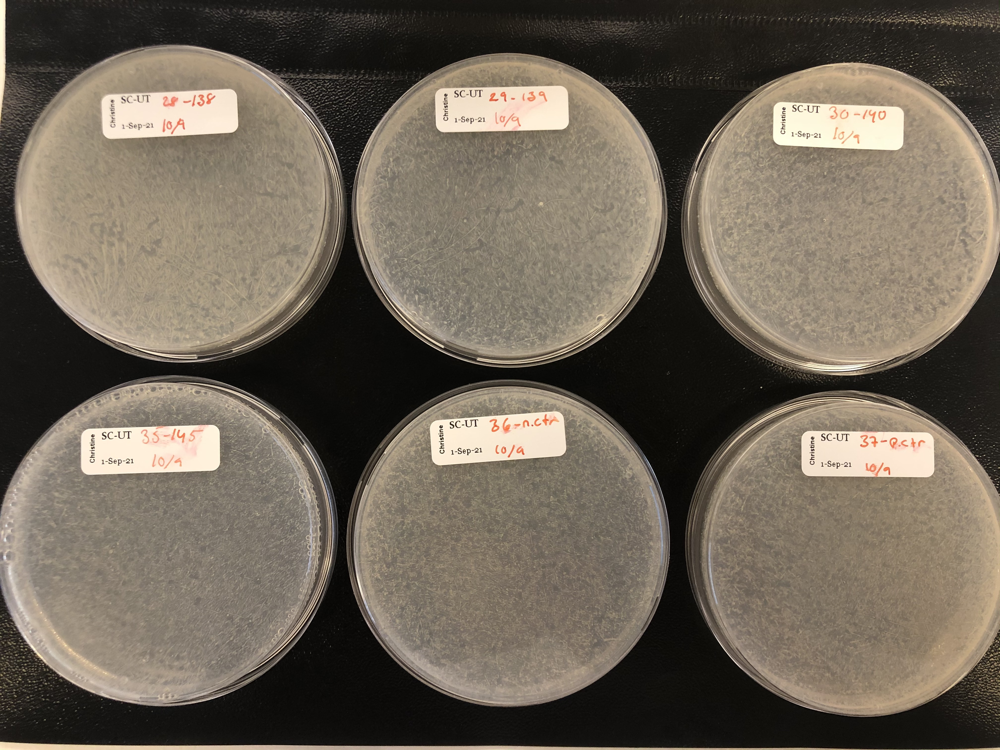

In [166]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/Trans_10-09_28-37.jpg', width=600)

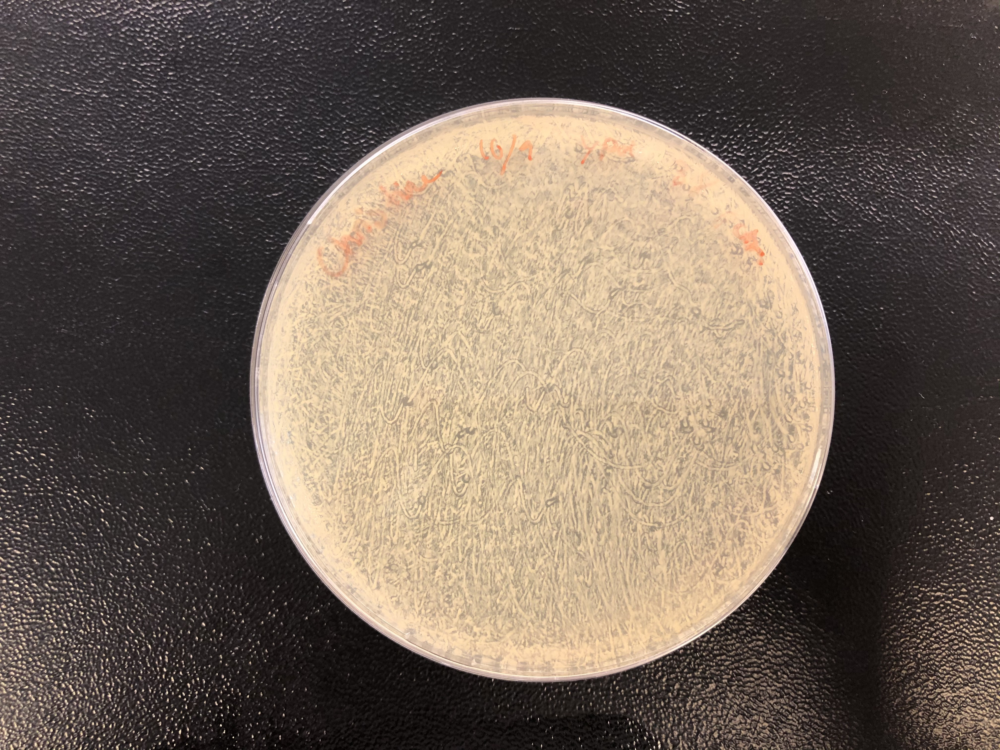

In [167]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/Trans_10-09_38.jpg', width=600)

This time the transfomrations did not go so well. It might be explained by the high OD and thereby the high amount of cells. in the next trial I will make sure to have around 3.5 ml OD1 pr trans.

In [168]:
"""
for part in reaction_participants:
    for p in part:
        if p.name == 'XI-2_DW':
            p.annotations['batches'][0]['concentration'] = 25
            p.annotations['batches'][0]['position'] = 'l6_B6'
        elif p.name == 'cTRP1' or p.name == 'XI-2_UP':
            p.annotations['batches'][0]['position'] = 'l6_B6'
            p.annotations['batches'][0]['concentration'] = 1000000 #as this is a part of XI-2_UP
        elif p.name == 'Promoters_pool':
            p.annotations['batches'][0]['concentration'] = 163
        elif p.name == 'pESC-URA-gRNA_XI2-2':
            p.annotations['batches'][0]['position'] = 'p1_B1'
            p.annotations['batches'][0]['concentration'] = 205
"""            


"\nfor part in reaction_participants:\n    for p in part:\n        if p.name == 'XI-2_DW':\n            p.annotations['batches'][0]['concentration'] = 25\n            p.annotations['batches'][0]['position'] = 'l6_B6'\n        elif p.name == 'cTRP1' or p.name == 'XI-2_UP':\n            p.annotations['batches'][0]['position'] = 'l6_B6'\n            p.annotations['batches'][0]['concentration'] = 1000000 #as this is a part of XI-2_UP\n        elif p.name == 'Promoters_pool':\n            p.annotations['batches'][0]['concentration'] = 163\n        elif p.name == 'pESC-URA-gRNA_XI2-2':\n            p.annotations['batches'][0]['position'] = 'p1_B1'\n            p.annotations['batches'][0]['concentration'] = 205\n"

In [169]:
#information from the third transformation
New_pools_3={'cTRP1':{'pool_location': 'l6_B6', 'pool_concentration':10000},'XI-2_UP':{'pool_location': 'l6_B6', 'pool_concentration':10000},'XI-2_DW':{'pool_location': 'l6_B6', 'pool_concentration':25},'Promoters_pool':{'pool_location': 'l6_B5', 'pool_concentration':163},'VminG8H_tADH1':{'pool_location': 'l6_D8', 'pool_concentration':45},'RsepG8H_tADH1':{'pool_location': 'l6_D7', 'pool_concentration':61},'OeuG8H_tADH1':{'pool_location': 'l6_D6', 'pool_concentration':83},'AniCPR_tCYC1':{'pool_location': 'l6_D9', 'pool_concentration':32}}#Add the new pools to the assembly dicts

#add to pool dict
for part in reaction_participants:
    for p in part:
        if p.name in New_pools_3:
            p.annotations['batches'][0]['concentration'] = New_pools_3[p.name]['pool_concentration']
            p.annotations['batches'][0]['position'] = New_pools_3[p.name]['pool_location']

          

In [170]:
#Third transformation (repeating the second)
transf_idx_3 = list(range(0,5)) + list(range(10,15)) + list(range(25,30))+list(range(34,38))
reaction_names_3 = [reaction_names[i] for i in transf_idx_3]
reaction_participants_3 = [reaction_participants[i] for i in transf_idx_3]

#Calculate amounts needed
amnt = 0.0005
wanted_amounts_3 = [[] for i in range(len(reaction_participants_3))]
names_matrix_3 = [[] for i in range(len(reaction_participants_3))]
for reac_no, reac in enumerate(reaction_participants_3):
    for parti_no, parti in enumerate(reac):
        names_matrix_3[reac_no].append(parti.name)
        if parti.name == 'pESC-URA-gRNA_XI2-2':
            wanted_amounts_3[reac_no].append(amnt/2)
        elif parti.name =='Promoters_pool':
            wanted_amounts_3[reac_no].append(0.0018)
        else:
            wanted_amounts_3[reac_no].append(amnt)
media_3 = [media[i] for i in transf_idx_3]


In [171]:
#itemDict = {name: item for item in wanted_amounts_1 for name in reaction_participants_1 }
itemDict2 = {}
for i in range(len(reaction_participants_3)): 
    for j in range(len(reaction_participants_3[i])):
        #print(name.name)
        itemDict2[str(reaction_participants_3[i][j].name)]= float(wanted_amounts_3[i][j])
        #print(float(wanted_amounts_2[i][j]))
        
itemDict2

{'UP_XI-2': 0.0005,
 'VminG8H_tADH1': 0.0005,
 'seq_3bqXE4zg': 0.0005,
 'CroCPR_tCYC1': 0.0005,
 'seq_3HMRtcpy': 0.0005,
 'DW_XI-2': 0.0005,
 'pESC-URA-gRNA_XI2-2': 0.00025,
 'AanCPR_tCYC1': 0.0005,
 'AraCPR_tCYC1': 0.0005,
 'CloCPR_tCYC1': 0.0005,
 'RseCPR_tCYC1': 0.0005,
 'SmusG8H_tADH1': 0.0005,
 'AhuCPR_tCYC1': 0.0005,
 'AniCPR_tCYC1': 0.0005,
 'RsepG8H_tADH1': 0.0005,
 'CroG8H_tADH1': 0.0005,
 'OeuG8H_tADH1': 0.0005,
 'pL_01_C2_(pRS414-TRP)': 0.0005,
 'pL_01_C4_(pRS416-URA)': 0.0005}

In [172]:

#Print transfomation DNA mixes
transf_names_3 = transformation_mix(reaction_names_3, reaction_participants_3, wanted_amounts = itemDict2, water_dna_p_reac = 74, media = media_3)
transf_names_3 = transf_names_3.set_index([pd.Index([str(ID + 1) for ID in transf_idx_3])])

#Print total sum of each part
transf_names_3.sum(numeric_only = True)

UP_XI-2                   28.8
VminG8H_tADH1             65.0
seq_3bqXE4zg              54.4
CroCPR_tCYC1              12.3
seq_3HMRtcpy              73.6
DW_XI-2                   28.8
pESC-URA-gRNA_XI2-2      105.4
AanCPR_tCYC1              34.8
AraCPR_tCYC1               3.6
CloCPR_tCYC1              43.2
RseCPR_tCYC1              66.9
SmusG8H_tADH1             43.6
AhuCPR_tCYC1               6.4
AniCPR_tCYC1              69.0
RsepG8H_tADH1              9.6
CroG8H_tADH1              11.4
OeuG8H_tADH1              21.3
pL_01_C2_(pRS414-TRP)     16.4
pL_01_C4_(pRS416-URA)      8.0
water                    703.5
dtype: float64

In [173]:
#print transformation mix DNA
transf_names_3

,name,UP_XI-2,VminG8H_tADH1,seq_3bqXE4zg,CroCPR_tCYC1,seq_3HMRtcpy,DW_XI-2,pESC-URA-gRNA_XI2-2,AanCPR_tCYC1,AraCPR_tCYC1,...,SmusG8H_tADH1,AhuCPR_tCYC1,AniCPR_tCYC1,RsepG8H_tADH1,CroG8H_tADH1,OeuG8H_tADH1,pL_01_C2_(pRS414-TRP),pL_01_C4_(pRS416-URA),water,plate on
1,HA111,1.8,13.0,3.4,4.1,4.6,1.8,6.2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.1,SC-UT
2,HA112,1.8,13.0,3.4,NaN,4.6,1.8,6.2,17.4,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.8,SC-UT
3,HA113,1.8,13.0,3.4,NaN,4.6,1.8,6.2,NaN,3.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.6,SC-UT
4,HA114,1.8,13.0,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21.6,SC-UT
5,HA115,1.8,13.0,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.9,SC-UT
11,HA121,1.8,NaN,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,10.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23.7,SC-UT
12,HA122,1.8,NaN,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,10.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23.0,SC-UT
13,HA123,1.8,NaN,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,10.9,3.2,NaN,NaN,NaN,NaN,NaN,NaN,42.1,SC-UT
14,HA124,1.8,NaN,3.4,NaN,4.6,1.8,6.2,NaN,NaN,...,10.9,NaN,23.0,NaN,NaN,NaN,NaN,NaN,22.3,SC-UT
15,HA125,1.8,NaN,3.4,4.1,4.6,1.8,6.2,NaN,NaN,...,NaN,NaN,NaN,9.6,NaN,NaN,NaN,NaN,42.5,SC-UT


### 6.3 Update position and location

In [174]:
#Print locations and concentrations
seen = []
for part in reaction_participants_3:
    for p in part:
        if p.name not in seen:
            #print(p.name,'\t', p.annotations['batches'][0]['concentration'],'\t', p.annotations['batches'][0]['position'] )
            seen.append(p.name)

In [175]:
#Print tranforamation mix
pcr_volumes(vol_p_reac = 360, 
        no_of_reactions = 20,
        standard_reagents = ["PEG", "LiAc_1M", "ssDNA", "water_dna"],
        standard_volumes = [240, 36, 10, 74])

,vol_p_reac,vol_p_20_reac
PEG,240.0,4800.0
LiAc_1M,36.0,720.0
ssDNA,10.0,200.0
water_dna,74.0,1480.0
Total,360.0,7200.0


At 9 o'clock, 3 different OD's were inoculated
- first: from 10X -> OD 0..204*2 = 0.408 ( 8.40)
- second: from OD 10X wihite caps_ 0.052*2 = 0.208 (around 9)
- third: 0.482 from 1X kolbe (Around 9))

at 12.10:_ first 0.233*4 = 0.932

at 12.25 the same was 1.024 -> used in transfomraiton

the second was 0.206*4 = 0.824 (just below one doubling time - 

third was 0.155*4 = 062 - very high, aronuid 2 doubeling times - something must have been wrong. 


Was inoculated at 15.00 with 4 ml of OD 1 pr transfomraion  this is half the amount used in the last trasnformation

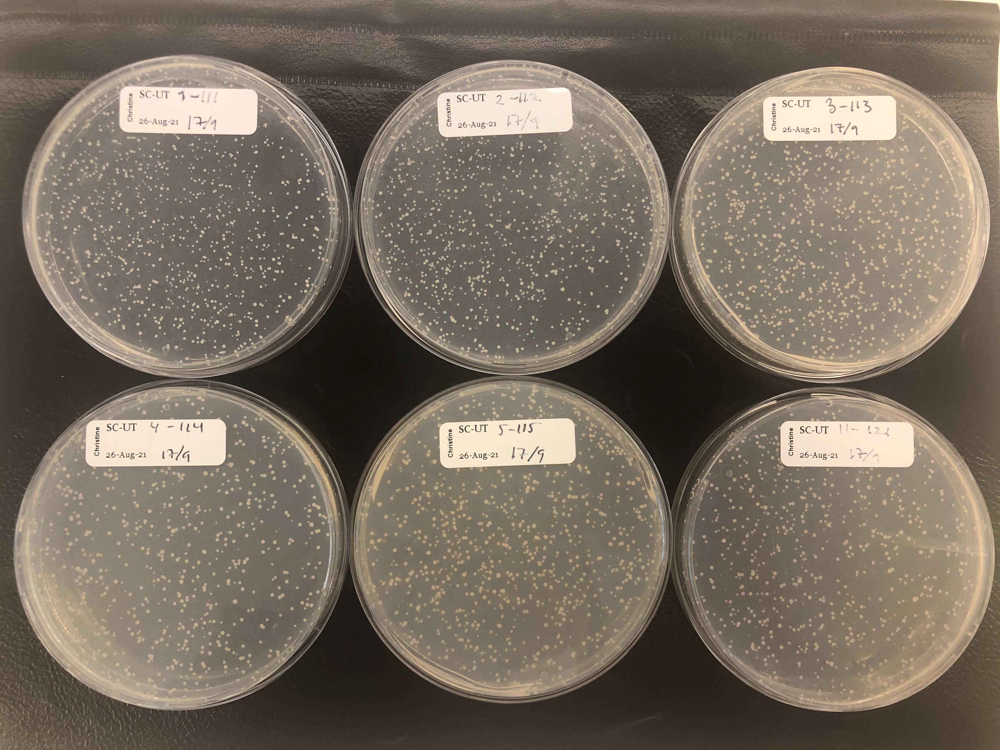

In [176]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/Trans_17-09_1-11.jpeg', width=800)

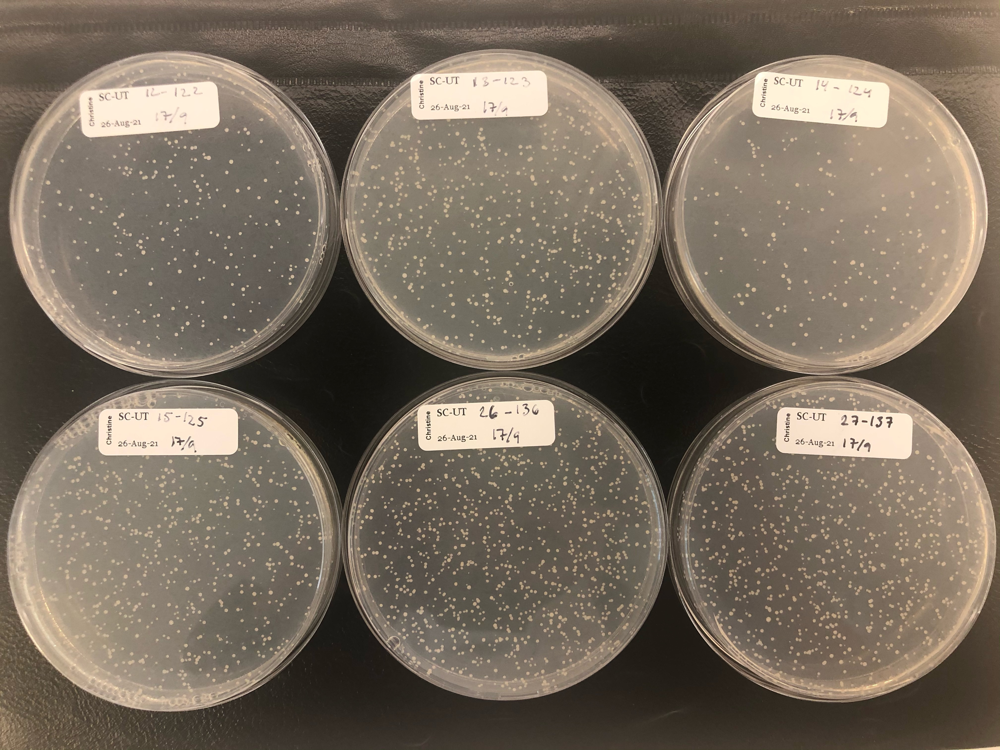

In [177]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/Trans_17-09_12-27.jpeg', width=600)

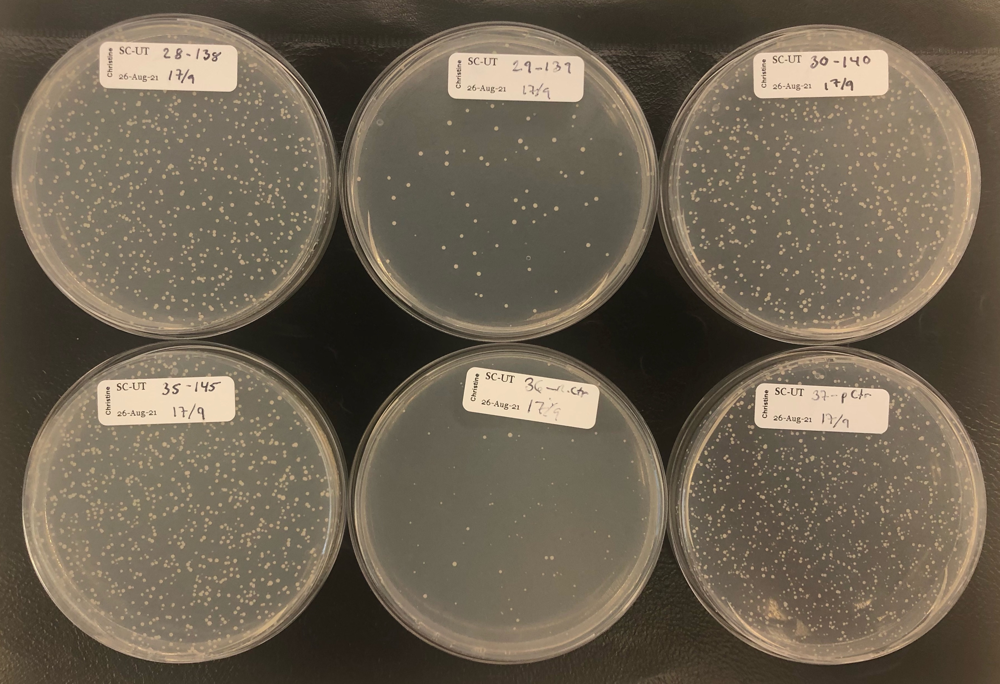

In [178]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/Trans_17-09_28-37.jpeg', width=600)

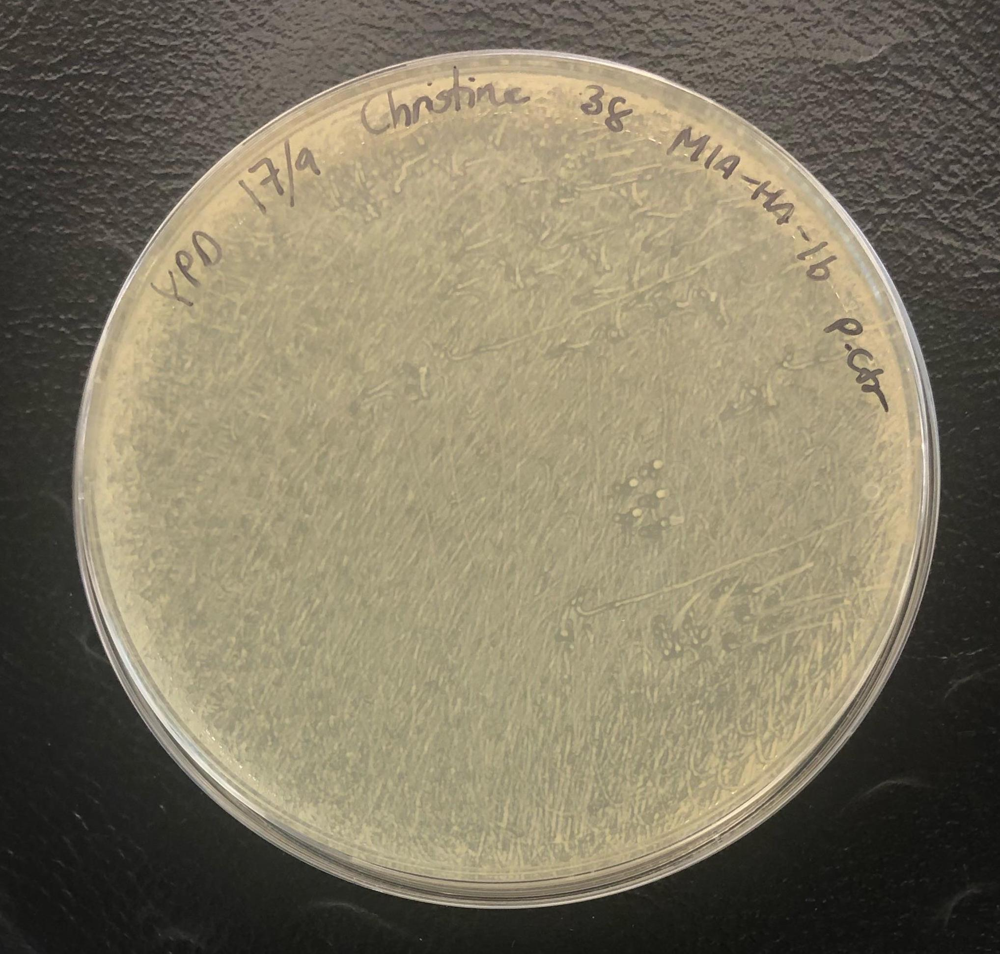

In [179]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/Trans_17-09_38.jpeg', width=600)

This time the transformations had many more colonies that usual, and the gRNA negative control only had very few, which is different from all the other transformations. 


### 6.3 Import plate designs for colony picking

In [180]:
lcms = pathlib.Path("ConStrain_on_google_colab/Data/raw/023_LC-MS/").resolve()
yp53 = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="MIA-HA-116-120_126-135_141_yp53").reset_index(drop=True)
yp54 = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="111-115_121-125_136-140-145yp54").reset_index(drop=True)
yp53.tail()

,position,Sample name,Cellular compartment,Medium,Sample Type,Temperature (C),Timepoint (h),Cultivation Container ID/Position,Operator Name,Replicate #,Strain,Genotype,Date of sampling
91,H08,MIA-HA-3_001_1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,MIA-HA-3_001,,20210922.0
92,H09,MIA-HA-3_001_2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,MIA-HA-3_001,,20210922.0
93,H10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,,20210922.0
94,H11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,,20210922.0
95,H12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [181]:
yp53['prow'] = yp53['position'].str.slice(stop=-2)
yp53['pcol'] = yp53['position'].str.slice(start=-2)
plate_plot(yp53, 'Strain')

Strain                                                  \
pcol          01          02          03          04          05   
prow                                                               
A     MIA-HA-116  MIA-HA-116  MIA-HA-116  MIA-HA-116  MIA-HA-117   
B     MIA-HA-119  MIA-HA-119  MIA-HA-119  MIA-HA-119  MIA-HA-120   
C     MIA-HA-127  MIA-HA-127  MIA-HA-127  MIA-HA-127  MIA-HA-128   
D     MIA-HA-130  MIA-HA-130  MIA-HA-130  MIA-HA-130  MIA-HA-131   
E     MIA-HA-133  MIA-HA-133  MIA-HA-133  MIA-HA-133  MIA-HA-134   
F            NaN         NaN         NaN         NaN         NaN   
G     MIA-HA-141  MIA-HA-141  MIA-HA-141  MIA-HA-141  MIA-HA-142   
H     MIA-HA-144  MIA-HA-144  MIA-HA-144  MIA-HA-144   n.ctr(36)   

                                                                          \
pcol            06            07            08            09          10   
prow                                                                       
A       MIA-HA-117    MIA-HA-117    MIA-HA-117    MIA-HA-118  MIA-HA-118   
B       MIA-HA-120    MIA-HA-120    MIA-HA-120    MIA-HA-126  MIA-HA-126   
C       MIA-HA-128    MIA-HA-128    MIA-HA-128    MIA-HA-129  MIA-HA-129   
D       MIA-HA-131    MIA-HA-131    MIA-HA-131    MIA-HA-132  MIA-HA-132   
E       MIA-HA-134    MIA-HA-134    MIA-HA-134    MIA-HA-135  MIA-HA-135   
F              NaN           NaN           NaN           NaN         NaN   
G       MIA-HA-142    MIA-HA-142    MIA-HA-142    MIA-HA-143  MIA-HA-143   
H     MIA-HA-2_006  MIA-HA-2_006  MIA-HA-3_001  MIA-HA-3_001         NaN   

                              
pcol          11          12  
prow                          
A     MIA-HA-118  MIA-HA-118  
B     MIA-HA-126  MIA-HA-126  
C     MIA-HA-129  MIA-HA-129  
D     MIA-HA-132  MIA-HA-132  
E     MIA-HA-135  MIA-HA-135  
F            NaN         NaN  
G     MIA-HA-143  MIA-HA-143  
H            NaN         NaN

In [182]:
yp54['prow'] = yp54['position'].str.slice(stop=-2)
yp54['pcol'] = yp54['position'].str.slice(start=-2)
plate_plot(yp54, 'Strain')

Strain                                                              \
pcol          01          02          03          04          05          06   
prow                                                                           
A     MIA-HA-111  MIA-HA-111  MIA-HA-111  MIA-HA-111  MIA-HA-112  MIA-HA-112   
B     MIA-HA-114  MIA-HA-114  MIA-HA-114  MIA-HA-114  MIA-HA-115  MIA-HA-115   
C     MIA-HA-122  MIA-HA-122  MIA-HA-122  MIA-HA-122  MIA-HA-123  MIA-HA-123   
D     MIA-HA-125  MIA-HA-125  MIA-HA-125  MIA-HA-125  MIA-HA-136  MIA-HA-136   
E     MIA-HA-138  MIA-HA-138  MIA-HA-138  MIA-HA-138  MIA-HA-139  MIA-HA-139   
F     MIA-HA-145  MIA-HA-145  MIA-HA-145  MIA-HA-145  MIA-HA-116  MIA-HA-116   
G       MIA-HA-1    MIA-HA-1    MIA-HA-1         NaN         NaN         NaN   
H            NaN         NaN         NaN         NaN         NaN         NaN   

                                                                          \
pcol          07            08            09            10            11   
prow                                                                       
A     MIA-HA-112    MIA-HA-112    MIA-HA-113    MIA-HA-113    MIA-HA-113   
B     MIA-HA-115    MIA-HA-115    MIA-HA-121    MIA-HA-121    MIA-HA-121   
C     MIA-HA-123    MIA-HA-123    MIA-HA-124    MIA-HA-124    MIA-HA-124   
D     MIA-HA-136    MIA-HA-136    MIA-HA-137    MIA-HA-137    MIA-HA-137   
E     MIA-HA-139    MIA-HA-139    MIA-HA-140    MIA-HA-140    MIA-HA-140   
F            NaN  MIA-HA-2_006  MIA-HA-2_006  MIA-HA-3_001  MIA-HA-3_001   
G            NaN           NaN           NaN           NaN           NaN   
H            NaN           NaN           NaN           NaN           NaN   

                  
pcol          12  
prow              
A     MIA-HA-113  
B     MIA-HA-121  
C     MIA-HA-124  
D     MIA-HA-137  
E     MIA-HA-140  
F       MIA-HA-1  
G            NaN  
H            NaN

# 7. Colony PCR

1.	Pick 4 colonies from all  plates and inoculate in 150 uL SC-UT, microtiter plate , grow ON in the 30oC shaker 300rpm
2.	Transfer 50ul of ON culture to 96 PCR plate, add 60ul of glycerol to the remaining 100ul. Freeze. 

3.	Make gDNA prep in 96 PCR plates

    a.	Spin down 50 µL of ON culture (2200 g, 5 min), remove the supernatant with sucker

    b.	Suspend the cells in 40 µL lysis buffer (200mM LiOAc, 1 % SDS solution).
        - (Prepare stock sol. 0.22 LiAc and mix 900 μl of it with 100 μl of 10% SDS) 
        - for the 96 well plate  0.22 LiAc well plate 3600 μl plus 400 μl of 10%SDS)

    c.	Incubate 15 min 75oC (PCR machine or heating block)

    d.	Add 120 µL EtOH (Absolute), mix

    e.	Spin down DNA and cell debris at 2200 g for 5 minutes, remove the supernatant -suck

    f.	Add 150 µL 70% EtOH, mix

    g.	Spin down DNA and cell debris at 2200 g for 5 minutes, remove the supernatant- suck

    h.	Dry the 96 well plate (in 37oC Incubator) 

    i.	Add 30 µL water or NE buffer, pipet up and down to dissolve the pellet
    
    j.	Centrifuge and remove 20ul to the new plate / safe gDNA
    
    k.  spin to remove air bubbles


 PLEASE NOTE: when removing the sticker lid, be very careful not to splash! when removing, have it a 180 degrees angle, wear gloves and kepp a tight grap close to the sticking site
 



In [183]:
pad_pG8H_fw2

SeqRecord(seq=Seq('AGACAGGTCCATACGCC'), id='10166.0', name='pad_pG8H_fw2', description='description', dbxrefs=[])

In [184]:
#Primers for colony PCR
pad_pG8H_fw2  = pad_pG8H_fw2
tADH1_160_rv = tADH1_160_rv #224

pad_pCPR_fw2  = pad_pCPR_fw2
tCYC1_150_rv = tCYC1_150_rv #225

# Background strain. As we do not know the actual genotype (promoter combination) of the individual library colonies we are using a similar genotype to simulate PCR length.
# As the two primer pairs each should yield the amplicon of a given length just two pcr's are simulated out of 2x140 amplifications
# We are also sequencing MIA-CM-3 and MIA-CH-A2 as controls


HA2 = HA2

#Amplify G8H and CPR amplicon
G8H_amplicon = pydna.amplify.pcr(tADH1_160_rv, pad_pG8H_fw2, HA2)
G8H_amplicon.name = "HA111-145 G8H"
G8H_amplicon.annotations['batches'] = [{'location':"yp53"}]

CPR_amplicon = pydna.amplify.pcr(pad_pCPR_fw2, tCYC1_150_rv, HA2)
CPR_amplicon.name = "HA111-145 CPR"
CPR_amplicon.annotations['batches'] = [{'location':"yp53"}]

#print lengths of the amplicons
len(G8H_amplicon), len(CPR_amplicon)

(2571, 3228)

In [185]:
#Print sequence of primers
tADH1_160_rv.seq, pad_pG8H_fw2.seq, pad_pG8H_fw.seq

(Seq('GAAATTCGCTTATTTAGAAGTGTC'),
 Seq('AGACAGGTCCATACGCC'),
 Seq('TGCCCATTCGATAAGGCA'))

Anneal at 47

In [186]:
#Print sequence of primers CPR
tCYC1_150_rv.seq, pad_pCPR_fw2.seq, pad_pCPR_fw.seq

(Seq('CTCCTTCCTTTTCGGTTAGAG'),
 Seq('TGCCTTATCGAATGGGCA'),
 Seq('GGCGTATGGACCTGTCT'))

Anneal at 50


Print information about primers

In [187]:
tADH1_160_rv.annotations['batches'], pad_pG8H_fw2.annotations['batches']

([{'location': 'primer_box_rack_2_A6', 'volume': nan, 'concentration': nan}],
 [{'location': 'primer_box_rack_2_C2', 'volume': 10.0, 'concentration': 10.0}])

In [188]:
tCYC1_150_rv.annotations['batches'], pad_pCPR_fw2.annotations['batches']

([{'location': 'primer_box_rack_2_A9', 'volume': nan, 'concentration': nan}],
 [{'location': 'primer_box_rack_2_C3', 'volume': 10.0, 'concentration': 10.0}])

In [189]:
#print pcr infomration
pcr_locations([G8H_amplicon,CPR_amplicon])

,location,name,template,fw,rv
0,yp53,HA111-145 G8H,yp53,primer_box_rack_2_A6,primer_box_rack_2_C2
1,yp53,HA111-145 CPR,yp53,primer_box_rack_2_C3,primer_box_rack_2_A9


In [190]:
# PCR mix for the first transfomraiton round for each amplification site (G8H and CPR)
# make 81 * 10 % extra to account for pipetting error 
n = 81
no_of_react = n + n/10
pcr_volumes(vol_p_reac = 30, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_89.1_reac
Template,0.6,53.46
Primer 1,1.5,133.65
Primer 2,1.5,133.65
H20,11.4,1015.74
Pol,15.0,1336.50
Total,30.0,2673.00


In [191]:
# PCR mix for the second transfomrtion round for each amplification site (G8H and CPR)
# make x * 10 % extra to account for pipetting error 
n = 77
no_of_react = n + n/10
pcr_volumes(vol_p_reac = 30, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_84.7_reac
Template,0.6,50.82
Primer 1,1.5,127.05
Primer 2,1.5,127.05
H20,11.4,965.58
Pol,15.0,1270.50
Total,30.0,2541.00


In [192]:
# The total amount needed
n = 158
no_of_react = n + n/10
pcr_volumes(vol_p_reac = 30, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_173.8_reac
Template,0.6,104.28
Primer 1,1.5,260.70
Primer 2,1.5,260.70
H20,11.4,1981.32
Pol,15.0,2607.00
Total,30.0,5214.00


PCR:
run two different PCR's 
- polymerase: OneTq 60 sek/kb
- Program: touch down
- Annealing temp:
    - 51/54
- Elongation time: 
    - 2:34/3:13

HA111-145 G8H
HA111-145 CPR


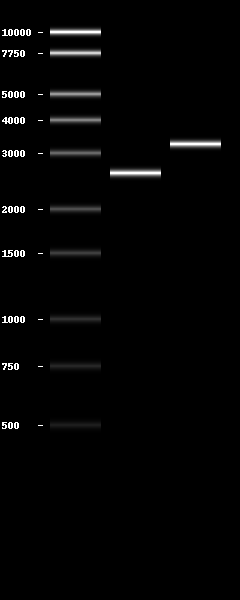

In [193]:
#Print expected gel bands
bands = [G8H_amplicon, CPR_amplicon]
for band in bands:
    print(band.name)
pydna.gel.gel([pydna.ladders.PennStateLadder,*[[band] for band in bands]])

During genomic purification I spilled some, so some of htem have a little less volume. This might have spilled into other wells, but this is doubtfull. Also, some pellet came into the last bit from A's. 

In [194]:
#Print plate designs for PCRs 

yp53_PCR_1 = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="53_PCR_1").reset_index(drop=True)
yp53_PCR_2 = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="53_PCR_2").reset_index(drop=True)

In [195]:
yp53_PCR_1['prow'] = yp53_PCR_1['PCR_pos'].str.slice(stop=-2)
yp53_PCR_1['pcol'] = yp53_PCR_1['PCR_pos'].str.slice(start=-2)
plate_plot(yp53_PCR_1, 'Plate position')

Plate position                                                       
pcol             01   02   03   04   05   06   07   08   09   10   11   12
prow                                                                      
A               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
B               NaN  A01  A02  A03  A04  A05  A06  A07  A08  A09  A10  NaN
C               NaN  A11  A12  B01  B02  B03  B04  B05  B06  B07  B08  NaN
D               NaN  B09  B10  B11  B12  C01  C02  C03  C04  C05  C06  NaN
E               NaN  C07  C08  C09  C10  C11  C12  D01  D02  D03  D04  NaN
F               NaN  D05  D06  D07  D08  D09  D10  D11  D12  E01  E02  NaN
G               NaN  E03  E04  E05  E06  E07  E08  E09  E10  E11  E12  NaN
H               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN

In [196]:
yp53_PCR_2['prow'] = yp53_PCR_2['PCR_pos'].str.slice(stop=-2)
yp53_PCR_2['pcol'] = yp53_PCR_2['PCR_pos'].str.slice(start=-2)
plate_plot(yp53_PCR_2, 'Plate position')

Plate position                                                       
pcol             01   02   03   04   05   06   07   08   09   10   11   12
prow                                                                      
A               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
B               NaN  G01  G02  G03  G04  G05  G06  G07  G08  G09  G10  NaN
C               NaN  G11  G12  H01  H02  H03  H04  H05  H06  H07  H08  NaN
D               NaN  H09  H20  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
E               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
F               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
G               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
H               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN

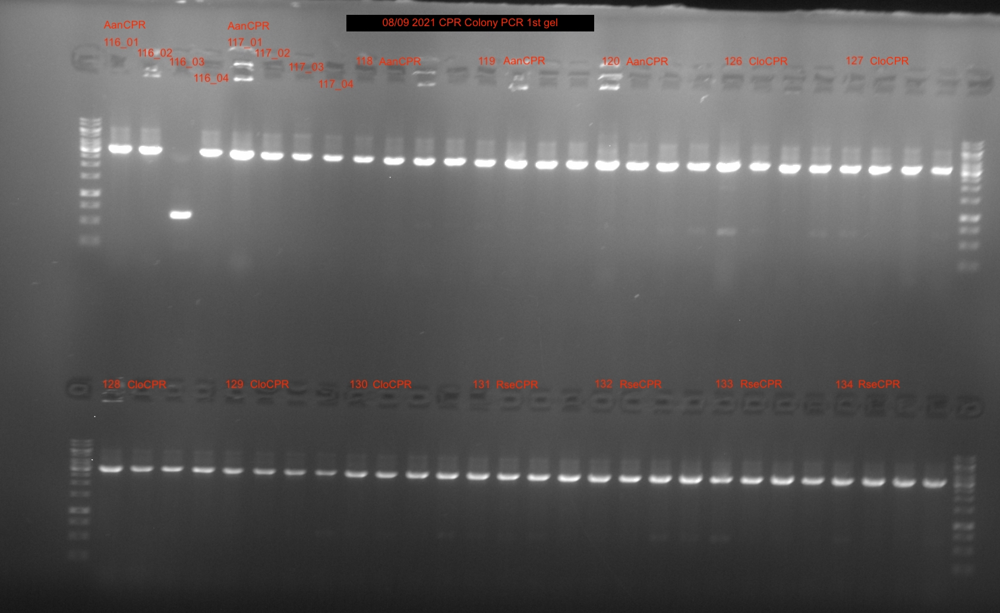

In [197]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09_08_CPR_colony_PCR_1stgel_new.jpg', width=800)

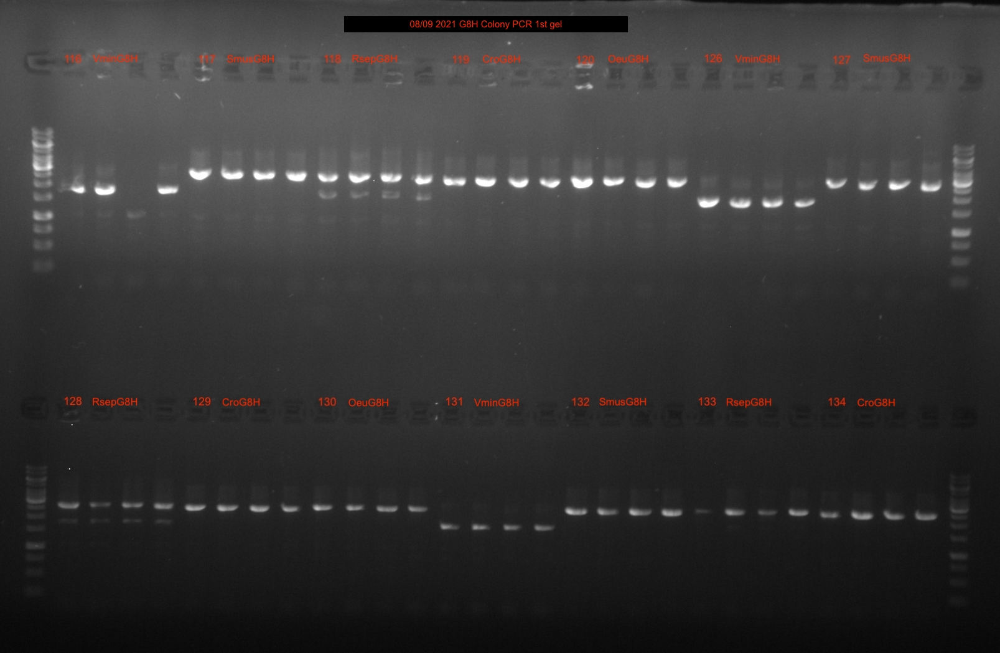

In [198]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09_08_G8H_colony_PCR_1stgel_new.jpg', width=800)

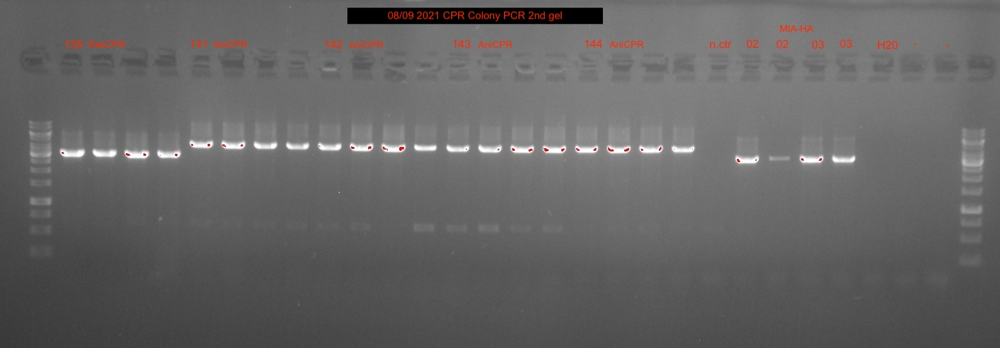

In [199]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09_08_CPR_colony_PCR_2ndgel_new.jpg', width=800)

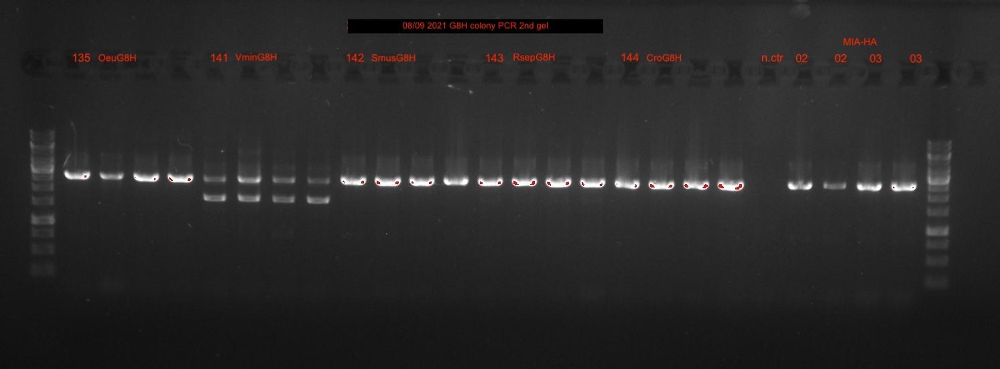

In [200]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-09_08_G8H_colony_PCR_2ndgel_new.jpg', width=800)

In [201]:
#PCR plate design for plate yp54
yp54_PCR_1 = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="54_PCR_1").reset_index(drop=True)
yp54_PCR_2 = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="54_PCR_2").reset_index(drop=True)

In [202]:
yp54_PCR_1['prow'] = yp54_PCR_1['PCR_pos'].str.slice(stop=-2)
yp54_PCR_1['pcol'] = yp54_PCR_1['PCR_pos'].str.slice(start=-2)
plate_plot(yp54_PCR_1, 'Plate position')

Plate position                                                       
pcol             01   02   03   04   05   06   07   08   09   10   11   12
prow                                                                      
A               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
B               NaN  A01  A02  A03  A04  A05  A06  A07  A08  A09  A10  NaN
C               NaN  A11  A12  B01  B02  B03  B04  B05  B06  B07  B08  NaN
D               NaN  B09  B10  B11  B12  C01  C02  C03  C04  C05  C06  NaN
E               NaN  C07  C08  C09  C10  C11  C12  D01  D02  D03  D04  NaN
F               NaN  D05  D06  D07  D08  D09  D10  D11  D12  E01  E02  NaN
G               NaN  E03  E04  E05  E06  E07  E08  E09  E10  E11  E12  NaN
H               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN

In [203]:
yp54_PCR_2['prow'] = yp54_PCR_2['PCR_pos'].str.slice(stop=-2)
yp54_PCR_2['pcol'] = yp54_PCR_2['PCR_pos'].str.slice(start=-2)
plate_plot(yp54_PCR_2, 'Plate position')

Plate position                                                       
pcol             01   02   03   04   05   06   07   08   09   10   11   12
prow                                                                      
A               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
B               NaN  F01  F02  F03  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
C               NaN  F04  F05  F06  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
D               NaN  F07  F08  F09  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
E               NaN  F10  F11  F12  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
F               NaN  G01  G02  G03  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
G               NaN  H20  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
H               NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN

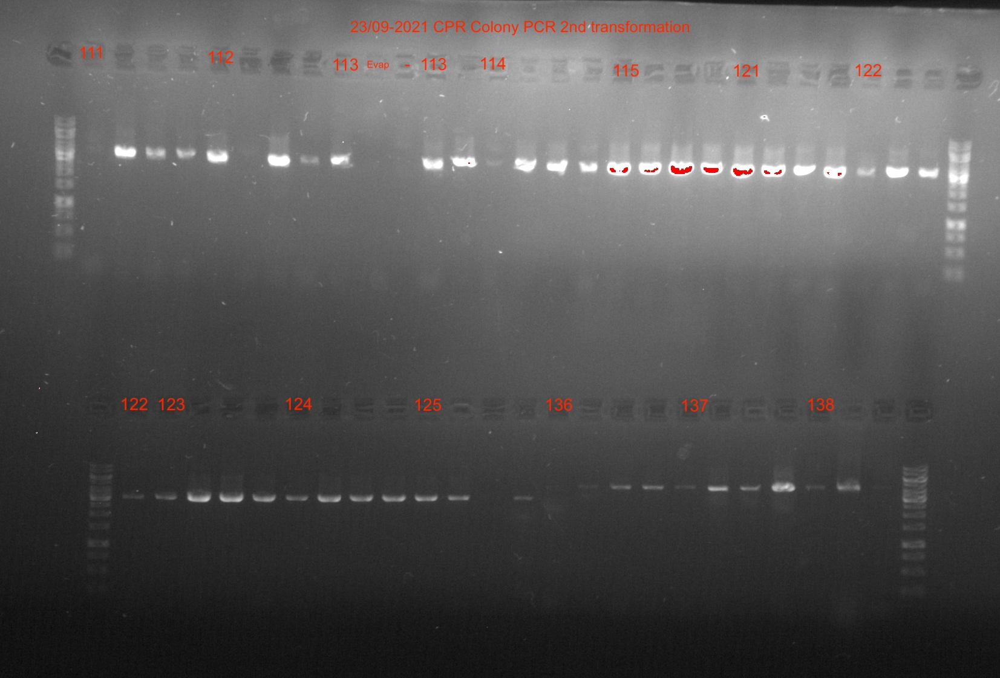

In [204]:
#results
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-23_09_CPR_colony_PCR_1stgel_2ntrans.jpg', width=800)

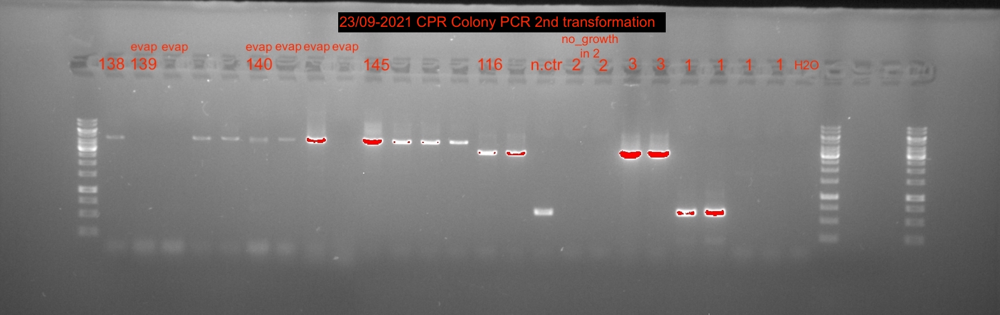

In [205]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-23_09_CPR_colony_PCR_2ndgel_2ntrans.jpg', width=800)

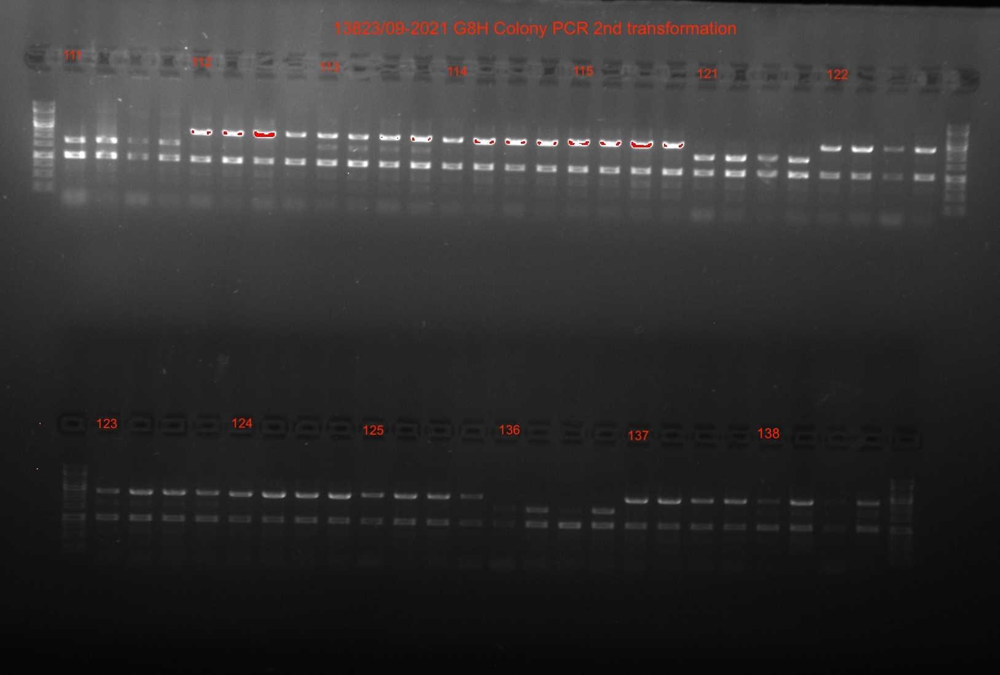

In [206]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-23_09_G8H_colony_PCR_1stgel_2ndtrans.jpg', width=800)

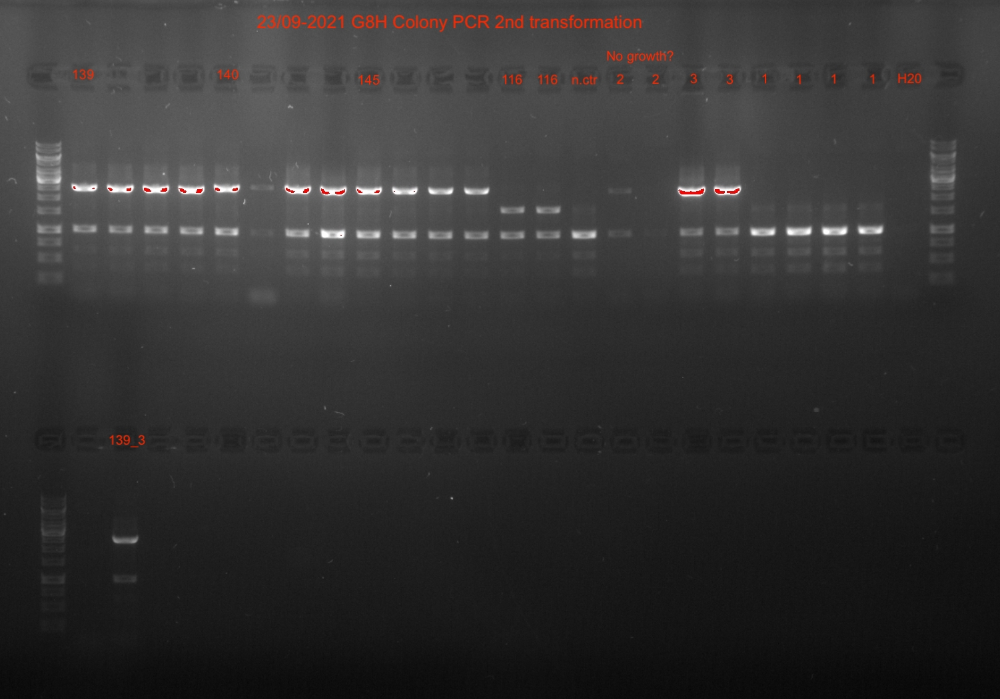

In [207]:
IPython.core.display.Image('ConStrain_on_google_colab/Data/processed/001_Bioimager/2021-23_09_G8H_colony_PCR_2ndgel_2ntrans.jpg', width=800)

# 8. Preparing Analytics

Preculture was innoculated noon the 14th 20 ul + 80 ypd - feed
culture inokultaed 16th at 14:50 - 10 ul culture, 500 ul YPD + feed 

TO be taken out the 22nd at 14:50

**MIA-HA-111-145_analytics_experiment**

Strains  
- YP53
    - (4 colonies * 19 plates) + 2x MIA-HA-2, 2x MIA-HA-3, 4x MIA-CH-A2, 1xMIA-CM-3 and 1xblank 
-  YP54
    - (4 colonies * 16 plates) + 2x MIA-HA-2, 2x MIA-HA-3, 4x MIA-CH-A2, 1xMIA-CM-3 and 1xblank 

Media feed: 0.2 mM geraniol & 1 mM tryptamine
1. YP + 2 % glucose + feed

Sampling times:
1. One: Day: 6

For each sampling time: 
1. Cultivation 30C, 300 rpm:
2. (Monday 10/5): Inoculate precultures. Transfer 10 of YP48 g.stock to 90 media (-feed).
3. (Wednesday 12, at 11): Inoculate maincultures. Transfer 10 of preculture to 500 media
4. (Tuesday 18, at 11): 
    Sample
     1. Transfer 10 of mainculture into 140 to measure OD (in incubator while measuring) # Skipped due to dense cultures
     2. Transfer 200 into new 96 well plate,
     3. Add 20 uL 10 mg/L caffeine stock
     4. Transfer 220 onto filter in collection plate, centrifuge (2000 g x 1 min; put collection plate in -80C) 
     5. Measure MIAs (extracellular loganin)
    Prepare standards (in its own 96wellplate)
        1. Prepare [standards](/files/reports/spreadsheets/20200728_MIA_standards_prep_scheme_v2_std_v13.xlsx)
        2. Transfer X ul Std_MM_v13 onto filter in collection plate, centrifuge (2000 g x 1 min; put collection plate in -80C)      
5. (TBD): Khem run plate
6. (TBD): Data analysis

YPD + feed
1. stocks (in absolute ethanol)
    - 100 mM geraniol (Molar mass 154.253 g·mol−1, Density 0.889 g·cm-3)
        - 154.253 mg (or 173.5 µl) in 10 mL
            $$ \frac{\frac{x mg}{154.253 mg/mmol}}{10 ml} = 0.100 mmol/ml $$
            $$0.100 mmol/ml * 10 ml * 154.253 mg/ml = 154.253 mg$$
            $$ \frac{154.253 mg}{889mg/cm} * 1000 ul/ml = 173.5 ul $$  
    - 1000 mM tryptamine (Molar mass 160.220 g·mol−1) 
        - 160.220 mg in 1 mL
            $$ 1 mmol/ml * 1 ml * 160.220 mg/mmol = 160.220 mg$$

2. Add x to 100 ml YPD
    - geraniol: 200 µl 100 mM to make 0.2 mM (500x dilution)
       $$ \frac{100000 ul}{500} = 200 ul $$
    - tryptamine: 100 µl 1000 mM to make 1 mM (1000x dilution)
       $$ \frac{100000 ul}{1000} = 100 ul $$

In [208]:
#YP53 was reallocated due to some erros during filling in the first round
yp53_reallocated = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="yp53_reallocated").reset_index(drop=True)
yp53_reallocated .tail()

,position,Sample name,Cellular compartment,Medium,Sample Type,Temperature (C),Timepoint (h),Cultivation Container ID/Position,Operator Name,Replicate #,Strain,Genotype,Date of sampling,old position,plate
91,H08,20210922MIA-CH-A2_2,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,2.0,MIA-CH-A2,NaN,20210922.0,F02,yp53
92,H09,20210922MIA-CH-A2_3,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,3.0,MIA-CH-A2,NaN,20210922.0,F03,yp53
93,H10,20210922MIA-CH-A2_4,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,4.0,MIA-CH-A2,NaN,20210922.0,F04,yp53
94,H11,20210922MIA-CM-3_1,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,1.0,MIA-CM-3,NaN,20210922.0,F05,yp53
95,H12,20210922BLANK_1,Extracellular Region,YPD,Blank,30.0,144.0,NaN,Christine Møller Pedersen,1.0,BLANK,NaN,20210922.0,F06,yp53


In [209]:
yp53_reallocated

,position,Sample name,Cellular compartment,Medium,Sample Type,Temperature (C),Timepoint (h),Cultivation Container ID/Position,Operator Name,Replicate #,Strain,Genotype,Date of sampling,old position,plate
0,A01,20210922MIA-HA-116_1,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,1.0,MIA-HA-116,VminG8H AanCPR,20210922.0,A01,yp53
1,A02,20210922MIA-HA-116_2,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,2.0,MIA-HA-116,VminG8H AanCPR,20210922.0,A02,yp53
2,A03,20210922MIA-HA-116_3,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,3.0,MIA-HA-116,VminG8H AanCPR,20210922.0,A03,yp53
3,A04,20210922MIA-HA-116_4,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,4.0,MIA-HA-116,VminG8H AanCPR,20210922.0,A04,yp53
4,A05,20210922MIA-HA-117_1,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,1.0,MIA-HA-117,SmusG8H AanCPR,20210922.0,A05,yp53
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,H08,20210922MIA-CH-A2_2,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,2.0,MIA-CH-A2,NaN,20210922.0,F02,yp53
92,H09,20210922MIA-CH-A2_3,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,3.0,MIA-CH-A2,NaN,20210922.0,F03,yp53
93,H10,20210922MIA-CH-A2_4,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,4.0,MIA-CH-A2,NaN,20210922.0,F04,yp53
94,H11,20210922MIA-CM-3_1,Extracellular Region,YPD,Specimen,30.0,144.0,NaN,Christine Møller Pedersen,1.0,MIA-CM-3,NaN,20210922.0,F05,yp53


In [210]:
yp53_reallocated['prow'] = yp53_reallocated['position'].str.slice(stop=-2)
yp53_reallocated['pcol'] = yp53_reallocated['position'].str.slice(start=-2)
plate_plot(yp53_reallocated, 'old position')

old position                                                       
pcol           01   02   03   04   05   06   07   08   09   10   11   12
prow                                                                    
A             A01  A02  A03  A04  A05  A06  A07  A08  A09  A10  A11  A12
B             B01  B02  B03  B04  B05  B06  B07  B08  B09  B10  B11  B12
C             C01  C02  C03  C04  C05  C06  C07  C08  C09  C10  C11  C12
D             D01  D02  D03  D04  D05  D06  D07  D08  D09  D10  D11  D12
E             E01  E02  E03  E04  E05  E06  E07  E08  E09  E10  E11  E12
F             G01  G02  G03  G04  G05  G06  G07  G08  G09  G10  G11  G12
G             H01  H02  H03  H04  H05  H06  H07  H08  H09  NaN  NaN  NaN
H             NaN  NaN  NaN  NaN  NaN  NaN  F01  F02  F03  F04  F05  F06

In [211]:
plate_plot(yp53_reallocated, 'Strain')

Strain                                                  \
pcol          01          02          03          04          05   
prow                                                               
A     MIA-HA-116  MIA-HA-116  MIA-HA-116  MIA-HA-116  MIA-HA-117   
B     MIA-HA-119  MIA-HA-119  MIA-HA-119  MIA-HA-119  MIA-HA-120   
C     MIA-HA-127  MIA-HA-127  MIA-HA-127  MIA-HA-127  MIA-HA-128   
D     MIA-HA-130  MIA-HA-130  MIA-HA-130  MIA-HA-130  MIA-HA-131   
E     MIA-HA-133  MIA-HA-133  MIA-HA-133  MIA-HA-133  MIA-HA-134   
F     MIA-HA-141  MIA-HA-141  MIA-HA-141  MIA-HA-141  MIA-HA-142   
G     MIA-HA-144  MIA-HA-144  MIA-HA-144  MIA-HA-144   n.ctr(36)   
H            NaN         NaN         NaN         NaN         NaN   

                                                                          \
pcol            06            07            08            09          10   
prow                                                                       
A       MIA-HA-117    MIA-HA-117    MIA-HA-117    MIA-HA-118  MIA-HA-118   
B       MIA-HA-120    MIA-HA-120    MIA-HA-120    MIA-HA-126  MIA-HA-126   
C       MIA-HA-128    MIA-HA-128    MIA-HA-128    MIA-HA-129  MIA-HA-129   
D       MIA-HA-131    MIA-HA-131    MIA-HA-131    MIA-HA-132  MIA-HA-132   
E       MIA-HA-134    MIA-HA-134    MIA-HA-134    MIA-HA-135  MIA-HA-135   
F       MIA-HA-142    MIA-HA-142    MIA-HA-142    MIA-HA-143  MIA-HA-143   
G     MIA-HA-2_006  MIA-HA-2_006  MIA-HA-3_001  MIA-HA-3_001         NaN   
H              NaN     MIA-CH-A2     MIA-CH-A2     MIA-CH-A2   MIA-CH-A2   

                              
pcol          11          12  
prow                          
A     MIA-HA-118  MIA-HA-118  
B     MIA-HA-126  MIA-HA-126  
C     MIA-HA-129  MIA-HA-129  
D     MIA-HA-132  MIA-HA-132  
E     MIA-HA-135  MIA-HA-135  
F     MIA-HA-143  MIA-HA-143  
G            NaN         NaN  
H       MIA-CM-3       BLANK

savthe preculture for analytics in a new 53

## 8.1 Sequencing
Sequencing was perfomed with a plate sequencing kit for crude PCR products

In [212]:
yp53_PCR_to_seq = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="53PCR_til_sekventering").reset_index(drop=True)

yp54_PCR_to_seq = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="54PCR_til_sekventering").reset_index(drop=True)

In [213]:
yp53_PCR_to_seq['prow'] = yp53_PCR_to_seq['new_platepos/seq'].str.slice(stop=-2)
yp53_PCR_to_seq['pcol'] = yp53_PCR_to_seq['new_platepos/seq'].str.slice(start=-2)
plate_plot(yp53_PCR_to_seq, 'PCR_plate_pos')

PCR_plate_pos                                                         \
pcol            01         02         03         04         05         06   
prow                                                                        
A        PCR_1_B02  PCR_1_B03  PCR_1_B04  PCR_1_B05  PCR_1_B06  PCR_1_B07   
B        PCR_1_C04  PCR_1_C05  PCR_1_C06  PCR_1_C07  PCR_1_C08  PCR_1_C09   
C        PCR_1_D06  PCR_1_D07  PCR_1_D08  PCR_1_D09  PCR_1_D10  PCR_1_D11   
D        PCR_1_E08  PCR_1_E09  PCR_1_E10  PCR_1_E11  PCR_1_F02  PCR_1_F03   
E        PCR_1_F10  PCR_1_F11  PCR_1_G02  PCR_1_G03  PCR_1_G04  PCR_1_G05   
F        PCR_2_B02  PCR_2_B03  PCR_2_B04  PCR_2_B05  PCR_2_B06  PCR_2_B07   
G        PCR_2_C04  PCR_2_C05  PCR_2_C06  PCR_2_C07  PCR_2_C08  PCR_2_C09   
H              NaN        NaN        NaN        NaN        NaN        NaN   

                                                                        
pcol         07         08         09         10         11         12  
prow                                                                    
A     PCR_1_B08  PCR_1_B09  PCR_1_B10  PCR_1_B11  PCR_1_C02  PCR_1_C03  
B     PCR_1_C10  PCR_1_C11  PCR_1_D02  PCR_1_D03  PCR_1_D04  PCR_1_D05  
C     PCR_1_E02  PCR_1_E03  PCR_1_E04  PCR_1_E05  PCR_1_E06  PCR_1_E07  
D     PCR_1_F04  PCR_1_F05  PCR_1_F06  PCR_1_F07  PCR_1_F08  PCR_1_F09  
E     PCR_1_G06  PCR_1_G07  PCR_1_G08  PCR_1_G09  PCR_1_G10  PCR_1_G11  
F     PCR_2_B08  PCR_2_B09  PCR_2_B10  PCR_2_B11  PCR_2_C02  PCR_2_C03  
G     PCR_2_C10  PCR_2_C11  PCR_2_D02        NaN        NaN        NaN  
H           NaN        NaN        NaN        NaN        NaN         QC

In [214]:
yp54_PCR_to_seq['prow'] = yp54_PCR_to_seq['Plate/seq position'].str.slice(stop=-2)
yp54_PCR_to_seq['pcol'] = yp54_PCR_to_seq['Plate/seq position'].str.slice(start=-2)
plate_plot(yp54_PCR_to_seq, 'PCR_plate_pos')

PCR_plate_pos                                                         \
pcol            01         02         03         04         05         06   
prow                                                                        
A        PCR_1_B02  PCR_1_B03  PCR_1_B04  PCR_1_B05  PCR_1_B06  PCR_1_B07   
B        PCR_1_C04  PCR_1_C05  PCR_1_C06  PCR_1_C07  PCR_1_C08  PCR_1_C09   
C        PCR_1_D06  PCR_1_D07  PCR_1_D08  PCR_1_D09  PCR_1_D10  PCR_1_D11   
D        PCR_1_E08  PCR_1_E09  PCR_1_E10  PCR_1_E11  PCR_1_F02  PCR_1_F03   
E        PCR_1_F10  PCR_1_F11  PCR_1_G02  PCR_1_G03  PCR_1_G04  PCR_1_G05   
F        PCR_2_B02  PCR_2_B03  PCR_2_B04  PCR_2_B05  PCR_2_B06  PCR_2_B07   
G        PCR_2_C04  PCR_2_C05  PCR_2_C06        NaN        NaN        NaN   
H              NaN        NaN        NaN        NaN        NaN        NaN   

                                                                        
pcol         07         08         09         10         11         12  
prow                                                                    
A     PCR_1_B08  PCR_1_B09  PCR_1_B10  PCR_1_B11  PCR_1_C02  PCR_1_C03  
B     PCR_1_C10  PCR_1_C11  PCR_1_D02  PCR_1_D03  PCR_1_D04  PCR_1_D05  
C     PCR_1_E02  PCR_1_E03  PCR_1_E04  PCR_1_E05  PCR_1_E06  PCR_1_E07  
D     PCR_1_F04  PCR_1_F05  PCR_1_F06  PCR_1_F07  PCR_1_F08  PCR_1_F09  
E     PCR_1_G06  PCR_1_G07  PCR_1_G08  PCR_1_G09  PCR_1_G10  PCR_1_G11  
F     PCR_2_B08  PCR_2_B09  PCR_2_B10  PCR_2_B11  PCR_2_C02  PCR_2_C03  
G           NaN        NaN        NaN        NaN        NaN        NaN  
H           NaN        NaN        NaN        NaN        NaN         QC

Some wells had evaopuradet, and therefore, the PCRs below were redone. 

In [215]:
pcr_locations([G8H_amplicon,CPR_amplicon])

,location,name,template,fw,rv
0,yp53,HA111-145 G8H,yp53,primer_box_rack_2_A6,primer_box_rack_2_C2
1,yp53,HA111-145 CPR,yp53,primer_box_rack_2_C3,primer_box_rack_2_A9


In [216]:
# for each amplification site (G8H and CPR)
# make 81 * 10 % extra to account for pipetting error 
n = 20
no_of_react = n + n/10
pcr_volumes(vol_p_reac = 35, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_22.0_reac
Template,0.70,15.4
Primer 1,1.75,38.5
Primer 2,1.75,38.5
H20,13.30,292.6
Pol,17.50,385.0
Total,35.00,770.0


PCR:
run two different PCR's 
- polymerase: OneTq 60 sek/kb
- Program: touch down
- Annealing temp:
    - 51/54
- Elongation time: 
    - 2:34/3:13

In [217]:
colonyPCR_for_seq = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="second_colony_for_seq").reset_index(drop=True)
colonyPCR_for_seq


,PCR_pos,Plate,Gene,Plate position,PCR_plate,Unnamed: 5
0,1,NaN,NaN,NaN,NaN,NaN
1,2,54.0,CPR,A02,PCR_1_B03,MIA-HA-111_2
2,3,54.0,CPR,A08,PCR_1_B09,MIA-HA-112_4
3,4,54.0,CPR,A09,PCR_1_B10,MIA-HA-113_1
4,5,54.0,CPR,A10,PCR_1_B11,MIA-HA-113_2
5,6,54.0,CPR,D05,PCR_1_F02,MIA-HA-136_1
6,7,54.0,CPR,E02,PCR_1_F11,MIA-HA-138_2
7,8,54.0,CPR,E05,PCR_1_G04,MIA-HA-139_1
8,9,54.0,CPR,E06,PCR_1_G05,MIA-HA-139_2
9,10,54.0,CPR,E09,PCR_1_G08,MIA-HA-140_1


In [218]:
#Create table for latex for report
print(pd.DataFrame(colonyPCR_for_seq).to_latex())

\begin{tabular}{lrrllll}
\toprule
{} &  PCR\_pos &  Plate & Gene & Plate position &  PCR\_plate &    Unnamed: 5 \\
\midrule
0  &        1 &    NaN &  NaN &            NaN &        NaN &           NaN \\
1  &        2 &   54.0 &  CPR &            A02 &  PCR\_1\_B03 &  MIA-HA-111\_2 \\
2  &        3 &   54.0 &  CPR &            A08 &  PCR\_1\_B09 &  MIA-HA-112\_4 \\
3  &        4 &   54.0 &  CPR &            A09 &  PCR\_1\_B10 &  MIA-HA-113\_1 \\
4  &        5 &   54.0 &  CPR &            A10 &  PCR\_1\_B11 &  MIA-HA-113\_2 \\
5  &        6 &   54.0 &  CPR &            D05 &  PCR\_1\_F02 &  MIA-HA-136\_1 \\
6  &        7 &   54.0 &  CPR &            E02 &  PCR\_1\_F11 &  MIA-HA-138\_2 \\
7  &        8 &   54.0 &  CPR &            E05 &  PCR\_1\_G04 &  MIA-HA-139\_1 \\
8  &        9 &   54.0 &  CPR &            E06 &  PCR\_1\_G05 &  MIA-HA-139\_2 \\
9  &       10 &   54.0 &  CPR &            E09 &  PCR\_1\_G08 &  MIA-HA-140\_1 \\
10 &       11 &   54.0 &  CPR &            E10 &  PCR\_1\_G

/var/folders/2f/lw3sfzbs7l7f_q1knzbtbwrr0000gp/T/ipykernel_5107/4060413478.py:2: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(pd.DataFrame(colonyPCR_for_seq).to_latex())


## 8.2 Reallocation of strains to be in order 
As the strains were not created in the named order, thye were rellocated to be ordered chorrectly.

In [219]:
yp55 = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="YP55").reset_index(drop=True)
yp56 = pd.read_excel('ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp53-54_MIA-HA-111-145.xlsx', sheet_name="YP56").reset_index(drop=True)

In [220]:
print("Plate 55")
yp55['prow'] = yp55['position'].str.slice(stop=-2)
yp55['pcol'] = yp55['position'].str.slice(start=-2)
plate_plot(yp55, 'Illustrate')

Plate 55


Illustrate                                                          \
pcol         01      02      03      04      05      06      07      08   
prow                                                                      
A        54_A01  54_A02  54_A03  54_A04  54_A05  54_A06  54_A07  54_A08   
B        54_B01  54_B02  54_B03  54_B04  54_B05  54_B06  54_B07  54_B08   
C        54_F05  54_F06  53_A05  53_A06  53_A07  53_A08  53_A09  53_A10   
D        53_B03  53_B04  53_B05  53_B06  53_B07  53_B08  54_B09  54_B10   
E        54_C03  54_C04  54_C05  54_C06  54_C07  54_C08  54_C09  54_C10   
F        54_D03  54_D04  53_B09  53_B10  53_B11  53_B12  53_C01  53_C02   
G        53_C07  53_C08  53_C09  53_C10  53_C11  53_C12  53_D01  53_D02   
H        53_D07  53_D08  53_G06  53_G07  53_G08  53_G09  53_H07  53_H08   

                                      
pcol      09      10      11      12  
prow                                  
A     54_A09  54_A10  54_A11  54_A12  
B     53_A01  53_A02  53_A03  53_A04  
C     53_A11  53_A12  53_B01  53_B02  
D     54_B11  54_B12  54_C01  54_C02  
E     54_C11  54_C12  54_D01  54_D02  
F     53_C03  53_C04  53_C05  53_C06  
G     53_D03  53_D04  53_D05  53_D06  
H     53_H09  53_H10  53_H11  53_H12

In [221]:
plate_plot(yp55, 'Strain')

Strain                                                        \
pcol          01          02            03            04            05   
prow                                                                     
A     MIA-HA-111  MIA-HA-111    MIA-HA-111    MIA-HA-111    MIA-HA-112   
B     MIA-HA-114  MIA-HA-114    MIA-HA-114    MIA-HA-114    MIA-HA-115   
C     MIA-HA-116  MIA-HA-116    MIA-HA-117    MIA-HA-117    MIA-HA-117   
D     MIA-HA-119  MIA-HA-119    MIA-HA-120    MIA-HA-120    MIA-HA-120   
E     MIA-HA-122  MIA-HA-122    MIA-HA-123    MIA-HA-123    MIA-HA-123   
F     MIA-HA-125  MIA-HA-125    MIA-HA-126    MIA-HA-126    MIA-HA-126   
G     MIA-HA-128  MIA-HA-128    MIA-HA-129    MIA-HA-129    MIA-HA-129   
H     MIA-HA-131  MIA-HA-131  MIA-HA-2_006  MIA-HA-2_006  MIA-HA-3_001   

                                                                    \
pcol            06          07          08          09          10   
prow                                                                 
A       MIA-HA-112  MIA-HA-112  MIA-HA-112  MIA-HA-113  MIA-HA-113   
B       MIA-HA-115  MIA-HA-115  MIA-HA-115  MIA-HA-116  MIA-HA-116   
C       MIA-HA-117  MIA-HA-118  MIA-HA-118  MIA-HA-118  MIA-HA-118   
D       MIA-HA-120  MIA-HA-121  MIA-HA-121  MIA-HA-121  MIA-HA-121   
E       MIA-HA-123  MIA-HA-124  MIA-HA-124  MIA-HA-124  MIA-HA-124   
F       MIA-HA-126  MIA-HA-127  MIA-HA-127  MIA-HA-127  MIA-HA-127   
G       MIA-HA-129  MIA-HA-130  MIA-HA-130  MIA-HA-130  MIA-HA-130   
H     MIA-HA-3_001    MIA-CH-2    MIA-CH-2    MIA-CH-2    MIA-CH-2   

                              
pcol          11          12  
prow                          
A     MIA-HA-113  MIA-HA-113  
B     MIA-HA-116  MIA-HA-116  
C     MIA-HA-119  MIA-HA-119  
D     MIA-HA-122  MIA-HA-122  
E     MIA-HA-125  MIA-HA-125  
F     MIA-HA-128  MIA-HA-128  
G     MIA-HA-131  MIA-HA-131  
H       MIA-CM-3       BLANK

In [222]:
print("Plate 56")
yp56['prow'] = yp56['position'].str.slice(stop=-2)
yp56['pcol'] = yp56['position'].str.slice(start=-2)
plate_plot(yp56, 'Illustrate')

Plate 56


Illustrate                                                          \
pcol         01      02      03      04      05      06      07      08   
prow                                                                      
A        53_D09  53_D10  53_D11  53_D12  53_E01  53_E02  53_E03  53_E04   
B        53_E09  53_E10  53_E11  53_E12  54_D05  54_D06  54_D07  54_D08   
C        54_E01  54_E02  54_E03  54_E04  54_E05  54_E06  54_E07  54_E08   
D        53_F01  53_F02  53_F03  53_F04  53_F05  53_F06  53_F07  53_F08   
E        53_G01  53_G02  53_G03  53_G04  54_F01  54_F02  54_F03  54_F04   
F           NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
G           NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
H           NaN     NaN     NaN     NaN     NaN     NaN  54_H07  54_H08   

                                      
pcol      09      10      11      12  
prow                                  
A     53_E05  53_E06  53_E07  53_E08  
B     54_D09  54_D10  54_D11  54_D12  
C     54_E09  54_E10  54_E11  54_E12  
D     53_F09  53_F10  53_F11  53_F12  
E        NaN     NaN     NaN     NaN  
F        NaN     NaN     NaN     NaN  
G        NaN     NaN     NaN     NaN  
H     54_H09  54_H10  54_H11  54_H12

In [223]:
plate_plot(yp56, 'Strain')

Strain                                                              \
pcol          01          02          03          04          05          06   
prow                                                                           
A     MIA-HA-132  MIA-HA-132  MIA-HA-132  MIA-HA-132  MIA-HA-133  MIA-HA-133   
B     MIA-HA-135  MIA-HA-135  MIA-HA-135  MIA-HA-135  MIA-HA-136  MIA-HA-136   
C     MIA-HA-138  MIA-HA-138  MIA-HA-138  MIA-HA-138  MIA-HA-139  MIA-HA-139   
D     MIA-HA-141  MIA-HA-141  MIA-HA-141  MIA-HA-141  MIA-HA-142  MIA-HA-142   
E     MIA-HA-144  MIA-HA-144  MIA-HA-144  MIA-HA-144  MIA-HA-145  MIA-HA-145   
F            NaN         NaN         NaN         NaN         NaN         NaN   
G            NaN         NaN         NaN         NaN         NaN         NaN   
H            NaN         NaN         NaN         NaN         NaN         NaN   

                                                                              
pcol          07          08          09          10          11          12  
prow                                                                          
A     MIA-HA-133  MIA-HA-133  MIA-HA-134  MIA-HA-134  MIA-HA-134  MIA-HA-134  
B     MIA-HA-136  MIA-HA-136  MIA-HA-137  MIA-HA-137  MIA-HA-137  MIA-HA-137  
C     MIA-HA-139  MIA-HA-139  MIA-HA-140  MIA-HA-140  MIA-HA-140  MIA-HA-140  
D     MIA-HA-142  MIA-HA-142  MIA-HA-143  MIA-HA-143  MIA-HA-143  MIA-HA-143  
E     MIA-HA-145  MIA-HA-145         NaN         NaN         NaN         NaN  
F            NaN         NaN         NaN         NaN         NaN         NaN  
G            NaN         NaN         NaN         NaN         NaN         NaN  
H       MIA-CH-2    MIA-CH-2    MIA-CH-2    MIA-CH-2    MIA-CM-3       BLANK

## 8.3 Redo cultivations

Due to inconsistency between some replicates, the analytics was performed again. 
YPD + feed
1. stocks (in absolute ethanol)
    - 100 mM geraniol (Molar mass 154.253 g·mol−1, Density 0.889 g·cm-3)
        - 154.253 mg (or 173.5 µl) in 10 mL
            $$ \frac{\frac{x mg}{154.253 mg/mmol}}{10 ml} = 0.100 mmol/ml $$
            $$0.100 mmol/ml * 10 ml * 154.253 mg/ml = 154.253 mg$$
            $$ \frac{154.253 mg}{889mg/cm} * 1000 ul/ml = 173.5 ul $$  
    - 1000 mM tryptamine (Molar mass 160.220 g·mol−1) 
        - 160.220 mg in 1 mL
            $$ 1 mmol/ml * 1 ml * 160.220 mg/mmol = 160.220 mg$$

2. Add x to 100 ml YPD
    - geraniol: 200 µl 100 mM to make 0.2 mM (500x dilution)
       $$ \frac{100000 ul}{500} = 200 ul $$
    - tryptamine: 100 µl 1000 mM to make 1 mM (1000x dilution)
       $$ \frac{100000 ul}{1000} = 100 ul $$

**MIA-HA_analytics_experiment**

Strains  
1. YP55+56 + YP49,50,51
    - MIA-HA-1
    - (4 colonies * 19 plates) + 2x MIA-HA-2, 2x MIA-HA-3, 4x MIA-CH-A2, 1xMIA-CM-3 and 1xblank 

Media feed: 0.2 mM geraniol & 1 mM tryptamine
1. YP + 2 % glucose + feed

Sampling times:
1. One: Day: 6

For each sampling time: 
1. Cultivation 30C, 300 rpm:
2. (Monday 18): Inoculate precultures. Transfer 10 of YP48 g.stock to 90 media (-feed).
3. (Wednesday 20): Inoculate maincultures. Transfer 10 of preculture to 500 media
4. (Tuesday 26): 
    Sample
     1. Transfer 10 of mainculture into 140 to measure OD (in incubator while measuring) # Skipped due to dense cultures
     2. Transfer 200 into new 96 well plate,
     3. Add 20 uL 10 mg/L caffeine stock
     4. Transfer 220 onto filter in collection plate, centrifuge (2000 g x 1 min; put collection plate in -80C) 
     5. Measure MIAs (extracellular loganin)
    Prepare standards (in its own 96wellplate)
        1. Prepare [standards](/files/reports/spreadsheets/20200728_MIA_standards_prep_scheme_v2_std_v13.xlsx)
        2. Transfer X ul Std_MM_v13 onto filter in collection plate, centrifuge (2000 g x 1 min; put collection plate in -80C)      
5. (week 45): Khem run plate. Due to tool breakdown, it took one day pr plate. The plates were runned after 2 weeks. 
6. (TBD): Data analysis

In [224]:
#fetch all plates data

yp49 = pd.read_excel("ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp48-51_MIA-HA-1-17_21-100.xls", sheet_name="MIA-HA-51-80_yp49").reset_index(drop=True)
yp50 = pd.read_excel("ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp48-51_MIA-HA-1-17_21-100.xls", sheet_name="MIA-HA-21-50_yp50").reset_index(drop=True)
yp51 = pd.read_excel("ConStrain_on_google_colab/Data/raw/023_LC-MS/excel_files/plateDesign_yp48-51_MIA-HA-1-17_21-100.xls", sheet_name="MIA-HA-81-100_yp51").reset_index(drop=True)

yp49['prow'] = yp49['position'].str.slice(stop=-2)
yp49['pcol'] = yp49['position'].str.slice(start=-2)
plate_plot(yp49, 'Strain')

Strain                                                         \
pcol         01         02         03         04         05         06   
prow                                                                     
A     MIA-HA-51  MIA-HA-51  MIA-HA-51  MIA-HA-52  MIA-HA-52  MIA-HA-52   
B     MIA-HA-55  MIA-HA-55  MIA-HA-55  MIA-HA-56  MIA-HA-56  MIA-HA-56   
C     MIA-HA-59  MIA-HA-59  MIA-HA-59  MIA-HA-60  MIA-HA-60  MIA-HA-60   
D     MIA-HA-63  MIA-HA-63  MIA-HA-63  MIA-HA-64  MIA-HA-64  MIA-HA-64   
E     MIA-HA-67  MIA-HA-67  MIA-HA-67  MIA-HA-68  MIA-HA-68  MIA-HA-68   
F     MIA-HA-71  MIA-HA-71  MIA-HA-71  MIA-HA-72  MIA-HA-72  MIA-HA-72   
G     MIA-HA-75  MIA-HA-75  MIA-HA-75  MIA-HA-76  MIA-HA-76  MIA-HA-76   
H     MIA-HA-79  MIA-HA-79  MIA-HA-79  MIA-HA-80  MIA-HA-80  MIA-HA-80   

                                                                        
pcol         07         08         09         10         11         12  
prow                                                                    
A     MIA-HA-53  MIA-HA-53  MIA-HA-53  MIA-HA-54  MIA-HA-54  MIA-HA-54  
B     MIA-HA-57  MIA-HA-57  MIA-HA-57  MIA-HA-58  MIA-HA-58  MIA-HA-58  
C     MIA-HA-61  MIA-HA-61  MIA-HA-61  MIA-HA-62  MIA-HA-62  MIA-HA-62  
D     MIA-HA-65  MIA-HA-65  MIA-HA-65  MIA-HA-66  MIA-HA-66  MIA-HA-66  
E     MIA-HA-69  MIA-HA-69  MIA-HA-69  MIA-HA-70  MIA-HA-70  MIA-HA-70  
F     MIA-HA-73  MIA-HA-73  MIA-HA-73  MIA-HA-74  MIA-HA-74  MIA-HA-74  
G     MIA-HA-77  MIA-HA-77  MIA-HA-77  MIA-HA-78  MIA-HA-78  MIA-HA-78  
H     MIA-CH-A2  MIA-CH-A2  MIA-CH-A2  MIA-CH-A2   MIA-CM-3        NaN

In [225]:
yp50['prow'] = yp50['position'].str.slice(stop=-2)
yp50['pcol'] = yp50['position'].str.slice(start=-2)
plate_plot(yp50, 'Strain')

Strain                                                         \
pcol         01         02         03         04         05         06   
prow                                                                     
A     MIA-HA-21  MIA-HA-21  MIA-HA-21  MIA-HA-22  MIA-HA-22  MIA-HA-22   
B     MIA-HA-25  MIA-HA-25  MIA-HA-25  MIA-HA-26  MIA-HA-26  MIA-HA-26   
C     MIA-HA-29  MIA-HA-29  MIA-HA-29  MIA-HA-30  MIA-HA-30  MIA-HA-30   
D     MIA-HA-33  MIA-HA-33  MIA-HA-33  MIA-HA-34  MIA-HA-34  MIA-HA-34   
E     MIA-HA-37  MIA-HA-37  MIA-HA-37  MIA-HA-38  MIA-HA-38  MIA-HA-38   
F     MIA-HA-41  MIA-HA-41  MIA-HA-41  MIA-HA-42  MIA-HA-42  MIA-HA-42   
G     MIA-HA-45  MIA-HA-45  MIA-HA-45  MIA-HA-46  MIA-HA-46  MIA-HA-46   
H     MIA-HA-49  MIA-HA-49  MIA-HA-49  MIA-HA-50  MIA-HA-50  MIA-HA-50   

                                                                        
pcol         07         08         09         10         11         12  
prow                                                                    
A     MIA-HA-23  MIA-HA-23  MIA-HA-23  MIA-HA-24  MIA-HA-24  MIA-HA-24  
B     MIA-HA-27  MIA-HA-27  MIA-HA-27  MIA-HA-28  MIA-HA-28  MIA-HA-28  
C     MIA-HA-31  MIA-HA-31  MIA-HA-31  MIA-HA-32  MIA-HA-32  MIA-HA-32  
D     MIA-HA-35  MIA-HA-35  MIA-HA-35  MIA-HA-36  MIA-HA-36  MIA-HA-36  
E     MIA-HA-39  MIA-HA-39  MIA-HA-39  MIA-HA-40  MIA-HA-40  MIA-HA-40  
F     MIA-HA-43  MIA-HA-43  MIA-HA-43  MIA-HA-44  MIA-HA-44  MIA-HA-44  
G     MIA-HA-47  MIA-HA-47  MIA-HA-47  MIA-HA-48  MIA-HA-48  MIA-HA-48  
H     MIA-CH-A2  MIA-CH-A2  MIA-CH-A2  MIA-CH-A2   MIA-CM-3        NaN

In [226]:
yp51['prow'] = yp51['position'].str.slice(stop=-2)
yp51['pcol'] = yp51['position'].str.slice(start=-2)
plate_plot(yp51, 'Strain')

Strain                                                         \
pcol         01         02         03         04         05         06   
prow                                                                     
A     MIA-HA-81  MIA-HA-81  MIA-HA-81  MIA-HA-82  MIA-HA-82  MIA-HA-82   
B     MIA-HA-85  MIA-HA-85  MIA-HA-85  MIA-HA-86  MIA-HA-86  MIA-HA-86   
C     MIA-HA-89  MIA-HA-89  MIA-HA-89  MIA-HA-90  MIA-HA-90  MIA-HA-90   
D     MIA-HA-93  MIA-HA-93  MIA-HA-93  MIA-HA-94  MIA-HA-94  MIA-HA-94   
E     MIA-HA-97  MIA-HA-97  MIA-HA-97  MIA-HA-98  MIA-HA-98  MIA-HA-98   
F           NaN        NaN        NaN        NaN        NaN        NaN   
G           NaN        NaN        NaN        NaN        NaN        NaN   
H           NaN        NaN        NaN        NaN        NaN        NaN   

                                                                           
pcol         07         08         09          10          11          12  
prow                                                                       
A     MIA-HA-83  MIA-HA-83  MIA-HA-83   MIA-HA-84   MIA-HA-84   MIA-HA-84  
B     MIA-HA-87  MIA-HA-87  MIA-HA-87   MIA-HA-88   MIA-HA-88   MIA-HA-88  
C     MIA-HA-91  MIA-HA-91  MIA-HA-91   MIA-HA-92   MIA-HA-92   MIA-HA-92  
D     MIA-HA-95  MIA-HA-95  MIA-HA-95   MIA-HA-96   MIA-HA-96   MIA-HA-96  
E     MIA-HA-99  MIA-HA-99  MIA-HA-99  MIA-HA-100  MIA-HA-100  MIA-HA-100  
F           NaN        NaN        NaN         NaN         NaN         NaN  
G           NaN        NaN        NaN         NaN         NaN         NaN  
H     MIA-CH-A2  MIA-CH-A2  MIA-CH-A2   MIA-CH-A2    MIA-CM-3         NaN

In [227]:
plate_plot(yp55, 'Strain')

Strain                                                        \
pcol          01          02            03            04            05   
prow                                                                     
A     MIA-HA-111  MIA-HA-111    MIA-HA-111    MIA-HA-111    MIA-HA-112   
B     MIA-HA-114  MIA-HA-114    MIA-HA-114    MIA-HA-114    MIA-HA-115   
C     MIA-HA-116  MIA-HA-116    MIA-HA-117    MIA-HA-117    MIA-HA-117   
D     MIA-HA-119  MIA-HA-119    MIA-HA-120    MIA-HA-120    MIA-HA-120   
E     MIA-HA-122  MIA-HA-122    MIA-HA-123    MIA-HA-123    MIA-HA-123   
F     MIA-HA-125  MIA-HA-125    MIA-HA-126    MIA-HA-126    MIA-HA-126   
G     MIA-HA-128  MIA-HA-128    MIA-HA-129    MIA-HA-129    MIA-HA-129   
H     MIA-HA-131  MIA-HA-131  MIA-HA-2_006  MIA-HA-2_006  MIA-HA-3_001   

                                                                    \
pcol            06          07          08          09          10   
prow                                                                 
A       MIA-HA-112  MIA-HA-112  MIA-HA-112  MIA-HA-113  MIA-HA-113   
B       MIA-HA-115  MIA-HA-115  MIA-HA-115  MIA-HA-116  MIA-HA-116   
C       MIA-HA-117  MIA-HA-118  MIA-HA-118  MIA-HA-118  MIA-HA-118   
D       MIA-HA-120  MIA-HA-121  MIA-HA-121  MIA-HA-121  MIA-HA-121   
E       MIA-HA-123  MIA-HA-124  MIA-HA-124  MIA-HA-124  MIA-HA-124   
F       MIA-HA-126  MIA-HA-127  MIA-HA-127  MIA-HA-127  MIA-HA-127   
G       MIA-HA-129  MIA-HA-130  MIA-HA-130  MIA-HA-130  MIA-HA-130   
H     MIA-HA-3_001    MIA-CH-2    MIA-CH-2    MIA-CH-2    MIA-CH-2   

                              
pcol          11          12  
prow                          
A     MIA-HA-113  MIA-HA-113  
B     MIA-HA-116  MIA-HA-116  
C     MIA-HA-119  MIA-HA-119  
D     MIA-HA-122  MIA-HA-122  
E     MIA-HA-125  MIA-HA-125  
F     MIA-HA-128  MIA-HA-128  
G     MIA-HA-131  MIA-HA-131  
H       MIA-CM-3       BLANK

In [228]:
plate_plot(yp56, 'Strain')

Strain                                                              \
pcol          01          02          03          04          05          06   
prow                                                                           
A     MIA-HA-132  MIA-HA-132  MIA-HA-132  MIA-HA-132  MIA-HA-133  MIA-HA-133   
B     MIA-HA-135  MIA-HA-135  MIA-HA-135  MIA-HA-135  MIA-HA-136  MIA-HA-136   
C     MIA-HA-138  MIA-HA-138  MIA-HA-138  MIA-HA-138  MIA-HA-139  MIA-HA-139   
D     MIA-HA-141  MIA-HA-141  MIA-HA-141  MIA-HA-141  MIA-HA-142  MIA-HA-142   
E     MIA-HA-144  MIA-HA-144  MIA-HA-144  MIA-HA-144  MIA-HA-145  MIA-HA-145   
F            NaN         NaN         NaN         NaN         NaN         NaN   
G            NaN         NaN         NaN         NaN         NaN         NaN   
H            NaN         NaN         NaN         NaN         NaN         NaN   

                                                                              
pcol          07          08          09          10          11          12  
prow                                                                          
A     MIA-HA-133  MIA-HA-133  MIA-HA-134  MIA-HA-134  MIA-HA-134  MIA-HA-134  
B     MIA-HA-136  MIA-HA-136  MIA-HA-137  MIA-HA-137  MIA-HA-137  MIA-HA-137  
C     MIA-HA-139  MIA-HA-139  MIA-HA-140  MIA-HA-140  MIA-HA-140  MIA-HA-140  
D     MIA-HA-142  MIA-HA-142  MIA-HA-143  MIA-HA-143  MIA-HA-143  MIA-HA-143  
E     MIA-HA-145  MIA-HA-145         NaN         NaN         NaN         NaN  
F            NaN         NaN         NaN         NaN         NaN         NaN  
G            NaN         NaN         NaN         NaN         NaN         NaN  
H       MIA-CH-2    MIA-CH-2    MIA-CH-2    MIA-CH-2    MIA-CM-3       BLANK

### Find all possible lengths and analyse colony PCR bands

In [229]:
#All part names
UP_names      = ['PCR_UP_tADH1_01']
G8H_names     = ['PCR_G8H_29','PCR_G8H_30','PCR_G8H_21','PCR_G8H_22','PCR_G8H_09','PCR_G8H_10','PCR_G8H_01','PCR_G8H_02','PCR_G8H_05','PCR_G8H_06']
pG8H_names    = ['PCR_PRO_01','PCR_PRO_06']
pCPR_names    = ['PCR_PRO_04','PCR_PRO_02']
CPR_names     = ['PCR_CPR_31','PCR_CPR_40','PCR_CPR_33','PCR_CPR_39','PCR_CPR_32','PCR_CPR_36','PCR_CPR_37','PCR_CPR_11','PCR_CPR_20','PCR_CPR_13','PCR_CPR_19','PCR_CPR_12','PCR_CPR_16','PCR_CPR_17']
marker_names  = ['PCR_TRP1-DW_01']
DW_names      = ['PCR_TRP1-DW_02']

#Get the amplicons for these names
UP_sites      = [amplicon_by_name(name, amplicons) for name in UP_names    ]
G8H_sites     = [amplicon_by_name(name, amplicons) for name in G8H_names   ]
pG8H_sites    = [amplicon_by_name(name, amplicons) for name in pG8H_names  ]
pCPR_sites    = [amplicon_by_name(name, amplicons) for name in pCPR_names  ]
CPR_sites     = [amplicon_by_name(name, amplicons) for name in CPR_names   ]
marker_sites  = [amplicon_by_name(name, amplicons) for name in marker_names]
DW_sites      = [amplicon_by_name(name, amplicons) for name in DW_names    ]

In [230]:
#Create a list of fragments within a list of parts.
possible_fragment_list = [UP_sites,G8H_sites,pG8H_sites,pCPR_sites,CPR_sites,marker_sites,DW_sites]

#The number of fragments to be assembled
no_frags = len(fragment_list)
print("Number of fragments:", no_frags)

#The number of parts of each fragment
no_parts = [len(l) for l in fragment_list]
print("Number of parts: ",no_parts)

#The number of possible combinations
no_combs = multiply_list(no_parts)
print("Number of possible combinations:",no_combs)


#Matrix with all combinations
print("\nCombinations:")
combinations_matrix = [t for t in itertools.product(*possible_fragment_list)]
flat_possible_combinations_matrix = []
for row in combinations_matrix:
    temp = []
    for i, ele in enumerate(row):
        if not isinstance(ele, tuple):
            temp.append(ele)
        else:
            if i == 1:
                temp.append(ele[0])
                temp.append(ele[1])
            elif i == 2:
                temp.append(ele[1])
                temp.append(ele[0])
    flat_possible_combinations_matrix.append(temp)

#Print all possible combinations 
for row in flat_possible_combinations_matrix:
    names = []
    for element in row:
        names.append(element.name)
    print(names)

Number of fragments: 7
Number of parts:  [1, 5, 2, 4, 7, 1, 1]
Number of possible combinations: 280

Combinations:
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_31', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_40', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_33', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_39', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_32', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_36', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_37', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_11', 'PCR_TRP1-DW_01', 'PCR_TR

In [231]:
#Get names
assembly_names = []
for i in range(len(flat_possible_combinations_matrix)):
    assembly_names.append(str(flat_possible_combinations_matrix[i][1].annotations['template_name'])+' '+str(flat_possible_combinations_matrix[i][2].annotations['template_name'])+' '+str(flat_possible_combinations_matrix[i][3].annotations['template_name'])+' '+str(flat_possible_combinations_matrix[i][4].annotations['template_name']))

In [232]:
parameters = {
'bg_strain': HA1,
'site_names': ["XI_2"],
'gRNAs': [XI2_2_gRNA],
#'parts': [flat_cro_combinations_matrix[0]],
'assembly_limits':[30],
#'assembly_names': ["pCYC1_pURE2"],
'verbose': False,
'to_benchling': False  
}

In [233]:
df = pd.read_csv('ConStrain_on_google_colab/Data/possible_length.csv')

In [234]:
# create a dictionary
# key = old name
# value = new name
dict = {'0': 'Name',
        '1': 'G8H length',
        '2': 'CPR length'}
  
# call rename () method
df.rename(columns=dict,
          inplace=True)

In [235]:
#Print all lengths
df2 = df.iloc[:,-3:]
df3 = df2.iloc[1:,:]
df3

,Name,G8H length,CPR length
1,OeuG8H_tADH1 pCYC1 pTPI1 CroCPR_tCYC1,2679,3230
2,OeuG8H_tADH1 pCYC1 pTPI1 AanCPR_tCYC1,2679,3200
3,OeuG8H_tADH1 pCYC1 pTPI1 AraCPR_tCYC1,2679,3164
4,OeuG8H_tADH1 pCYC1 pTPI1 CloCPR_tCYC1,2679,3230
5,OeuG8H_tADH1 pCYC1 pTPI1 RseCPR_tCYC1,2679,3230
...,...,...,...
136,SmusG8H_tADH1 pENO2 pCCW12 AraCPR_tCYC1,2698,3144
137,SmusG8H_tADH1 pENO2 pCCW12 CloCPR_tCYC1,2698,3210
138,SmusG8H_tADH1 pENO2 pCCW12 RseCPR_tCYC1,2698,3210
139,SmusG8H_tADH1 pENO2 pCCW12 AhuCPR_tCYC1,2698,3210


In [236]:
#Print test Vmin
print(df.iloc[0,1],'\t\t\t\t\t\t',df.iloc[0,2],'\t',df.iloc[0,3])
for i in range(len(df)):
    if 'Vmin' in df.iloc[i,1]:
        print(df.iloc[i,1],'\t',df.iloc[i,2],'\t\t',df.iloc[i,3])

Name 						 G8H length 	 CPR length
VminG8H_tADH1 pCYC1 pTPI1 CroCPR_tCYC1 	 2679 		 3230
VminG8H_tADH1 pCYC1 pTPI1 AanCPR_tCYC1 	 2679 		 3200
VminG8H_tADH1 pCYC1 pTPI1 AraCPR_tCYC1 	 2679 		 3164
VminG8H_tADH1 pCYC1 pTPI1 CloCPR_tCYC1 	 2679 		 3230
VminG8H_tADH1 pCYC1 pTPI1 RseCPR_tCYC1 	 2679 		 3230
VminG8H_tADH1 pCYC1 pTPI1 AhuCPR_tCYC1 	 2679 		 3230
VminG8H_tADH1 pCYC1 pTPI1 AniCPR_tCYC1 	 2679 		 3170
VminG8H_tADH1 pCYC1 pCCW12 CroCPR_tCYC1 	 2679 		 3210
VminG8H_tADH1 pCYC1 pCCW12 AanCPR_tCYC1 	 2679 		 3180
VminG8H_tADH1 pCYC1 pCCW12 AraCPR_tCYC1 	 2679 		 3144
VminG8H_tADH1 pCYC1 pCCW12 CloCPR_tCYC1 	 2679 		 3210
VminG8H_tADH1 pCYC1 pCCW12 RseCPR_tCYC1 	 2679 		 3210
VminG8H_tADH1 pCYC1 pCCW12 AhuCPR_tCYC1 	 2679 		 3210
VminG8H_tADH1 pCYC1 pCCW12 AniCPR_tCYC1 	 2679 		 3150
VminG8H_tADH1 pENO2 pTPI1 CroCPR_tCYC1 	 2692 		 3230
VminG8H_tADH1 pENO2 pTPI1 AanCPR_tCYC1 	 2692 		 3200
VminG8H_tADH1 pENO2 pTPI1 AraCPR_tCYC1 	 2692 		 3164
VminG8H_tADH1 pENO2 pTPI1 CloCPR_tCYC1 

In [237]:
#Print strain genotypes
for i in range(len(reaction_participants)-3):
    print(i+1, reaction_names[i],reaction_participants[i][0].name, reaction_participants[i][2].name)

1 HA111 UP_XI-2 seq_3bqXE4zg
2 HA112 UP_XI-2 seq_3bqXE4zg
3 HA113 UP_XI-2 seq_3bqXE4zg
4 HA114 UP_XI-2 seq_3bqXE4zg
5 HA115 UP_XI-2 seq_3bqXE4zg
6 HA116 UP_XI-2 seq_3bqXE4zg
7 HA117 UP_XI-2 seq_3bqXE4zg
8 HA118 UP_XI-2 seq_3bqXE4zg
9 HA119 UP_XI-2 seq_3bqXE4zg
10 HA120 UP_XI-2 seq_3bqXE4zg
11 HA121 UP_XI-2 seq_3bqXE4zg
12 HA122 UP_XI-2 seq_3bqXE4zg
13 HA123 UP_XI-2 seq_3bqXE4zg
14 HA124 UP_XI-2 seq_3bqXE4zg
15 HA125 UP_XI-2 seq_3bqXE4zg
16 HA126 UP_XI-2 seq_3bqXE4zg
17 HA127 UP_XI-2 seq_3bqXE4zg
18 HA128 UP_XI-2 seq_3bqXE4zg
19 HA129 UP_XI-2 seq_3bqXE4zg
20 HA130 UP_XI-2 seq_3bqXE4zg
21 HA131 UP_XI-2 seq_3bqXE4zg
22 HA132 UP_XI-2 seq_3bqXE4zg
23 HA133 UP_XI-2 seq_3bqXE4zg
24 HA134 UP_XI-2 seq_3bqXE4zg
25 HA135 UP_XI-2 seq_3bqXE4zg
26 HA136 UP_XI-2 seq_3bqXE4zg
27 HA137 UP_XI-2 seq_3bqXE4zg
28 HA138 UP_XI-2 seq_3bqXE4zg
29 HA139 UP_XI-2 seq_3bqXE4zg
30 HA140 UP_XI-2 seq_3bqXE4zg
31 HA141 UP_XI-2 seq_3bqXE4zg
32 HA142 UP_XI-2 seq_3bqXE4zg
33 HA143 UP_XI-2 seq_3bqXE4zg
34 HA144 UP_XI-2 se

In [238]:
#Create a table for latex document with theoretical lengths
lengths = {}

#iterate through table of lengths and make dicts of possible lengths of C8H/CPR combiantions
for i in range(1,len(df)):
    new = df.iloc[i,1].split(" ")
    name = str(new[0])+str(' ')+str(new[3])
    g8h = int(df.iloc[i,2])
    cpr = int(df.iloc[i,3])
    if name in lengths:
        lengths[name]['G8H'].append(g8h)
        lengths[name]['CPR'].append(cpr)
    else:
        lengths[name]={'G8H':[g8h], 'CPR':[cpr]}
leng = [['name'],['G8H lengths'],['CPR lengths']]

#Print latex table
for i in range(len(reaction_participants)-3):
    name = reaction_participants[i][2].name+' '+reaction_participants[i][0].name
    if name in lengths.keys():
        leng[0].append(name)
        leng[1].append(str(min(lengths[name]['G8H']))+str('-')+str(max(lengths[name]['G8H'])))
        leng[2].append(str(min(lengths[name]['CPR']))+str('-')+str(max(lengths[name]['CPR'])))

print(pd.DataFrame.transpose(pd.DataFrame(leng)).to_latex())
    

\begin{tabular}{llll}
\toprule
{} &     0 &            1 &            2 \\
\midrule
0 &  name &  G8H lengths &  CPR lengths \\
\bottomrule
\end{tabular}



/var/folders/2f/lw3sfzbs7l7f_q1knzbtbwrr0000gp/T/ipykernel_5107/657714574.py:25: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(pd.DataFrame.transpose(pd.DataFrame(leng)).to_latex())


A walk through of the colony PCR: 
Vmin: with Aan and  clo and RSE the bands arearound 1700. with ani there are a 2700 and a 1700. sho9uld be 2700
Smus: with aan,cloRse and ani it is around 2700 as it sohld be
Rsep: is around 2700-2800 with Rse and ani, double with AAn, clo at 2700 and 17000. should be almost 2700
cro: with Aanclo,Rse,and ani it is around 2600-2700. it should be 2571-2584
Oeu: with Aan, Cro and Rse it is around 2700 and it should be around 2700

For CPR:
Aan should be between 3180 and 3200 - it matches
Clo shjould be between 3210 and 3230 - Sam eish length as AAn - matches
Rse: shuold be  3210-3230: is around that
Ani: should be between 3150-3170 - is higher - near 4000 though hard to see




In [239]:
#print(pd.DataFrame.to_latex(df3,header=['name', 'G8H length', 'CPR length']), include.rownames = False)

In [240]:
#Create the genotype info
genotype_changes = []
for strain in pool_combinations_matrix:
    g8h = strain[2].name
    first, second = g8h.split('_')
    cpr = strain[0].name
    third, forth = cpr.split('_')
    part_descriptions = [second, first, 'promoters', third, forth, strain[4].name]
    genotype_change = '_'.join(part_descriptions)
    genotype_change += ' @ XI-2'
    genotype_changes.append(genotype_change)
print(genotype_changes)

['3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ XI-2', '3bqXE4zg_seq_promoters_UP_

In [241]:
#G8H/CPR genotypes
genotype_changes_short = []
for geno in genotype_changes:
    x = geno.split('_')
    short_genotype = x[1] + " " + x[3]
    genotype_changes_short.append(short_genotype)
genotype_changes_short

['seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP',
 'seq UP']

In [242]:
#CReate a dict of all created strains
library_entities = pd.DataFrame.from_dict(
{
    'Name' : pool_assembly_names,
    'Organism'              : ['Saccharomyces cerevisiae'] * len(pool_assembly_names_short),
    'Designed by'           : ['s163684@student.dtu.dk'] * len(pool_assembly_names_short),
    'Status'                : ['Complete'] * len(pool_assembly_names_short), 
    'Growth temp (°C)'      : ['30'] * len(pool_assembly_names_short), 
    'Parent strain'         : ['MIA-HA-1'] * len(pool_assembly_names_short), 
    'medium'                : ['SC-URA-TRP agar'] * len(pool_assembly_names_short),  
    'Clonal or population?' : ['Library'] * len(pool_assembly_names_short), 
    'Genotype Change'       : genotype_changes,
    'Comments'              : ['MIA-HA-1 colony used as bg strain had mutated, however this colony has higher growthrate and relatively easy to transform. These strains based on this background colony do not produce strictosidine de novo even after G8H and CPR integration. '] * len(pool_assembly_names_short),
#    'Auxotrophy'            : ['Histidine Leusine'] * len(pool_assembly_names_short), 
}
)
library_entities.head()

,Name,Organism,Designed by,Status,Growth temp (°C),Parent strain,medium,Clonal or population?,Genotype Change,Comments
0,MIA-HA-111,Saccharomyces cerevisiae,s163684@student.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ ...,"MIA-HA-1 colony used as bg strain had mutated,..."
1,MIA-HA-112,Saccharomyces cerevisiae,s163684@student.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ ...,"MIA-HA-1 colony used as bg strain had mutated,..."
2,MIA-HA-113,Saccharomyces cerevisiae,s163684@student.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ ...,"MIA-HA-1 colony used as bg strain had mutated,..."
3,MIA-HA-114,Saccharomyces cerevisiae,s163684@student.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ ...,"MIA-HA-1 colony used as bg strain had mutated,..."
4,MIA-HA-115,Saccharomyces cerevisiae,s163684@student.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,3bqXE4zg_seq_promoters_UP_XI-2_seq_3HMRtcpy @ ...,"MIA-HA-1 colony used as bg strain had mutated,..."


In [243]:
#if False:
#    library_entities.to_csv('library_entities_ch.csv',index=False)

In [244]:
#library_entities.to_csv('library_entities_ch.csv',index=False)

### Create all possible combinations for clc

To make numbers match the index numbers in the R script, new CLC combiantions were created.

In [245]:
#Make connections bettween names and number codes
g8h = ["CacuG8H_tADH1", "OpumG8H_tADH1","CroG8H_tADH1","VminG8H_tADH1","SmusG8H_tADH1","RsepG8H_tADH1","OeuG8H_tADH1","CcalG8H_tADH1"]
g8h_no = ["1","2","3","4","5","6","7","8"]
g8h_trans = {}
for i in range(len(g8h)):
    g8h_trans[g8h[i]]=g8h_no[i]

    
pg8h = ["pCYC1", "pENO2","pPCK1","pRPL15B"]
pg8h_no = ["1","2","3","4"]
pg8h_trans = {}
for i in range(len(pg8h)):
    pg8h_trans[pg8h[i]]=pg8h_no[i]
    
pcpr = ["pCCW12", "pTPI1","pMLS1","pURE2"]
pcpr_no = ["5","6","7","8"]
pcpr_trans = {}
for i in range(len(pcpr)):
    pcpr_trans[pcpr[i]]=pcpr_no[i]
       
cpr = ["CroCPR_tCYC1", "AanCPR_tCYC1","AraCPR_tCYC1","CloCPR_tCYC1","RseCPR_tCYC1","AhuCPR_tCYC1","AniCPR_tCYC1","CacCPR_tCYC1","OeuCPR_tCYC1","CpoCPR_tCYC1"]
cpr_no = ["1","2","3","4","5","6","7","8","9","10"]
cpr_trans = {}
for i in range(len(cpr)):
    cpr_trans[cpr[i]]=cpr_no[i]

In [246]:
#Make combination codes
assembly_names = []
for i in range(len(amplicon_matrix)):
    assembly_names.append( g8h_trans[amplicon_matrix[i][1].annotations['template_name']]+"_"+ pg8h_trans[amplicon_matrix[i][2].annotations['template_name']] +"_"+ pcpr_trans[amplicon_matrix[i][3].annotations['template_name']] +"_"+ cpr_trans[amplicon_matrix[i][4].annotations['template_name']])


In [247]:
parameters = {
'bg_strain': HA1,
'site_names': ["XI_2"],
'gRNAs': [XI2_2_gRNA],
#'parts': [amplicon_matrix[0]],
'assembly_limits':[30],
#'assembly_names': assembly_names[0],
'verbose': False,
'to_benchling': False  
}

In [248]:
amplicon_matrix[i]

[Amplicon(609),
 Amplicon(1844),
 Amplicon(1046),
 Amplicon(1041),
 Amplicon(2305),
 Amplicon(1451),
 Amplicon(599)]

In [249]:
for i in range(len(amplicon_matrix)):
    for j in range(len(amplicon_matrix[i])): 
        print(amplicon_matrix[i][j].name)

PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_02
PCR_CPR_31
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_02
PCR_CPR_40
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_02
PCR_CPR_33
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_02
PCR_CPR_39
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_02
PCR_CPR_32
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_02
PCR_CPR_36
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_02
PCR_CPR_37
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_03
PCR_CPR_21
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_03
PCR_CPR_30
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_03
PCR_CPR_23
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tADH1_01
PCR_G8H_21
PCR_PRO_01
PCR_PRO_03
PCR_CPR_29
PCR_TRP1-DW_01
PCR_TRP1-DW_02
PCR_UP_tAD

# 9. Casembler - assemble the dna for each strain

In [250]:
HA1.features[0].qualifiers

OrderedDict([('name', ['ID-903 (X-3-up-out-sq)']),
             ('color', ['#B7E6D7']),
             ('label', ['ID-903 (X-3-up-out-sq)'])])

In [251]:
for feature in HA1.features: 
    print(feature.qualifiers)
    feature.qualifiers['name'] = feature.qualifiers['label']

OrderedDict([('name', ['ID-903 (X-3-up-out-sq)']), ('color', ['#B7E6D7']), ('label', ['ID-903 (X-3-up-out-sq)'])])
OrderedDict([('name', ['X-3 UP']), ('color', ['#85DAE9']), ('label', ['X-3 UP'])])
OrderedDict([('name', ['BGHA Pac1 R3']), ('color', ['#B7E6D7']), ('label', ['BGHA Pac1 R3'])])
OrderedDict([('name', ['tADH1']), ('color', ['#75C6A9']), ('label', ['tADH1'])])
OrderedDict([('name', ['PR_01_H9 (9409)']), ('color', ['#85DAE9']), ('label', ['PR_01_H9 (9409)'])])
OrderedDict([('name', ['l5_A02']), ('color', ['#B1FF67']), ('label', ['l5_A02'])])
OrderedDict([('name', ['T ADH1']), ('color', ['#84B0DC']), ('label', ['T ADH1'])])
OrderedDict([('name', ['PR_01_H9']), ('color', ['#F58A5E']), ('label', ['PR_01_H9'])])
OrderedDict([('name', ['PR_06_I8']), ('color', ['#D59687']), ('label', ['PR_06_I8'])])
OrderedDict([('label', ['pPGK1_Seq_Rv']), ('ApEinfo_fwdcolor', ['#baffa3']), ('ApEinfo_revcolor', ['#ffbaba'])])
OrderedDict([('name', ['PR_22_D9']), ('color', ['#FF9CCD']), ('label', [

In [252]:
for feature in HA1.features: 
    print(feature.qualifiers)

OrderedDict([('name', ['ID-903 (X-3-up-out-sq)']), ('color', ['#B7E6D7']), ('label', ['ID-903 (X-3-up-out-sq)'])])
OrderedDict([('name', ['X-3 UP']), ('color', ['#85DAE9']), ('label', ['X-3 UP'])])
OrderedDict([('name', ['BGHA Pac1 R3']), ('color', ['#B7E6D7']), ('label', ['BGHA Pac1 R3'])])
OrderedDict([('name', ['tADH1']), ('color', ['#75C6A9']), ('label', ['tADH1'])])
OrderedDict([('name', ['PR_01_H9 (9409)']), ('color', ['#85DAE9']), ('label', ['PR_01_H9 (9409)'])])
OrderedDict([('name', ['l5_A02']), ('color', ['#B1FF67']), ('label', ['l5_A02'])])
OrderedDict([('name', ['T ADH1']), ('color', ['#84B0DC']), ('label', ['T ADH1'])])
OrderedDict([('name', ['PR_01_H9']), ('color', ['#F58A5E']), ('label', ['PR_01_H9'])])
OrderedDict([('name', ['PR_06_I8']), ('color', ['#D59687']), ('label', ['PR_06_I8'])])
OrderedDict([('label', ['pPGK1_Seq_Rv']), ('ApEinfo_fwdcolor', ['#baffa3']), ('ApEinfo_revcolor', ['#ffbaba']), ('name', ['pPGK1_Seq_Rv'])])
OrderedDict([('name', ['PR_22_D9']), ('color

In [253]:
# We have to add names to the qualifiers dict
for i in range(len(amplicon_matrix)):
    for j in range(len(amplicon_matrix[i])):
        for feature in amplicon_matrix[i][j].features: 
            feature.qualifiers['name'] = feature.qualifiers['label']
            #print(feature.qualifiers['label'])

In [254]:
%%time
#Create all possible assemblies from the given parameters
assemble_strains = True
if assemble_strains:
    assemblies = []
    for i, name in enumerate(assembly_names):
        parameters = {
        'bg_strain': HA1,
        'site_names': ["XI-2"],
        'gRNAs': [XI2_2_gRNA],
        'assembly_limits':[30],
        'verbose': False,
        'to_benchling': False  
        }       
        assembly = casembler(**{**parameters,
                                      'parts'          : [amplicon_matrix[i]],
                                      'assembly_names' : [name]
                                       })
        assemblies.append(assembly)
    assemblies



CPU times: user 5min 30s, sys: 843 ms, total: 5min 31s
Wall time: 5min 31s


Already saved them to the designated folder

In [255]:
###Save the assemblies at the given pathh
#for contig in assemblies: 
#    with open(f"ConStrain_on_google_colab/Data/strains_assembled_2nd_round/{contig.name}.gb", 'w') as outfile:
#        print(contig.format("gb"), file = outfile)

## 9.1 Test amounts needed vs what is available <a id='Test amounts needed vs what is available'></a>
The inital test before starting the experiment. Placed at the bottom as it is not that relevant for the experiment

What is left from Søren: (l4)
- F7: 11
- F8: 5
- F9: 10
- G3: 52
- G7: 25
- G8: 20
- G9: 25
- H1: 8
- H2: 28
- I9: enough


Left of promoters: (l4)
- c7: 45
- C8: -
- C9: 46
- D1: 33
- D3: 59
- D4: 12

In [256]:
[print(name.name) for name in G8H_sites]

PCR_G8H_29
PCR_G8H_30
PCR_G8H_21
PCR_G8H_22
PCR_G8H_09
PCR_G8H_10
PCR_G8H_01
PCR_G8H_02
PCR_G8H_05
PCR_G8H_06


[None, None, None, None, None, None, None, None, None, None]

In [257]:
#Create a list of fragments within a list of parts.
fragment_list = [UP_sites,G8H_sites,pG8H_sites,pCPR_sites,CPR_sites,marker_sites,DW_sites]

#The number of fragments to be assembled
no_frags = len(fragment_list)
print("Number of fragments:", no_frags)

#The number of parts of each fragment
no_parts = [len(l) for l in fragment_list]
print("Number of parts: ",no_parts)

#The number of possible combinations
no_combs = multiply_list(no_parts)
print("Number of possible combinations:",no_combs)

#How many repitions are needed?
repetition_list = [int(no_comb/no_part) for no_comb, no_part in zip([no_combs]*len(no_parts),no_parts)]
print("The number of time each fragment must be repeated:", repetition_list)

#Matrix with all combinations
combinations_matrix = [t for t in itertools.product(*fragment_list)]
for row in combinations_matrix:
    names = []
    for element in row:
        names.append(element.name)
    print(names)

Number of fragments: 7
Number of parts:  [1, 10, 2, 2, 14, 1, 1]
Number of possible combinations: 560
The number of time each fragment must be repeated: [560, 56, 280, 280, 40, 560, 560]
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_31', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_40', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_33', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_39', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_32', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_36', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_29', 'PCR_PRO_01', 'PCR_PRO_04', 'PCR_CPR_37', 'PCR_TRP1-DW_01', 'PCR_TRP1-DW_02']
['PCR_UP_tADH1_01', 'PCR_G8H_